# Библиотеки

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import kstest, probplot, pearsonr, spearmanr, kendalltau, f_oneway, mannwhitneyu
from statsmodels.stats.outliers_influence import variance_inflation_factor
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)
pd.reset_option('display.max_rows')
pd.set_option('display.max_columns', None)

# Функции

In [25]:
def quantitative_feature_analysis(df, feature, target):
    """
    Строит гистограмму, boxplot, qq plot и scatter plot для указанного признака в наборе данных.
    Проверяет данные на нормальность с помощью теста Колмогорова-Смирнова.
    Возвращает описательную статистику для признака.
    Выводит корреляцию с целевой переменной.

    df : pandas.DataFrame
        Набор данных.
    feature : str
        Название независимого признака.
    target : str
        Название целевого признака.
    """
    fig, axs = plt.subplots(4, figsize=(18, 24))

    plt.rc('axes', titlesize=20)
    plt.rc('axes', labelsize=15)
    plt.rc('xtick', labelsize=13)
    plt.rc('ytick', labelsize=13)

    # Гистограмма
    sns.histplot(data=df, x=feature, kde=True, color='red', ax=axs[0])
    axs[0].set_title(f'Гистограмма для {feature}')
    axs[0].set_xlabel(feature, fontsize=15)
    axs[0].set_ylabel('Частота', fontsize=15)

    # Boxplot
    sns.boxplot(data=df, x=feature, color='green', ax=axs[1])
    axs[1].set_title(f'Boxplot для {feature}')
    axs[1].set_xlabel(feature, fontsize=15)

    # QQ plot
    probplot(df[feature].dropna(), dist="norm", plot=axs[2])
    axs[2].set_title(f'QQ plot для {feature}')
    axs[2].set_xlabel('Теоретические квантили', fontsize=15)
    axs[2].set_ylabel('Выборочные значения', fontsize=15)

    # Scatter plot
    sns.regplot(data=df, x=feature, y=target, color='blue', ax=axs[3])
    axs[3].set_title(f'Scatter plot с линией регрессии для {feature} и {target}')
    axs[3].set_xlabel(feature, fontsize=15)
    axs[3].set_ylabel(target, fontsize=15)

    plt.tight_layout()
    plt.subplots_adjust(hspace = 0.3)
    plt.show()

    # Тест Колмогорова-Смирнова
    stat, p = kstest(df[feature].dropna(), 'norm')
    print('\nТест Колмогорова-Смирнова:')
    print('Статистика=%.4f, p=%.4f' % (stat, p))
    if p > 0.05:
        print(f'Принимаем нулевую гипотезу. Признак {feature}, вероятно, ИМЕЕТ нормальное распределение.')
    else:
        print(f'Отвергаем нулевую гипотезу. Признак {feature}, вероятно, НЕ ИМЕЕТ нормальное распределение.')

    # Описательная статистика
    desc = df[feature].describe()
    print('\nОписательная статистика:')
    print(desc)

    # Корреляция Пирсона
    corr_pearson, p_value_pearson = pearsonr(df[feature].dropna(), df[target].dropna())
    print("\nКорреляция Пирсона:", corr_pearson)
    if p_value_pearson > 0.05:
        print("Принимаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически НЕ ЗНАЧИМА.")
    else:
        print("Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.")

    # Корреляция Спирмена
    corr_spearman, p_value_spearman = spearmanr(df[feature].dropna(), df[target].dropna())
    print("\nКорреляция Спирмена:", corr_spearman)
    if p_value_spearman > 0.05:
        print("Принимаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически НЕ ЗНАЧИМА.")
    else:
        print("Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.")

    # Корреляция Кендалла
    corr_kendall, p_value_kendall = kendalltau(df[feature].dropna(), df[target].dropna())
    print("\nКорреляция Кендалла:", corr_kendall)
    if p_value_kendall > 0.05:
        print("Принимаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически НЕ ЗНАЧИМА.")
    else:
        print("Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.")

In [26]:
def binary_feature_analysis(df, feature, target):
    """
    Строит столбчатую диаграмму и диаграмму donut для указанного бинарного признака в наборе данных.
    Возвращает описательную статистику для признака.
    Выводит корреляцию с целевой переменной.
    
    df : pandas.DataFrame
        Набор данных.
    feature : str
        Название независимого признака.
    target : str
        Название целевого признака.
    """
    plt.figure(figsize=(10, 6))

    # Столбчатая диаграмма
    sns.countplot(data=df, x=feature)
    plt.title(f'Столбчатая диаграмма для {feature}')
    plt.xlabel(feature, fontsize=15)
    plt.ylabel('Частота', fontsize=15)
    plt.show()

    # Donut диаграмма
    plt.figure(figsize=(10, 6))
    feature_counts = df[feature].value_counts()
    plt.pie(feature_counts, labels=feature_counts.index, autopct='%1.1f%%', startangle=90, pctdistance=0.85)
    plt.title(f'Donut диаграмма для {feature}')
    centre_circle = plt.Circle((0,0),0.70,fc='white')
    fig = plt.gcf()
    fig.gca().add_artist(centre_circle)
    plt.axis('equal')
    plt.tight_layout()
    plt.show()

    # Описательная статистика
    desc = df[feature].describe()
    print('\nОписательная статистика:')
    print(desc)

    # Корреляция Пирсона
    corr_pearson, p_value_pearson = pearsonr(df[feature].dropna(), df[target].dropna())
    print("\nКорреляция Пирсона:", corr_pearson)
    if p_value_pearson > 0.05:
        print("Принимаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически НЕ ЗНАЧИМА.")
    else:
        print("Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.")

    # Корреляция Спирмена
    corr_spearman, p_value_spearman = spearmanr(df[feature].dropna(), df[target].dropna())
    print("\nКорреляция Спирмена:", corr_spearman)
    if p_value_spearman > 0.05:
        print("Принимаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически НЕ ЗНАЧИМА.")
    else:
        print("Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.")

    # Корреляция Кендалла
    corr_kendall, p_value_kendall = kendalltau(df[feature].dropna(), df[target].dropna())
    print("\nКорреляция Кендалла:", corr_kendall)
    if p_value_kendall > 0.05:
        print("Принимаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически НЕ ЗНАЧИМА.")
    else:
        print("Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.")

In [27]:
def category_feature_analysis(df, feature, target):
    """
    Строит countplot, donut диаграмму и boxplot для указанного признака в наборе данных.
    Также вычисляет и выводит значение ANOVA F-статистики и p-value, а также делает вывод о принятии гипотезы.

    df : pandas.DataFrame
        Набор данных.
    feature : str
        Название независимого признака.
    """
    plt.rcParams['font.size'] = 14

    unique_values = df[feature].unique()
    palette = dict(zip(unique_values, sns.color_palette("hls", len(unique_values))))

    # Countplot
    plt.figure(figsize=(28, 10))
    sns.countplot(data=df, x=feature, palette=palette)
    plt.title(f'Countplot для {feature}')
    plt.xticks(rotation=90)
    plt.show()

    # Donut
    values = df[feature].value_counts()
    plt.figure(figsize=(28, 10))
    plt.pie(values, labels=values.index, colors=[palette[val] for val in values.index], autopct='%1.1f%%', startangle=140, pctdistance=0.85)
    centre_circle = plt.Circle((0, 0), 0.70, fc='white')
    plt.gca().add_artist(centre_circle)
    plt.title(f'Donut Diagram для {feature}')
    plt.show()

    # Boxplot
    plt.figure(figsize=(28, 10))
    sns.boxplot(data=df, x=feature, y=target, palette=palette)
    plt.title(f'Boxplot изменения price по отношению к {feature}')
    plt.xticks(rotation=90)
    plt.show()

    # ANOVA
    groups = [df[target][df[feature] == val] for val in unique_values]
    anova_result = f_oneway(*groups)
    print(f"ANOVA F-статистика: {anova_result.statistic:.4f}, p-value: {anova_result.pvalue:.4f}")

    if anova_result.pvalue < 0.05:
        print("Средние значения ЗНАЧИМО различаются между группами.")
    else:
        print("Средние значения НЕ ЗНАЧИМО различаются между группами.")

In [28]:
def target_feature_analysis(df, feature):
    """
    Строит гистограмму, boxplot, qq plot и для указанного признака в наборе данных.
    Проверяет данные на нормальность с помощью теста Колмогорова-Смирнова.
    Возвращает описательную статистику для признака.

    df : pandas.DataFrame
        Набор данных.
    feature : str
        Название целевого признака.
    """
    fig, axs = plt.subplots(3, figsize=(18, 24))

    plt.rc('axes', titlesize=20)
    plt.rc('axes', labelsize=15)
    plt.rc('xtick', labelsize=13)
    plt.rc('ytick', labelsize=13)

    # Гистограмма
    sns.histplot(data=df, x=feature, kde=True, color='red', ax=axs[0])
    axs[0].set_title(f'Гистограмма для {feature}')
    axs[0].set_xlabel(feature, fontsize=15)
    axs[0].set_ylabel('Частота', fontsize=15)

    # Boxplot
    sns.boxplot(data=df, x=feature, color='green', ax=axs[1])
    axs[1].set_title(f'Boxplot для {feature}')
    axs[1].set_xlabel(feature, fontsize=15)

    # QQ plot
    probplot(df[feature].dropna(), dist="norm", plot=axs[2])
    axs[2].set_title(f'QQ plot для {feature}')
    axs[2].set_xlabel('Теоретические квантили', fontsize=15)
    axs[2].set_ylabel('Выборочные значения', fontsize=15)

    plt.tight_layout()
    plt.subplots_adjust(hspace = 0.3)
    plt.show()

    # Тест Колмогорова-Смирнова
    stat, p = kstest(df[feature].dropna(), 'norm')
    print('\nТест Колмогорова-Смирнова:')
    print('Статистика=%.4f, p=%.4f' % (stat, p))
    if p > 0.05:
        print(f'Принимаем нулевую гипотезу. Признак {feature}, вероятно, ИМЕЕТ нормальное распределение.')
    else:
        print(f'Отвергаем нулевую гипотезу. Признак {feature}, вероятно, НЕ ИМЕЕТ нормальное распределение.')

    # Описательная статистика
    desc = df[feature].describe()
    print('\nОписательная статистика:')
    print(desc)

In [29]:
def quantitative_feature_analysis_test(df, feature):
    """
    Строит гистограмму, boxplot, qq plot для указанного признака в наборе данных.
    Проверяет данные на нормальность с помощью теста Колмогорова-Смирнова.
    Возвращает описательную статистику для признака.

    Параметры:
    df : pandas.DataFrame
        Набор данных.
    feature : str
        Название независимого признака.
    """
    fig, axs = plt.subplots(3, figsize=(18, 24))

    plt.rc('axes', titlesize=20)
    plt.rc('axes', labelsize=15)
    plt.rc('xtick', labelsize=13)
    plt.rc('ytick', labelsize=13)

    # Гистограмма
    sns.histplot(data=df, x=feature, kde=True, color='red', ax=axs[0])
    axs[0].set_title(f'Гистограмма для {feature}')
    axs[0].set_xlabel(feature, fontsize=15)
    axs[0].set_ylabel('Частота', fontsize=15)

    # Boxplot
    sns.boxplot(data=df, x=feature, color='green', ax=axs[1])
    axs[1].set_title(f'Boxplot для {feature}')
    axs[1].set_xlabel(feature, fontsize=15)

    # QQ plot
    probplot(df[feature].dropna(), dist="norm", plot=axs[2])
    axs[2].set_title(f'QQ plot для {feature}')
    axs[2].set_xlabel('Теоретические квантили', fontsize=15)
    axs[2].set_ylabel('Выборочные значения', fontsize=15)

    plt.tight_layout()
    plt.subplots_adjust(hspace = 0.3)
    plt.show()

    # Тест Колмогорова-Смирнова
    stat, p = kstest(df[feature].dropna(), 'norm')
    print('\nТест Колмогорова-Смирнова:')
    print('Статистика=%.4f, p=%.4f' % (stat, p))
    if p > 0.05:
        print(f'Принимаем нулевую гипотезу. Признак {feature}, вероятно, ИМЕЕТ нормальное распределение.')
    else:
        print(f'Отвергаем нулевую гипотезу. Признак {feature}, вероятно, НЕ ИМЕЕТ нормальное распределение.')

    # Описательная статистика
    desc = df[feature].describe()
    print('\nОписательная статистика:')
    print(desc)

In [30]:
def binary_feature_analysis_test(df, feature):
    """
    Строит столбчатую диаграмму и диаграмму donut для указанного бинарного признака в наборе данных.
    Возвращает описательную статистику для признака.

    Параметры:
    df : pandas.DataFrame
        Набор данных.
    feature : str
        Название независимого признака.
    """
    plt.figure(figsize=(10, 6))

    # Столбчатая диаграмма
    sns.countplot(data=df, x=feature)
    plt.title(f'Столбчатая диаграмма для {feature}')
    plt.xlabel(feature, fontsize=15)
    plt.ylabel('Частота', fontsize=15)
    plt.show()

    # Donut диаграмма
    plt.figure(figsize=(10, 6))
    feature_counts = df[feature].value_counts()
    plt.pie(feature_counts, labels=feature_counts.index, autopct='%1.1f%%', startangle=90, pctdistance=0.85)
    plt.title(f'Donut диаграмма для {feature}')
    centre_circle = plt.Circle((0,0),0.70,fc='white')
    fig = plt.gcf()
    fig.gca().add_artist(centre_circle)
    plt.axis('equal')
    plt.tight_layout()
    plt.show()

    # Описательная статистика
    desc = df[feature].describe()
    print('\nОписательная статистика:')
    print(desc)

In [31]:
def category_feature_analysis_test(df, feature):
    """
    Строит countplot, donut диаграмму для указанного признака в наборе данных.

    Параметры:
    df : pandas.DataFrame
        Набор данных, для которого строятся графики.
    feature : str
        Название независимого признака.
    """
    plt.rcParams['font.size'] = 14

    unique_values = df[feature].unique()
    palette = dict(zip(unique_values, sns.color_palette("hls", len(unique_values))))

    # Countplot
    plt.figure(figsize=(28, 10))
    sns.countplot(data=df, x=feature, palette=palette)
    plt.title(f'Countplot для {feature}')
    plt.xticks(rotation=90)
    plt.show()

    # Donut
    values = df[feature].value_counts()
    plt.figure(figsize=(28, 10))
    plt.pie(values, labels=values.index, colors=[palette[val] for val in values.index], autopct='%1.1f%%', startangle=140, pctdistance=0.85)
    centre_circle = plt.Circle((0, 0), 0.70, fc='white')
    plt.gca().add_artist(centre_circle)
    plt.title(f'Donut Diagram для {feature}')
    plt.show()

# Первичный анализ тренировочных данных

In [3]:
df_train = pd.read_csv('train.csv', index_col=0)
df_train

,full_sq,floor,build_year,num_room,kitch_sq,state,product_type,raion_popul,indust_part,sport_objects_raion,shopping_centers_raion,radiation_raion,build_count_block,build_count_brick,build_count_monolith,metro_min_avto,school_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,ID_railroad_station_avto,mkad_km,ttk_km,oil_chemistry_km,nuclear_reactor_km,power_transmission_line_km,market_shop_km,fitness_km,stadium_km,basketball_km,detention_facility_km,additional_education_km,big_church_km,mosque_km,theater_km,exhibition_km,catering_km,green_part_1000,cafe_sum_1000_min_price_avg,cafe_count_1000_price_high,cafe_sum_1500_min_price_avg,green_part_2000,cafe_sum_2000_min_price_avg,mosque_count_3000,prom_part_5000,cafe_sum_5000_min_price_avg,mosque_count_5000,year,price_doc
0,43,24.0,2014.0,1.0,10.0,1.0,1,8.294300,0.007122,0,1,0,42.0,67.0,6.0,2.868785,1.692061,0.038518,0.288225,2.830465,1.790982,2.972399,3.178054,2.027581,2.868588,3.414810,2.883189,1.780660,1.946851,1.992371,2.655407,2.174190,3.244840,1.719353,0.416690,2.574236,2.624072,1.614995,-0.818240,43.01,6.907755,0,6.907755,3.710396,6.725430,0,1.803359,6.616560,0,2014,5533460
1,66,3.0,1979.0,3.0,10.0,3.0,0,11.314231,0.232205,4,3,0,41.0,23.0,7.0,2.723498,0.544072,0.084900,0.928580,3.124008,0.762693,1.214024,3.218876,1.119248,2.156065,2.733947,1.868145,0.575118,0.657226,0.078858,1.473900,0.880697,0.782086,0.823799,-0.220450,1.040107,1.963272,1.455457,-1.980713,21.98,6.668863,0,6.626122,2.764431,6.479615,1,2.631169,6.469948,1,2013,9900000
2,55,5.0,1979.0,2.0,6.0,2.0,0,11.718817,0.000170,5,1,1,72.0,22.0,7.0,5.191637,0.131759,0.153194,0.852333,2.422202,0.384820,2.144684,4.912655,-0.589601,2.183655,1.632509,2.845103,0.288546,1.350267,0.556217,1.464339,0.467441,2.259530,2.160799,-0.738825,1.896468,1.504124,1.405330,-0.421970,7.44,6.620073,0,6.368753,3.511844,6.192138,0,1.363537,6.462171,0,2012,1990000
3,45,7.0,1970.0,2.0,6.0,2.0,0,11.331032,0.428826,4,2,1,53.0,114.0,5.0,3.973451,0.652399,0.550491,0.433175,0.636154,3.593367,2.273569,4.624973,1.917709,1.664886,1.772033,1.460506,1.169463,0.732397,1.176763,1.595057,0.505019,-0.007625,0.428088,0.198203,2.004970,2.021288,0.672287,-0.902659,2.33,6.684612,0,6.753601,1.814825,6.551080,0,2.732418,6.458229,0,2014,6500000
4,43,4.0,1968.0,2.0,6.0,2.0,0,11.538769,0.136330,6,6,1,130.0,28.0,18.0,0.948945,0.346969,0.082233,1.292605,2.037110,4.232449,2.235717,3.737670,1.994853,1.399582,2.735390,1.112179,0.304474,1.120563,0.157995,1.766593,0.184198,2.630160,1.106380,0.288248,0.862103,-0.714591,0.978309,-2.179325,7.20,6.639876,0,6.636603,2.257588,6.646507,1,2.020222,6.634778,2,2014,8500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21324,56,19.0,1979.0,2.0,1.0,1.0,1,11.655744,0.049637,6,3,0,83.0,67.0,4.0,2.831088,0.594672,0.623781,0.030182,0.569256,4.922221,2.295246,0.693147,2.147622,1.101061,2.106816,1.506429,0.671596,1.656252,0.369648,2.022591,-0.584968,2.638305,0.680710,0.893273,1.859525,2.170206,1.083347,-0.204948,1.23,5.991465,0,6.492240,2.711378,6.816188,0,3.297317,6.536155,0,2014,10159562
21325,42,5.0,1977.0,1.0,8.0,3.0,0,11.718817,0.000170,5,1,1,72.0,22.0,7.0,4.304029,0.331162,0.155563,1.187356,2.464136,0.894532,2.202226,4.912655,-0.037076,2.137794,1.581641,2.844848,0.049471,1.187312,0.282911,1.320284,0.613809,2.197046,2.083100,-0.018809,1.944898,1.402047,1.340352,-0.141583,30.66,6.214608,0,6.502295,3.802208,6.291569,0,1.442202,6.487684,0,2014,5100000
21326,32,3.0,1979.0,2.0,6.0,2.0,0,11.719940,0.000000,4,2,1,223.0,45.0,8.0,2.089498,0.334345,0.095533,1.226563,1.788982,4.606222,1.852781,0.693147,1.976098,1.748689,2.654337,1.638682,-2.167212,0.296555,0.696230,1.925911,1.409956,2.713736,1.144178,-0.204497,0.779057,1.273657,0.764080,-1.010884,14.06,6.487897,0,6.572814,3.062456,6.583520,1,2.733718,6.573904,2,2011,4800000
21327,43,4.0,1969.0,2.0,5.0,2.0,0,11.331032,0

In [4]:
df_train.shape

(21329, 51)

50 факторных признаков и один целевой - price_doc

In [5]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21329 entries, 0 to 21328
Data columns (total 51 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   full_sq                      21329 non-null  int64  
 1   floor                        21329 non-null  float64
 2   build_year                   21329 non-null  float64
 3   num_room                     21329 non-null  float64
 4   kitch_sq                     21329 non-null  float64
 5   state                        21329 non-null  float64
 6   product_type                 21329 non-null  int64  
 7   raion_popul                  21329 non-null  float64
 8   indust_part                  21329 non-null  float64
 9   sport_objects_raion          21329 non-null  int64  
 10  shopping_centers_raion       21329 non-null  int64  
 11  radiation_raion              21329 non-null  int64  
 12  build_count_block            21329 non-null  float64
 13  build_count_brick    

In [6]:
df_train.isna().sum().sort_values(ascending=False)

full_sq                        0
catering_km                    0
market_shop_km                 0
fitness_km                     0
stadium_km                     0
basketball_km                  0
detention_facility_km          0
additional_education_km        0
big_church_km                  0
mosque_km                      0
theater_km                     0
exhibition_km                  0
green_part_1000                0
nuclear_reactor_km             0
cafe_sum_1000_min_price_avg    0
cafe_count_1000_price_high     0
cafe_sum_1500_min_price_avg    0
green_part_2000                0
cafe_sum_2000_min_price_avg    0
mosque_count_3000              0
prom_part_5000                 0
cafe_sum_5000_min_price_avg    0
mosque_count_5000              0
year                           0
power_transmission_line_km     0
oil_chemistry_km               0
floor                          0
build_count_block              0
build_year                     0
num_room                       0
kitch_sq  

Пропусков нет. Подозрительно... -_-

In [7]:
df_train.duplicated(keep=False).sum()

374

In [8]:
columns_except_price_doc = df_train.columns[df_train.columns != 'price_doc'].tolist()
df_train[df_train.duplicated(keep=False)].sort_values(by=columns_except_price_doc)

,full_sq,floor,build_year,num_room,kitch_sq,state,product_type,raion_popul,indust_part,sport_objects_raion,shopping_centers_raion,radiation_raion,build_count_block,build_count_brick,build_count_monolith,metro_min_avto,school_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,ID_railroad_station_avto,mkad_km,ttk_km,oil_chemistry_km,nuclear_reactor_km,power_transmission_line_km,market_shop_km,fitness_km,stadium_km,basketball_km,detention_facility_km,additional_education_km,big_church_km,mosque_km,theater_km,exhibition_km,catering_km,green_part_1000,cafe_sum_1000_min_price_avg,cafe_count_1000_price_high,cafe_sum_1500_min_price_avg,green_part_2000,cafe_sum_2000_min_price_avg,mosque_count_3000,prom_part_5000,cafe_sum_5000_min_price_avg,mosque_count_5000,year,price_doc
9559,18,2.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012,2910000
16786,18,2.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012,2910000
20045,18,2.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012,2910000
3614,18,5.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012,2000000
6433,18,5.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012,2716000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16671,138,6.5,1979.0,2.0,6.0,2.0,1,8.927712,0.014073,0,0,0,1.0,0.0,0.0,28.307484,13.565500,0.153375,0.170609,2.833738,1.135072,3.278402,4.682131,2.974695,3.451132,3.659334,3.421550,2.840319,1.724007,3.238982,3.409260,3.158672,3.863073,2.849235,2.594137,2.908060,3.394637,2.973851,1.322680,46.39,6.506128,0,6.540034,3.748798,6.526978,0,1.220830,7.256064,0,2012,5798496
6808,158,4.0,1979.0,2.0,6.0,2.0,1,11.540813,0.006076,16,6,1,85.0,356.0,13.0,3.222706,0.921311,0.158716,0.243026,2.742255,0.018369,2.610172,2.890372,1.455503,1.808068,1.674692,2.766285,0.729419,0.779557,0.481630,0.829632,0.222497,2.043837,0.061051,-2.262031,2.238403,1.751092,0.112702,-1.238629,10.24,6.551080,0,6.476972,2.790551,6.592044,0,2.386007,6.521887,0,2012,36613500
18116,158,4.0,1979.0,2.0,6.0,2.0,1,11.540813,0.006076,16,6,1,85.0,356.0,13.0,3.222706,0.921311,0.158716,0.243026,2.742255,0.018369,2.610172,2.890372,1.455503,1.808068,1.674692,2.766285,0.729419,0.779557,0.481630,0.829632,0.222497,2.043837,0.061051,-2.262031,2.238403,1.751092,0.112702,-1.238629,10.24,6.551080,0,6.476972,2.790551,6.592044,0,2.386007,6.521887,0,2012,36613500
32,170,1.0,1979.0,2.0,

In [9]:
columns_except_price_doc = df_train.columns[df_train.columns != 'price_doc'].tolist()
df_train_duplicated = df_train[df_train.duplicated(keep=False)].sort_values(by=columns_except_price_doc)
df_train_duplicated['count'] = df_train_duplicated.groupby(columns_except_price_doc)['price_doc'].transform('nunique')
count_cases = df_train_duplicated[df_train_duplicated['count'] > 1].shape[0]
print(f'Количество случаев, когда при одинаковых значениях у столбцов из columns_except_price_doc получаются разные значения в price_doc: {count_cases}')

Количество случаев, когда при одинаковых значениях у столбцов из columns_except_price_doc получаются разные значения в price_doc: 8


Есть дупликаты, у которых в итоге одинаковая цена, а есть разная цена при таких же значениях признаков. Стоит изучить влияние дупликатов на результаты модели.

1.	full_sq: Полная площадь квартиры (в квадратных метрах). Тип данных: int64
2.	floor: Этаж, на котором расположена квартира. Тип данных: float64
3.	build_year: Год постройки здания. Тип данных: float64
4.	num_room: Количество комнат в квартире. Тип данных: float64
5.	kitch_sq: Площадь кухни (в квадратных метрах). Тип данных: float64
6.	state: Состояние квартиры. Тип данных: float64
7.	product_type: Тип недвижимости. Тип данных: int64
8.	raion_popul: Население района. Тип данных: float64
9.	indust_part: Промышленная часть района. Тип данных: float64
10.	sport_objects_raion: Количество спортивных объектов в районе. Тип данных: int64
11.	shopping_centers_raion: Количество торговых центров в районе. Тип данных: int64
12.	radiation_raion: Наличие радиационных объектов в районе. Тип данных: int64
13.	build_count_block: Количество зданий блочного типа. Тип данных: float64
14.	build_count_brick: Количество кирпичных зданий. Тип данных: float64
15.	build_count_monolith: Количество монолитных зданий. Тип данных: float64
16.	metro_min_avto: Время до ближайшей станции метро на автомобиле (в минутах). Тип данных: float64
17.	school_km: Расстояние до ближайшей школы (в километрах). Тип данных: float64
18.	green_zone_km: Расстояние до ближайшей зеленой зоны (в километрах). Тип данных: float64
19.	industrial_km: Расстояние до ближайшей промышленной зоны (в километрах). Тип данных: float64
20.	water_treatment_km: Расстояние до ближайшего очистного сооружения (в километрах). Тип данных: float64
21.	cemetery_km: Расстояние до ближайшего кладбища (в километрах). Тип данных: float64
22.	incineration_km: Расстояние до ближайшего мусоросжигательного завода (в километрах). Тип данных: float64
23.	ID_railroad_station_avto: Идентификатор ближайшей железнодорожной станции. Тип данных: float64
24.	mkad_km: Расстояние до МКАД (Московская кольцевая автодорога) в километрах. Тип данных: float64
25.	ttk_km: Расстояние до ТТК (Третье транспортное кольцо) в километрах. Тип данных: float64
26.	oil_chemistry_km: Расстояние до ближайшего нефтехимического предприятия (в километрах). Тип данных: float64
27.	nuclear_reactor_km: Расстояние до ближайшего ядерного реактора (в километрах). Тип данных: float64
28.	power_transmission_line_km: Расстояние до ближайшей линии электропередач (в километрах). Тип данных: float64
29.	market_shop_km: Расстояние до ближайшего рынка или магазина (в километрах). Тип данных: float64
30.	fitness_km: Расстояние до ближайшего фитнес-центра (в километрах). Тип данных: float64
31.	stadium_km: Расстояние до ближайшего стадиона (в километрах). Тип данных: float64
32.	basketball_km: Расстояние до ближайшей баскетбольной площадки (в километрах). Тип данных: float64
33.	detention_facility_km: Расстояние до ближайшего исправительного учреждения (в километрах). Тип данных: float64
34.	additional_education_km: Расстояние до ближайшего учреждения дополнительного образования (в километрах). Тип данных: float64
35.	big_church_km: Расстояние до ближайшей крупной церкви (в километрах). Тип данных: float64
36.	mosque_km: Расстояние до ближайшей мечети (в километрах). Тип данных: float64
37.	theater_km: Расстояние до ближайшего театра (в километрах). Тип данных: float64
38.	exhibition_km: Расстояние до ближайшего выставочного центра (в километрах). Тип данных: float64
39.	catering_km: Расстояние до ближайшего заведения общественного питания (в километрах). Тип данных: float64
40.	green_part_1000: Доля зеленых зон в радиусе 1000 метров. Тип данных: float64
41.	cafe_sum_1000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 1000 метров. Тип данных: float64
42.	cafe_count_1000_price_high: Количество дорогих кафе в радиусе 1000 метров. Тип данных: int64
43.	cafe_sum_1500_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 1500 метров. Тип данных: float64
44.	green_part_2000: Доля зеленых зон в радиусе 2000 метров. Тип данных: float64
45.	cafe_sum_2000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 2000 метров. Тип данных: float64
46.	mosque_count_3000: Количество мечетей в радиусе 3000 метров. Тип данных: int64
47.	prom_part_5000: Промышленная часть в радиусе 5000 метров. Тип данных: float64
48.	cafe_sum_5000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 5000 метров. Тип данных: float64
49.	mosque_count_5000: Количество мечетей в радиусе 5000 метров. Тип данных: int64
50.	year: Год данных. Тип данных: int64
51.	price_doc: Цена недвижимости. Тип данных: int64

Из описания данных видно, что присутствуют категорильаные данные, которые представлены в виде количественных типов данных. Для последующего анализа данных и обучения модели, нужно преобразовать ID_railroad_station_avto: Идентификатор ближайшей железнодорожной станции; в категориальный тип данных.
 
Также есть булевый тип данных, который также представлен в виде количественного типа данных. Для последующего анализа данных и обучения модели, нужно преобразовать product_type: Тип недвижимости; и radiation_raion: Наличие радиационных объектов в районе; в бинарный тип данных.

In [10]:
df_train['product_type'] = df_train['product_type'].astype('bool')
df_train['radiation_raion'] = df_train['radiation_raion'].astype('bool')
df_train['ID_railroad_station_avto'] = df_train['ID_railroad_station_avto'].astype('category')

df_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21329 entries, 0 to 21328
Data columns (total 51 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   full_sq                      21329 non-null  int64   
 1   floor                        21329 non-null  float64 
 2   build_year                   21329 non-null  float64 
 3   num_room                     21329 non-null  float64 
 4   kitch_sq                     21329 non-null  float64 
 5   state                        21329 non-null  float64 
 6   product_type                 21329 non-null  bool    
 7   raion_popul                  21329 non-null  float64 
 8   indust_part                  21329 non-null  float64 
 9   sport_objects_raion          21329 non-null  int64   
 10  shopping_centers_raion       21329 non-null  int64   
 11  radiation_raion              21329 non-null  bool    
 12  build_count_block            21329 non-null  float64 
 13  build_

# Анализ каждого признака в отдельности и его свзязь с целевым в тренировочных данных

## 1) full_sq

full_sq: Полная площадь квартиры (в квадратных метрах). Тип данных: int64

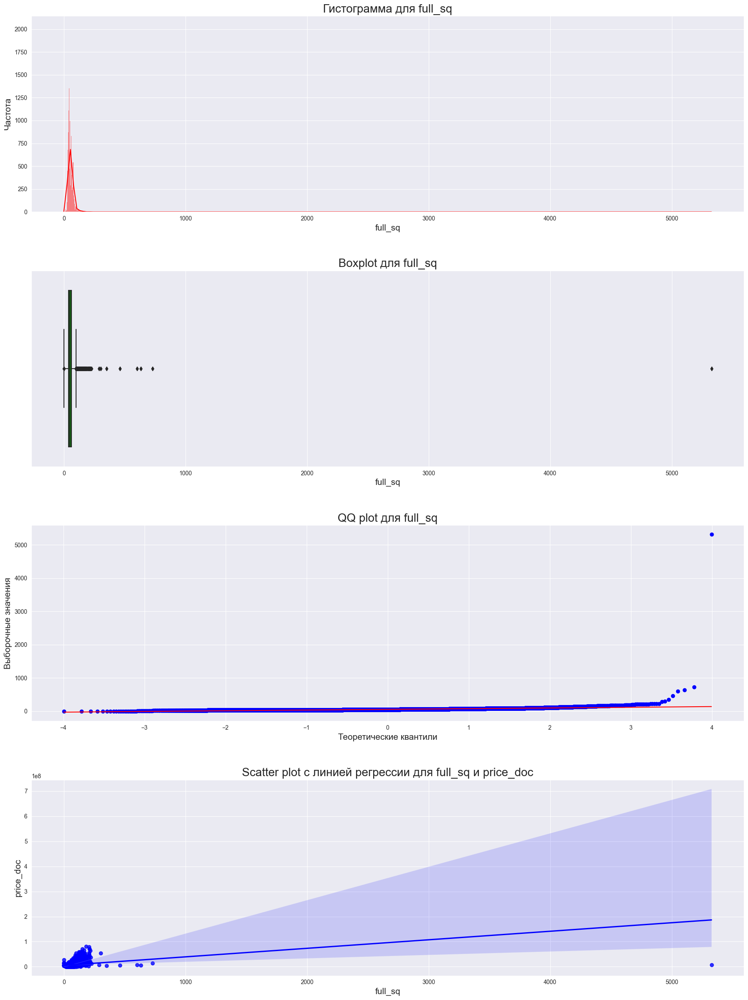


Тест Колмогорова-Смирнова:
Статистика=0.9990, p=0.0000
Отвергаем нулевую гипотезу. Признак full_sq, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean        54.088799
std         42.559522
min          0.000000
25%         38.000000
50%         49.000000
75%         63.000000
max       5326.000000
Name: full_sq, dtype: float64

Корреляция Пирсона: 0.30772883352978575
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.5226207215221317
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.3712287468534667
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [11]:
quantitative_feature_analysis(df_train, 'full_sq', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 5326
3. Медиана равна 49
4. Имеется статистически значимая корреляция
5. Подозрительное значение, что у квартиры может быть 0 квадратных метров
6. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы
2. Заменить значения с 0 на NaN, статистическим значением или удалить записи

## 2) floor

floor: Этаж, на котором расположена квартира. Тип данных: float64

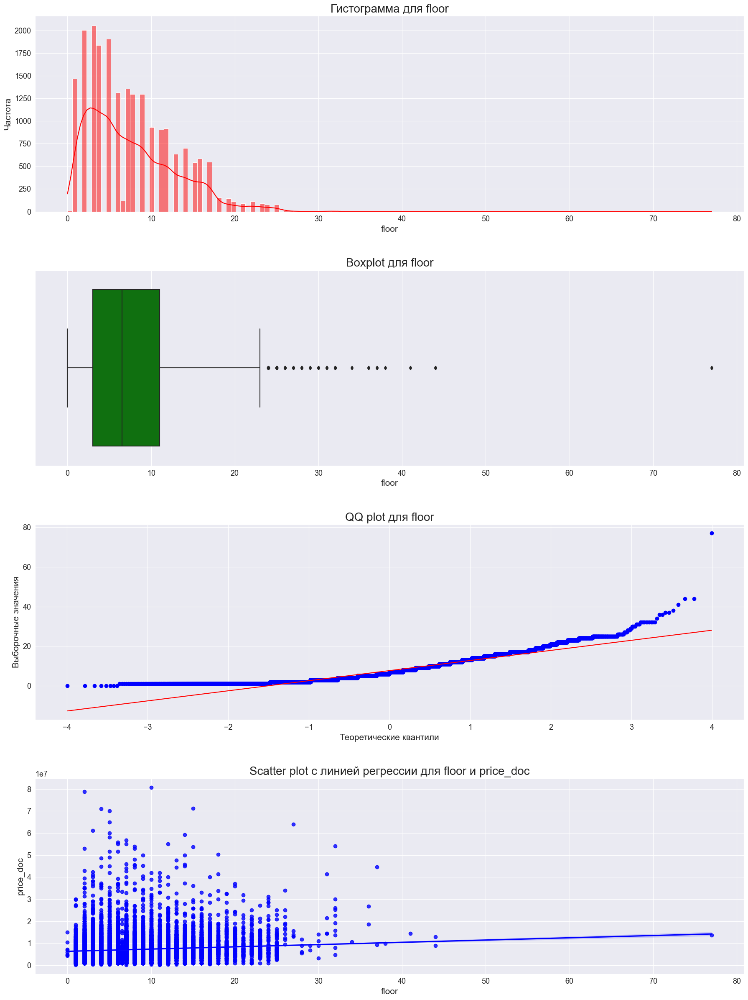


Тест Колмогорова-Смирнова:
Статистика=0.9081, p=0.0000
Отвергаем нулевую гипотезу. Признак floor, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         7.660509
std          5.319822
min          0.000000
25%          3.000000
50%          6.500000
75%         11.000000
max         77.000000
Name: floor, dtype: float64

Корреляция Пирсона: 0.11575098709476639
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.10660052545471282
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.07373839210197561
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [12]:
quantitative_feature_analysis(df_train, 'floor', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 77
3. Медиана равна 6.5
4. Имеется статистически значимая корреляция
5. Подозрительное значение, что у квартиры может быть 0 этаж, может быть цоколь
6. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы
2. Заменить значения с 0 на NaN, статистическим значением или удалить записи

## 3) build_year

build_year: Год постройки здания. Тип данных: float64

In [49]:
df_train['build_year'].sort_values(ascending=False)

17850    20052009.0
16531        2018.0
9600         2017.0
10783        2017.0
6540         2017.0
            ...    
16975           0.0
14735           0.0
14734           0.0
11376           0.0
10664           0.0
Name: build_year, Length: 21329, dtype: float64

In [50]:
df_train['build_year'].sort_values()

10664           0.0
13047           0.0
8361            0.0
8372            0.0
1937            0.0
            ...    
8982         2017.0
13440        2017.0
21116        2017.0
16531        2018.0
17850    20052009.0
Name: build_year, Length: 21329, dtype: float64

Удалим запись 17850, ибо там значение 20052009.0, которое мешает адекватно проанализировать данные

In [55]:
df_train_copy = df_train.copy()
df_train_copy = df_train_copy.drop(17850)
df_train_copy = df_train_copy[df_train_copy['build_year'] >= 1147]

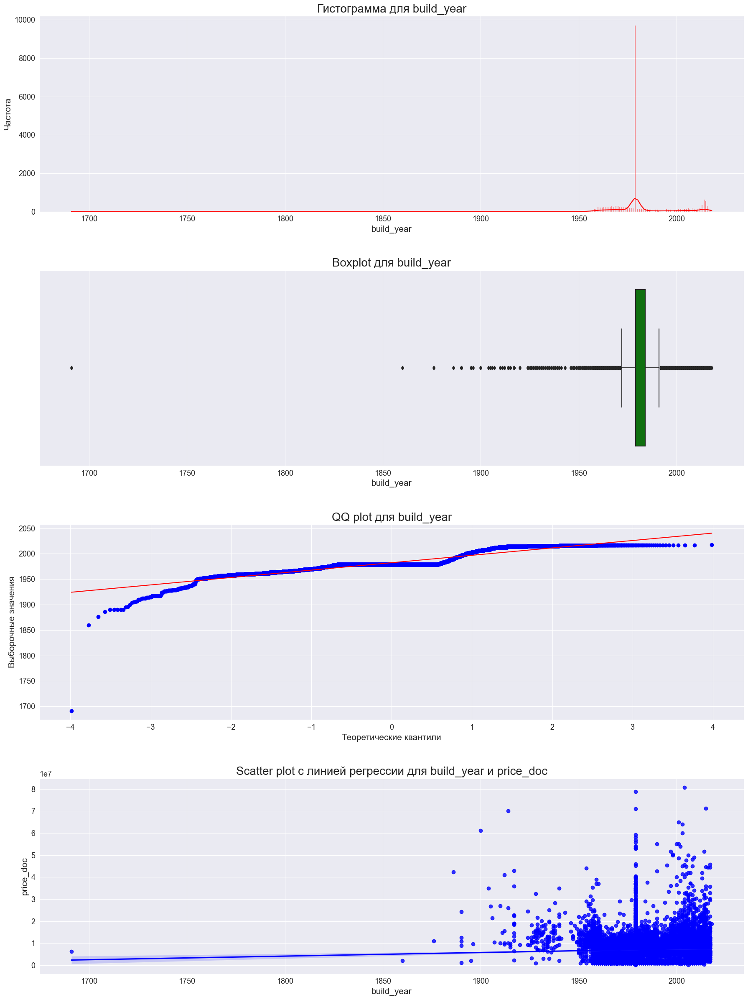


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак build_year, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    20706.000000
mean      1982.420603
std         15.820015
min       1691.000000
25%       1979.000000
50%       1979.000000
75%       1984.000000
max       2018.000000
Name: build_year, dtype: float64

Корреляция Пирсона: 0.05443660295269337
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.04099923530990448
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.02821453431307228
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [56]:
quantitative_feature_analysis(df_train_copy, 'build_year', 'price_doc')

1. Не нормальное распределение
2. Адекватные начения от 1691 до 2018
3. Медиана равна 1979
4. Имеется статистически значимая корреляция
5. Есть данные, где год постройки меньше 1147(года основания Москвы), что явно ошибка (квартира в Москве от пещерных людей по наследству видимо передавалась)

## 4) num_room

num_room: Количество комнат в квартире. Тип данных: float64

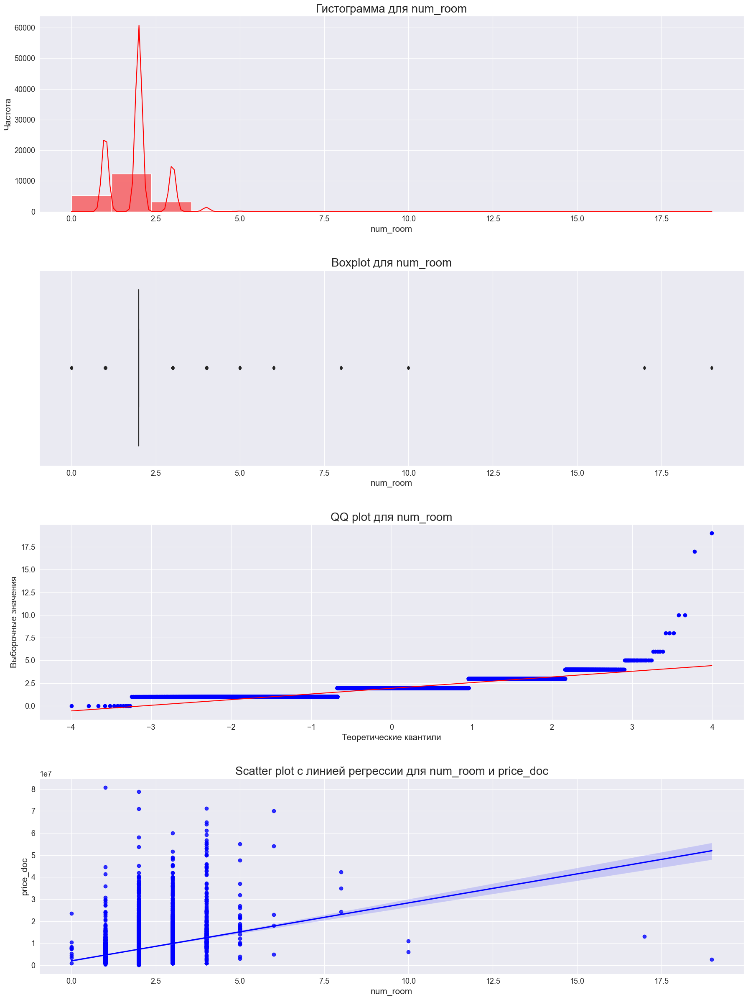


Тест Колмогорова-Смирнова:
Статистика=0.8408, p=0.0000
Отвергаем нулевую гипотезу. Признак num_room, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.938300
std          0.710045
min          0.000000
25%          2.000000
50%          2.000000
75%          2.000000
max         19.000000
Name: num_room, dtype: float64

Корреляция Пирсона: 0.3969014241731551
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.41374712154401355
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.3294727468933077
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [15]:
quantitative_feature_analysis(df_train, 'num_room', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 19
3. Медиана равна 2
4. Имеется статистически значимая корреляция
5. Подозрительное значение, что у квартиры может быть 0 комнат (видимо в чердаке живут люди, как ГП)
6. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы
2. Заменить значения с 0 на NaN, статистическим значением или удалить записи

## 5) kitch_sq

kitch_sq: Площадь кухни (в квадратных метрах). Тип данных: float64

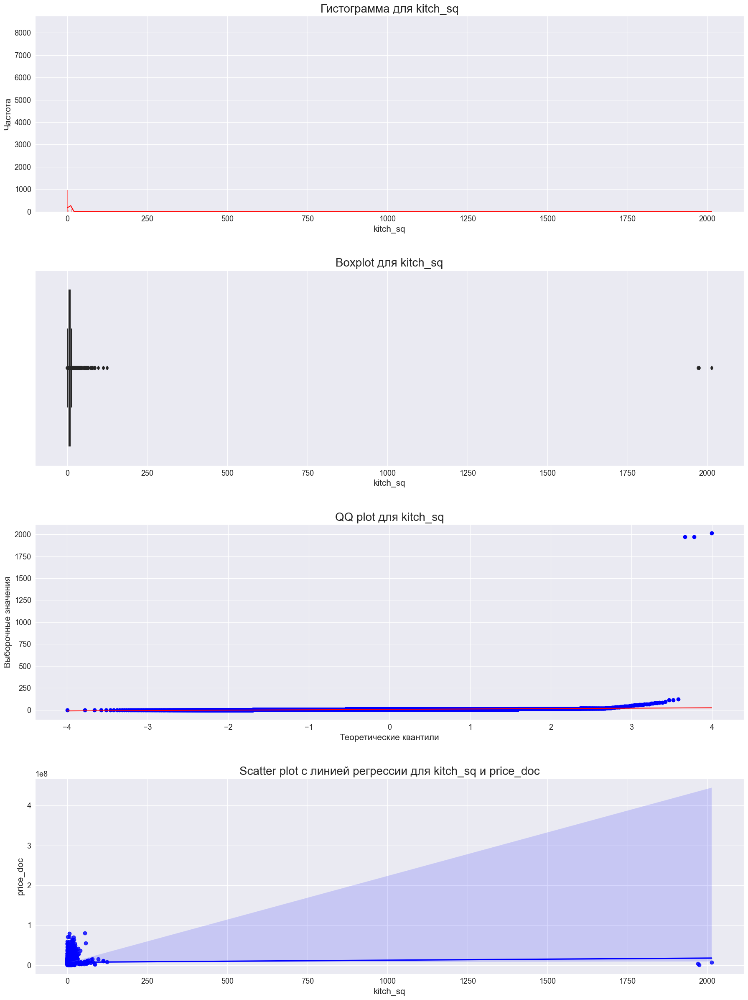


Тест Колмогорова-Смирнова:
Статистика=0.7964, p=0.0000
Отвергаем нулевую гипотезу. Признак kitch_sq, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         6.292184
std         23.847677
min          0.000000
25%          5.000000
50%          6.000000
75%          8.000000
max       2013.000000
Name: kitch_sq, dtype: float64

Корреляция Пирсона: 0.026375778967300718
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.209187537299138
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.15383680758538756
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [16]:
quantitative_feature_analysis(df_train, 'kitch_sq', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 2013
3. Медиана равна 6
4. Имеется статистически значимая корреляция
5. Подозрительное значение, что у квартиры может быть 0 квадратных метров у кухни (Может быть студия, поэтому и 0)
6. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы
2. Заменить значения у записей, которые имеют отличное кол-во комнат от 1, с 0 на NaN, статистическим значением, удалить записи
3. Для всех записей заменить значения с 0 на NaN, статистическим значением, удалить записи

In [8]:
print(f"Общее количество записей с kitch_sq равным 0: {df_train[df_train['kitch_sq'] == 0].shape[0]}")
print(f"Количество записей с num_room равным 1 и kitch_sq равным 0: {df_train[(df_train['num_room'] == 1) & (df_train['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 2 и kitch_sq равным 0: {df_train[(df_train['num_room'] == 2) & (df_train['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 3 и kitch_sq равным 0: {df_train[(df_train['num_room'] == 3) & (df_train['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 4 и kitch_sq равным 0: {df_train[(df_train['num_room'] == 4) & (df_train['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 5 и kitch_sq равным 0: {df_train[(df_train['num_room'] == 5) & (df_train['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 6 и kitch_sq равным 0: {df_train[(df_train['num_room'] == 6) & (df_train['kitch_sq'] == 0)].shape[0]}")

Общее количество записей с kitch_sq равным 0: 959
Количество записей с num_room равным 1 и kitch_sq равным 0: 402
Количество записей с num_room равным 2 и kitch_sq равным 0: 361
Количество записей с num_room равным 3 и kitch_sq равным 0: 174
Количество записей с num_room равным 4 и kitch_sq равным 0: 10
Количество записей с num_room равным 5 и kitch_sq равным 0: 1
Количество записей с num_room равным 6 и kitch_sq равным 0: 2


## 6) state

state: Состояние квартиры. Тип данных: float64

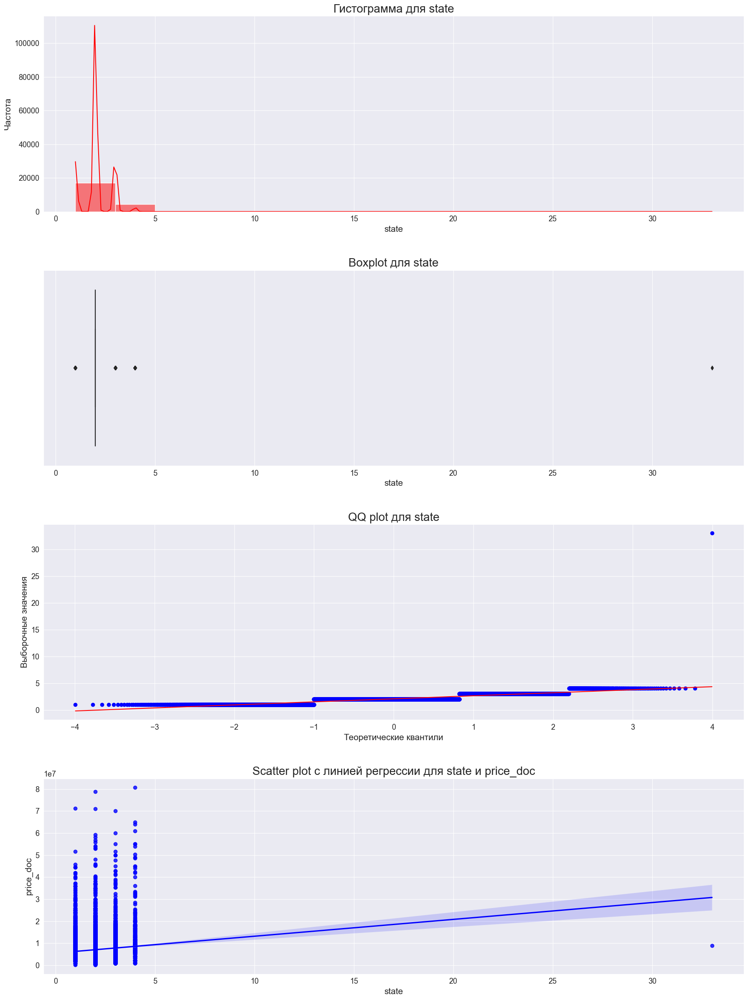


Тест Колмогорова-Смирнова:
Статистика=0.8413, p=0.0000
Отвергаем нулевую гипотезу. Признак state, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.061606
std          0.667929
min          1.000000
25%          2.000000
50%          2.000000
75%          2.000000
max         33.000000
Name: state, dtype: float64

Корреляция Пирсона: 0.10856070408880264
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.1365712279389407
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.10777692221401866
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [17]:
quantitative_feature_analysis(df_train, 'state', 'price_doc')

1. Не нормальное распределение
2. Значения от 1 до 33
3. Медиана равна 2
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы

## 7) product_type

product_type: Тип недвижимости. Тип данных: bool

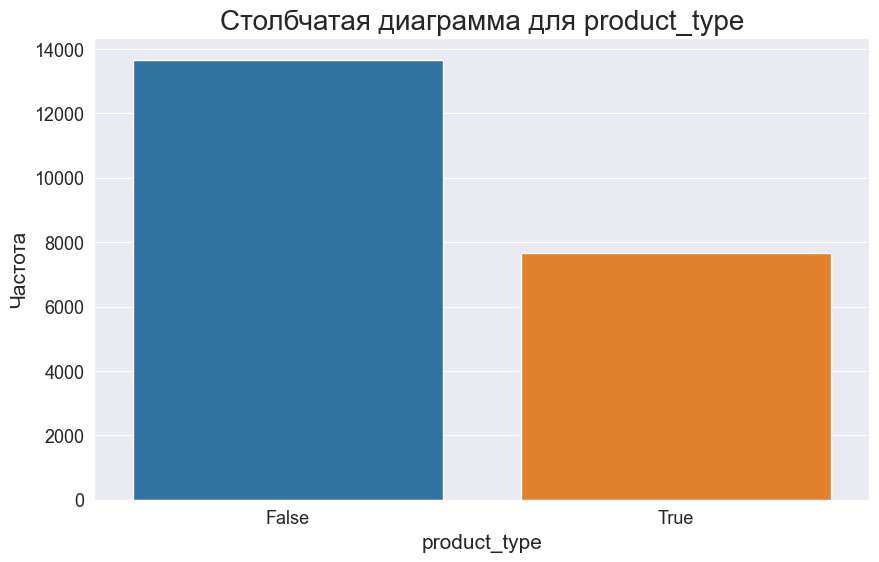

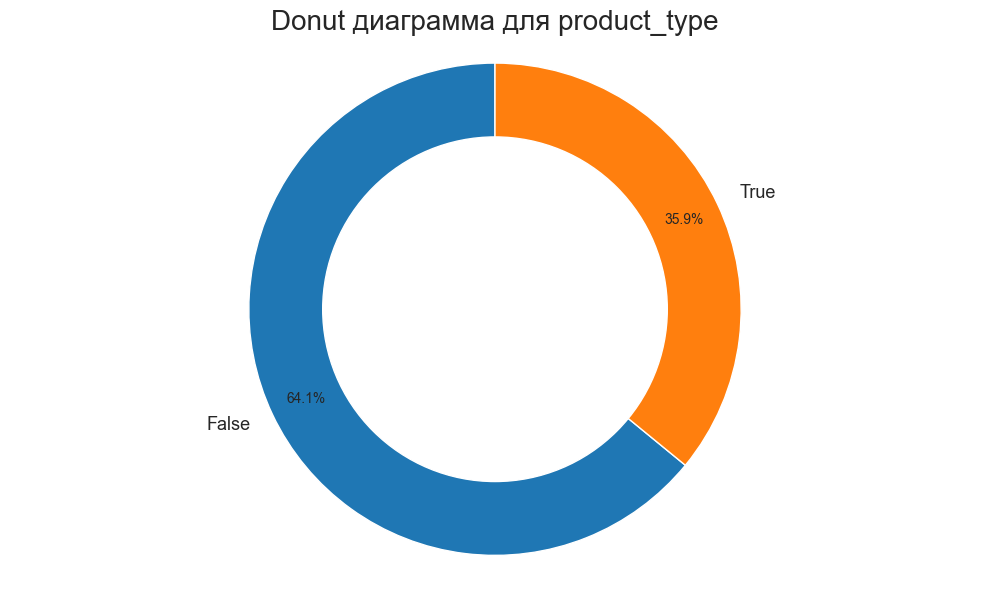


Описательная статистика:
count     21329
unique        2
top       False
freq      13666
Name: product_type, dtype: object

Корреляция Пирсона: -0.10527169032008514
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.18625981934872166
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.152364993286843
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [9]:
binary_feature_analysis(df_train, 'product_type', 'price_doc')

1. Не равномерное распределение
2. Больше всего в количестве False
3. Имеется статистически значимая корреляция

Варианты для обработки признака:
1. Синтетически увеличить количество записей с True

## 8) raion_popul

raion_popul: Население района. Тип данных: float64

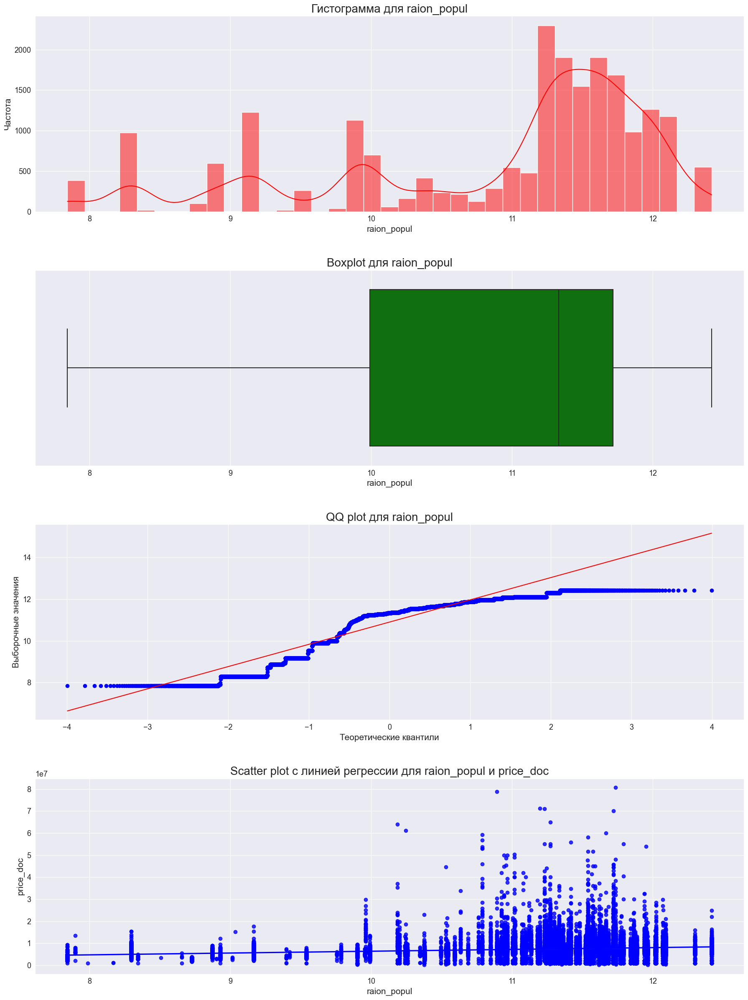


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак raion_popul, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean        10.899731
std          1.151518
min          7.842279
25%          9.990536
50%         11.332626
75%         11.718817
max         12.419041
Name: raion_popul, dtype: float64

Корреляция Пирсона: 0.20082750816565334
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.2538765427826906
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.16911881966997877
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [11]:
quantitative_feature_analysis(df_train, 'raion_popul', 'price_doc')

1. Не нормальное распределение
2. Значения от 7.842279 до 12.419041
3. Медиана равна 11.332626
4. Имеется статистически значимая корреляция

## 9) indust_part

indust_part: Промышленная часть района. Тип данных: float64

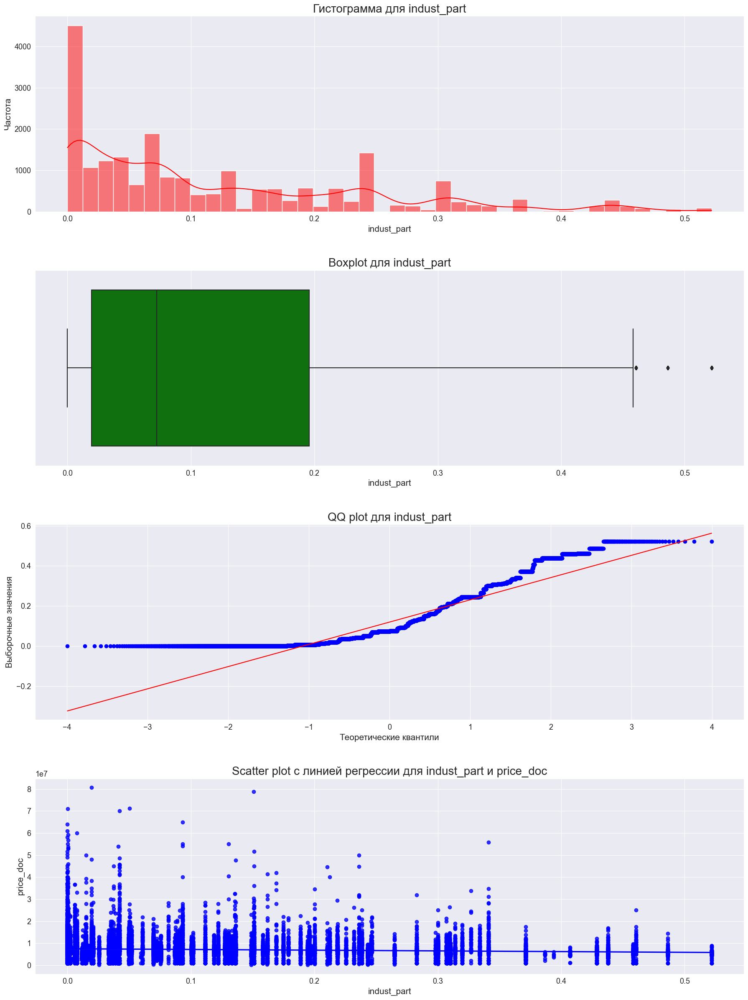


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак indust_part, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         0.119305
std          0.119186
min          0.000000
25%          0.019509
50%          0.072158
75%          0.195781
max          0.521867
Name: indust_part, dtype: float64

Корреляция Пирсона: -0.08213373452865574
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.062082566142966984
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.04184153065872507
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [12]:
quantitative_feature_analysis(df_train, 'indust_part', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 0.521867
3. Медиана равна 0.072158
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 10) sport_objects_raion

sport_objects_raion: Количество спортивных объектов в районе. Тип данных: int64

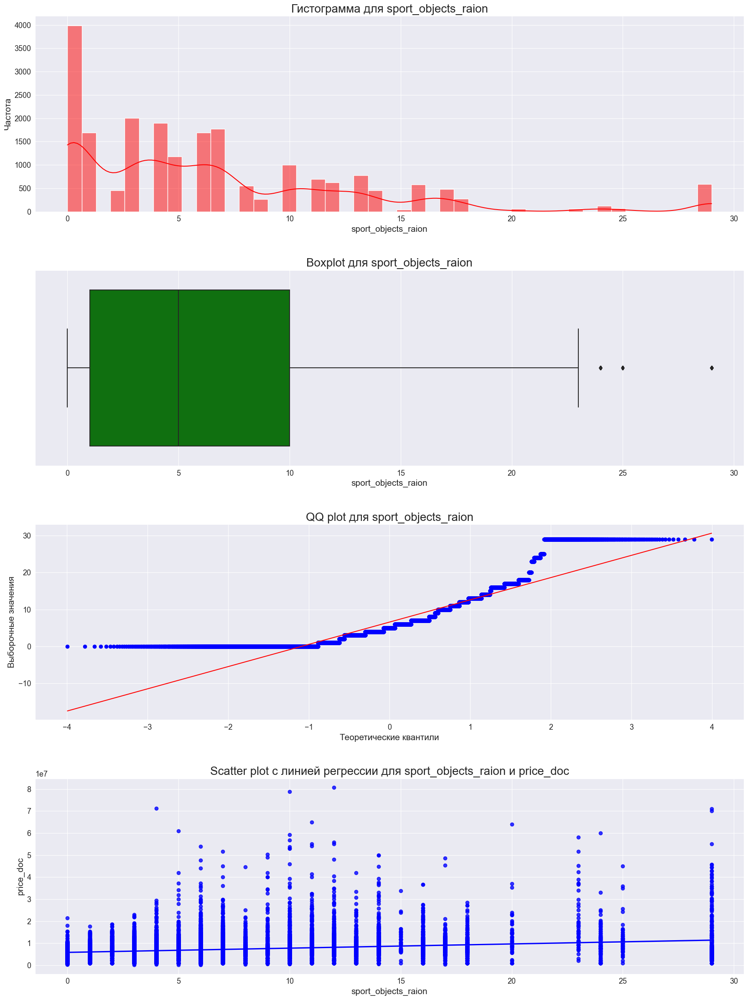


Тест Колмогорова-Смирнова:
Статистика=0.7111, p=0.0000
Отвергаем нулевую гипотезу. Признак sport_objects_raion, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         6.581884
std          6.514278
min          0.000000
25%          1.000000
50%          5.000000
75%         10.000000
max         29.000000
Name: sport_objects_raion, dtype: float64

Корреляция Пирсона: 0.2654408965534844
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.3218354669722832
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.227369868142263
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [15]:
quantitative_feature_analysis(df_train, 'sport_objects_raion', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 29
3. Медиана равна 5
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 11) shopping_centers_raion

shopping_centers_raion: Количество торговых центров в районе. Тип данных: int64

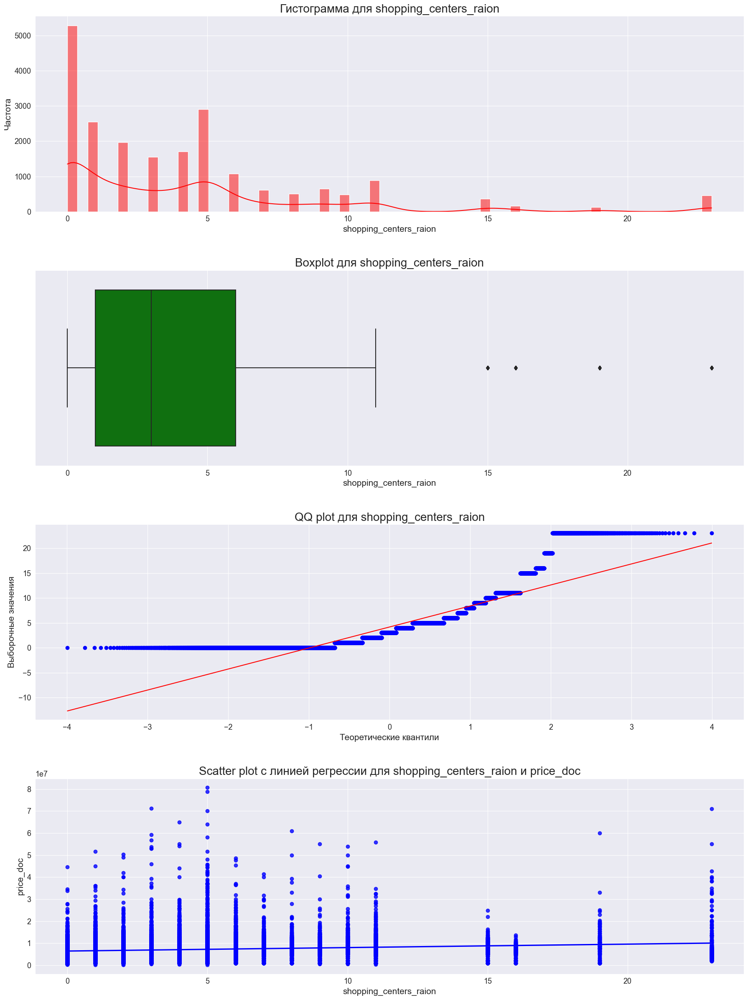


Тест Колмогорова-Смирнова:
Статистика=0.6093, p=0.0000
Отвергаем нулевую гипотезу. Признак shopping_centers_raion, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         4.171832
std          4.730773
min          0.000000
25%          1.000000
50%          3.000000
75%          6.000000
max         23.000000
Name: shopping_centers_raion, dtype: float64

Корреляция Пирсона: 0.15809534585306062
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.28580543576978895
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.20259797273273653
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [16]:
quantitative_feature_analysis(df_train, 'shopping_centers_raion', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 23
3. Медиана равна 3
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 12) radiation_raion

radiation_raion: Наличие радиационных объектов в районе. Тип данных: bool

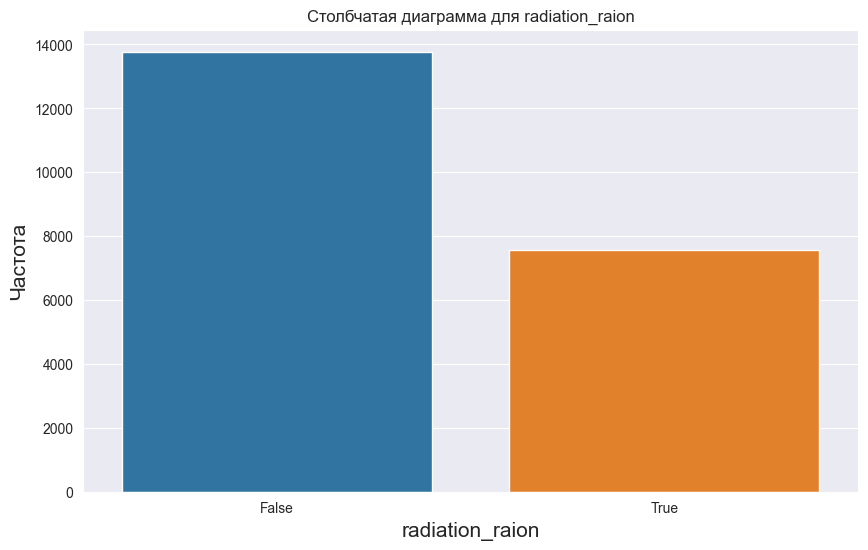

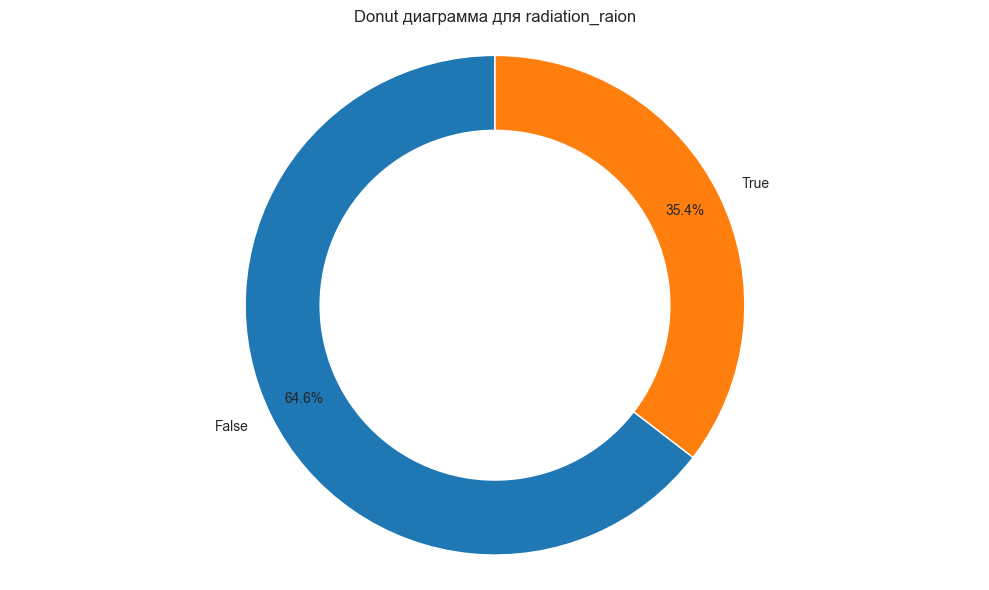


Описательная статистика:
count     21329
unique        2
top       False
freq      13773
Name: radiation_raion, dtype: object

Корреляция Пирсона: 0.12623462396495255
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.12137208308309456
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.09928527091257901
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [11]:
binary_feature_analysis(df_train, 'radiation_raion', 'price_doc')

1. Не равномерное распределение
2. Больше всего в количестве False
3. Имеется статистически значимая корреляция

Варианты для обработки признака:
1. Синтетически увеличить количество записей с True

## 13) build_count_block

build_count_block: Количество зданий блочного типа. Тип данных: float64

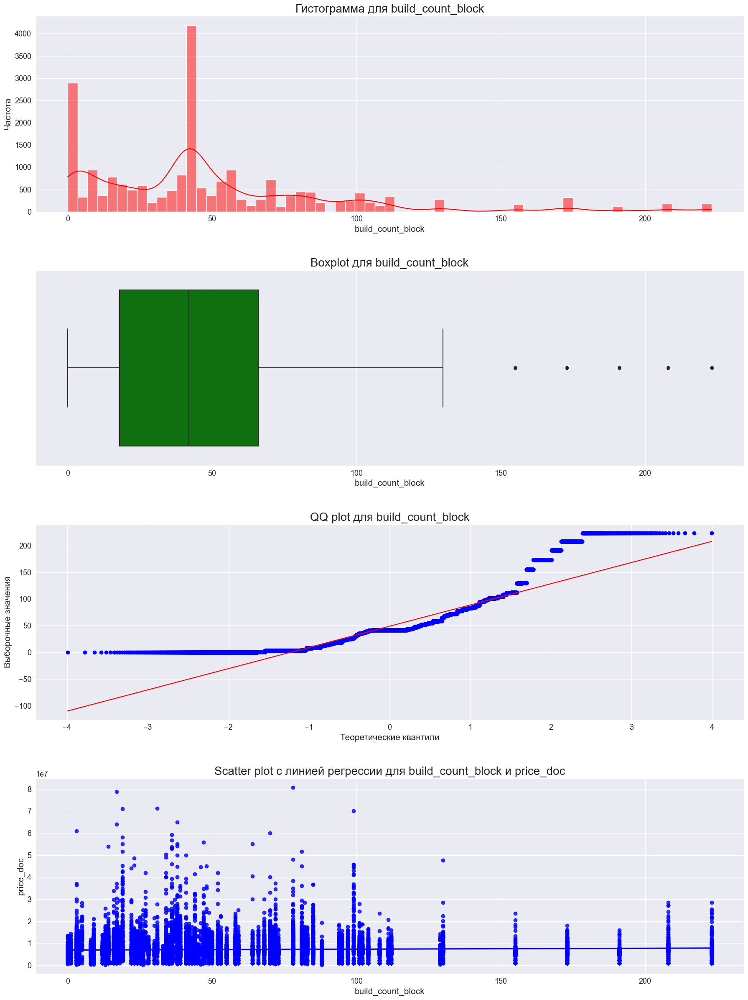


Тест Колмогорова-Смирнова:
Статистика=0.9376, p=0.0000
Отвергаем нулевую гипотезу. Признак build_count_block, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean        49.037976
std         43.030509
min          0.000000
25%         18.000000
50%         42.000000
75%         66.000000
max        223.000000
Name: build_count_block, dtype: float64

Корреляция Пирсона: 0.036603976744188034
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.07086504378794323
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.04937802570620876
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [13]:
quantitative_feature_analysis(df_train, 'build_count_block', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 223
3. Медиана равна 42
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 14) build_count_brick

build_count_brick: Количество кирпичных зданий. Тип данных: float64

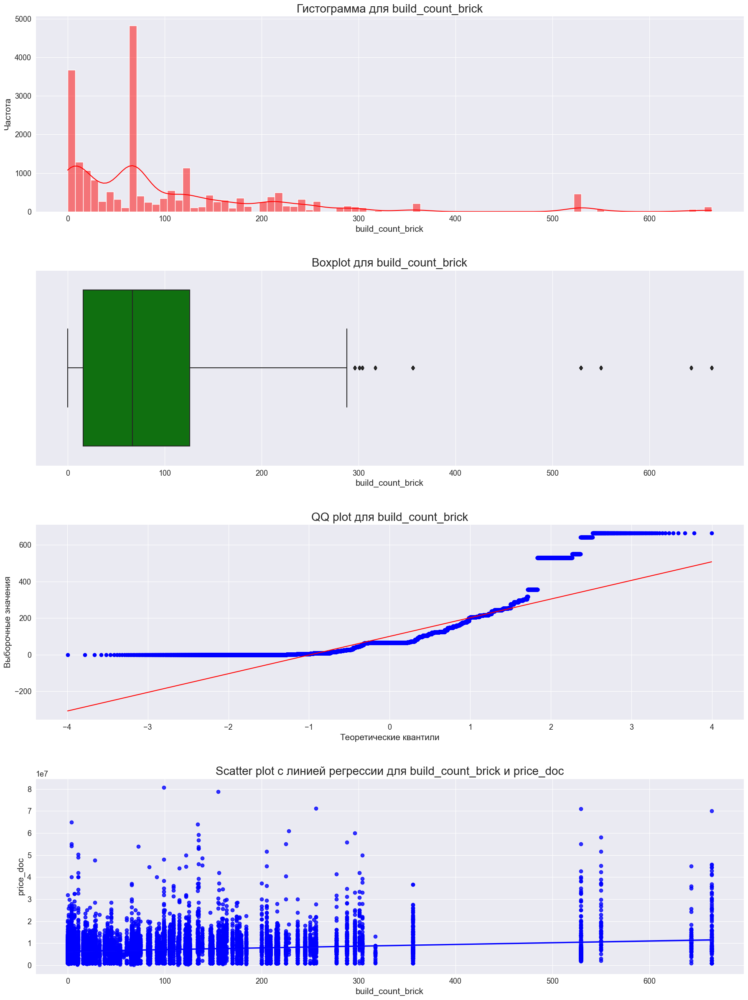


Тест Колмогорова-Смирнова:
Статистика=0.8795, p=0.0000
Отвергаем нулевую гипотезу. Признак build_count_brick, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean       100.645975
std        117.744957
min          0.000000
25%         16.000000
50%         67.000000
75%        126.000000
max        664.000000
Name: build_count_brick, dtype: float64

Корреляция Пирсона: 0.19588295806791298
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.14760206156005712
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.10053095568636794
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [15]:
quantitative_feature_analysis(df_train, 'build_count_brick', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 664
3. Медиана равна 67
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 15) build_count_monolith

build_count_monolith: Количество монолитных зданий. Тип данных: float64

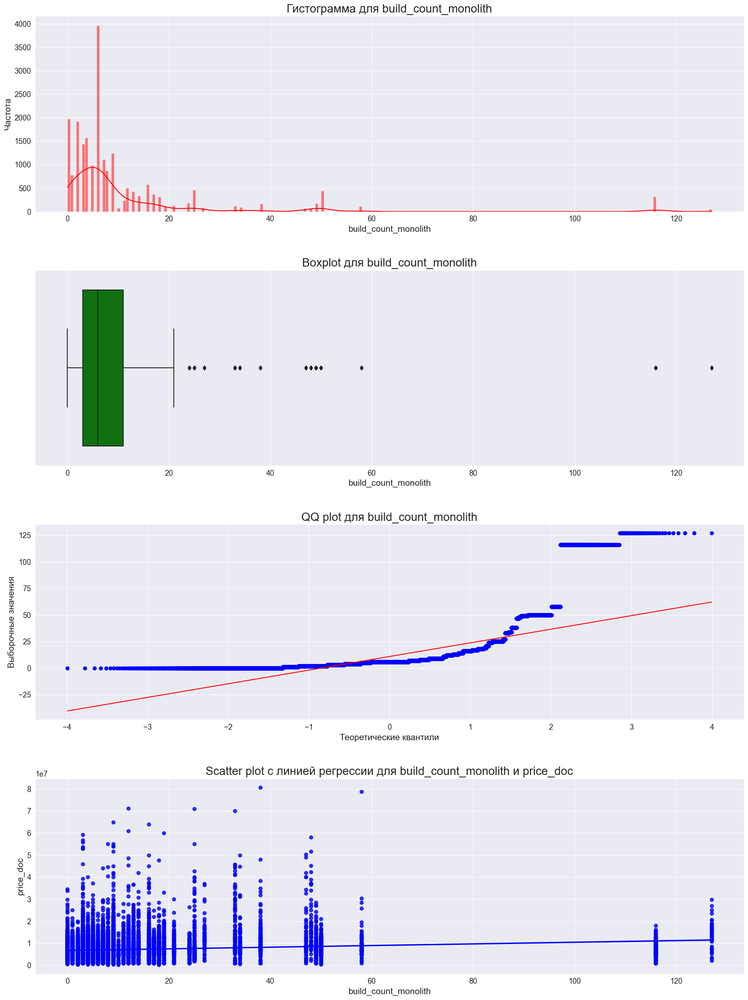


Тест Колмогорова-Смирнова:
Статистика=0.8478, p=0.0000
Отвергаем нулевую гипотезу. Признак build_count_monolith, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean        10.982559
std         17.767365
min          0.000000
25%          3.000000
50%          6.000000
75%         11.000000
max        127.000000
Name: build_count_monolith, dtype: float64

Корреляция Пирсона: 0.1420522497916873
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.16615859971882624
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.11432351945054983
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [17]:
quantitative_feature_analysis(df_train, 'build_count_monolith', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 127
3. Медиана равна 6
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 16) metro_min_avto

metro_min_avto: Время до ближайшей станции метро на автомобиле (в минутах). Тип данных: float64

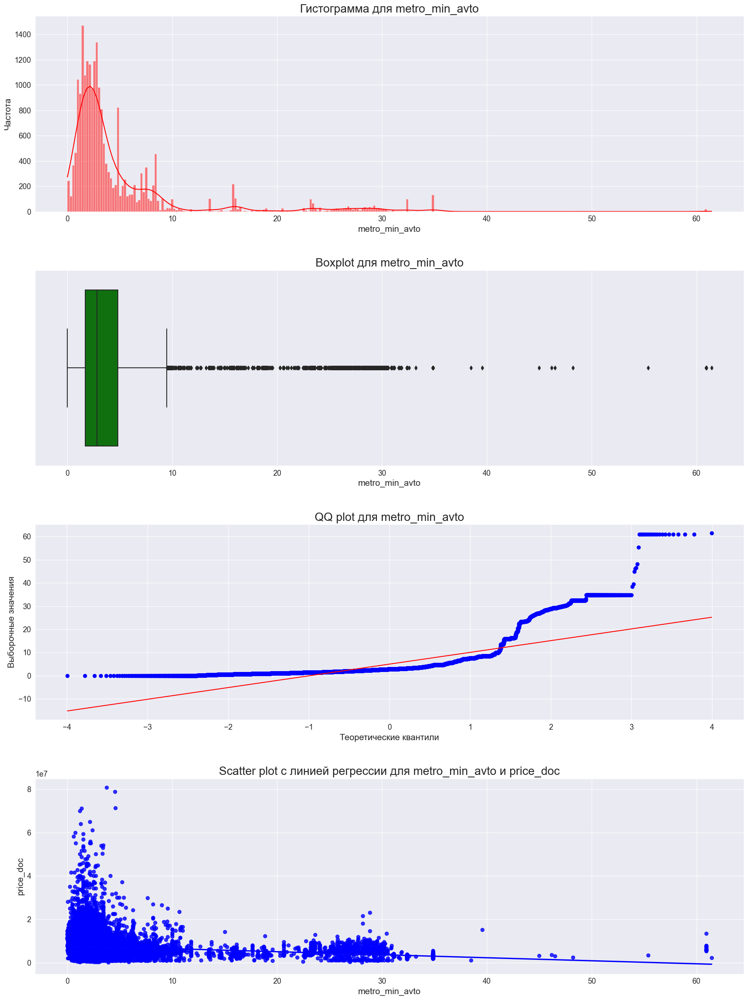


Тест Колмогорова-Смирнова:
Статистика=0.7687, p=0.0000
Отвергаем нулевую гипотезу. Признак metro_min_avto, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         4.991885
std          6.608485
min          0.009021
25%          1.721263
50%          2.804365
75%          4.832712
max         61.438472
Name: metro_min_avto, dtype: float64

Корреляция Пирсона: -0.1951884242577854
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.2940232380381436
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.2029692730643096
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [18]:
quantitative_feature_analysis(df_train, 'metro_min_avto', 'price_doc')

1. Не нормальное распределение
2. Значения от 0.009021 до 61.438472
3. Медиана равна 2.804365
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 17) school_km

school_km: Расстояние до ближайшей школы (в километрах). Тип данных: float64

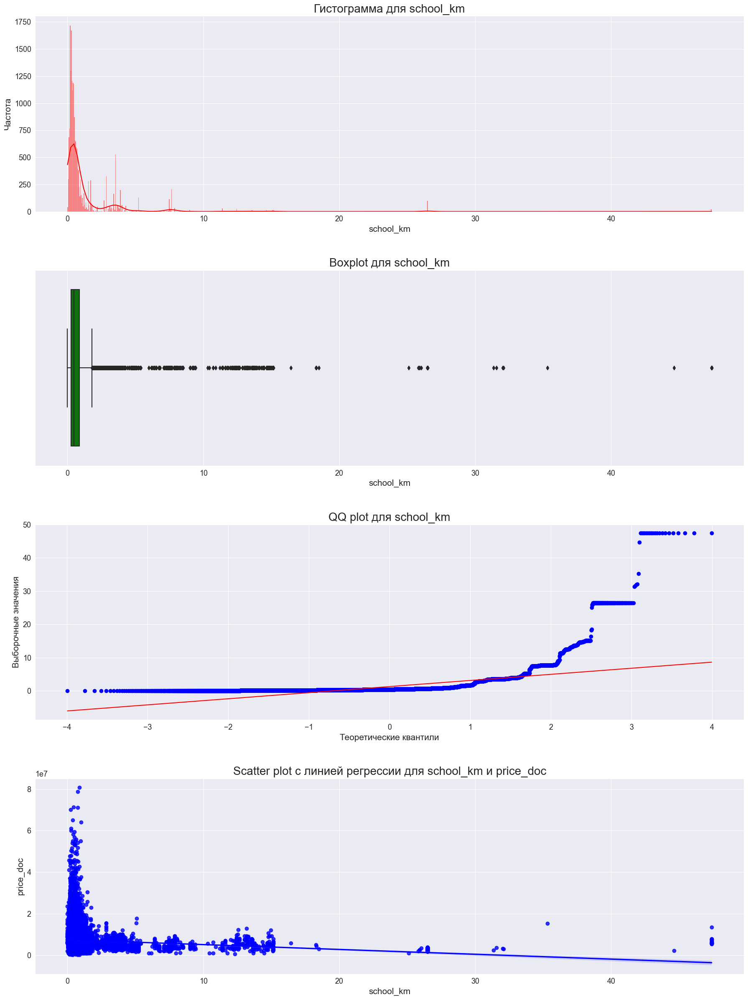


Тест Колмогорова-Смирнова:
Статистика=0.5195, p=0.0000
Отвергаем нулевую гипотезу. Признак school_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.327772
std          3.041464
min          0.000000
25%          0.270784
50%          0.477178
75%          0.887192
max         47.394706
Name: school_km, dtype: float64

Корреляция Пирсона: -0.15050160846622285
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.19206947226870774
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.13058132166293965
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [20]:
quantitative_feature_analysis(df_train, 'school_km', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 47.394706
3. Медиана равна 0.477178
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 18) green_zone_km

green_zone_km: Расстояние до ближайшей зеленой зоны (в километрах). Тип данных: float64

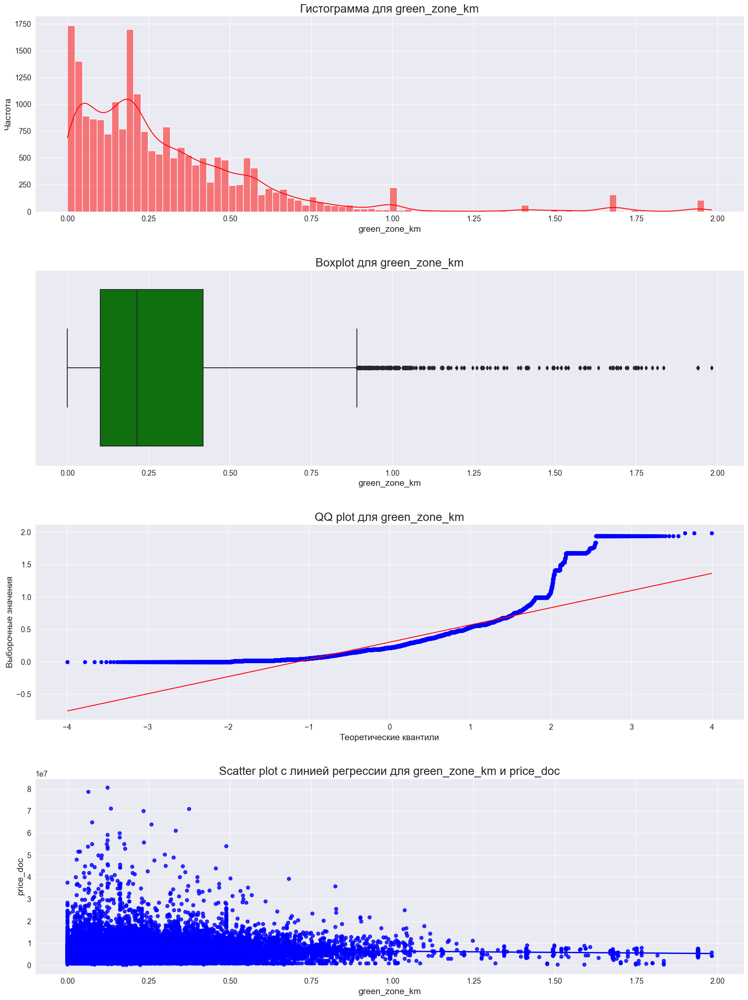


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак green_zone_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         0.302356
std          0.300337
min          0.000000
25%          0.101285
50%          0.214474
75%          0.417202
max          1.982448
Name: green_zone_km, dtype: float64

Корреляция Пирсона: -0.06731135805565941
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.025758744197542496
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.01671084252873846
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [21]:
quantitative_feature_analysis(df_train, 'green_zone_km', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 1.982448
3. Медиана равна 0.214474
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 19) industrial_km

industrial_km: Расстояние до ближайшей промышленной зоны (в километрах). Тип данных: float64

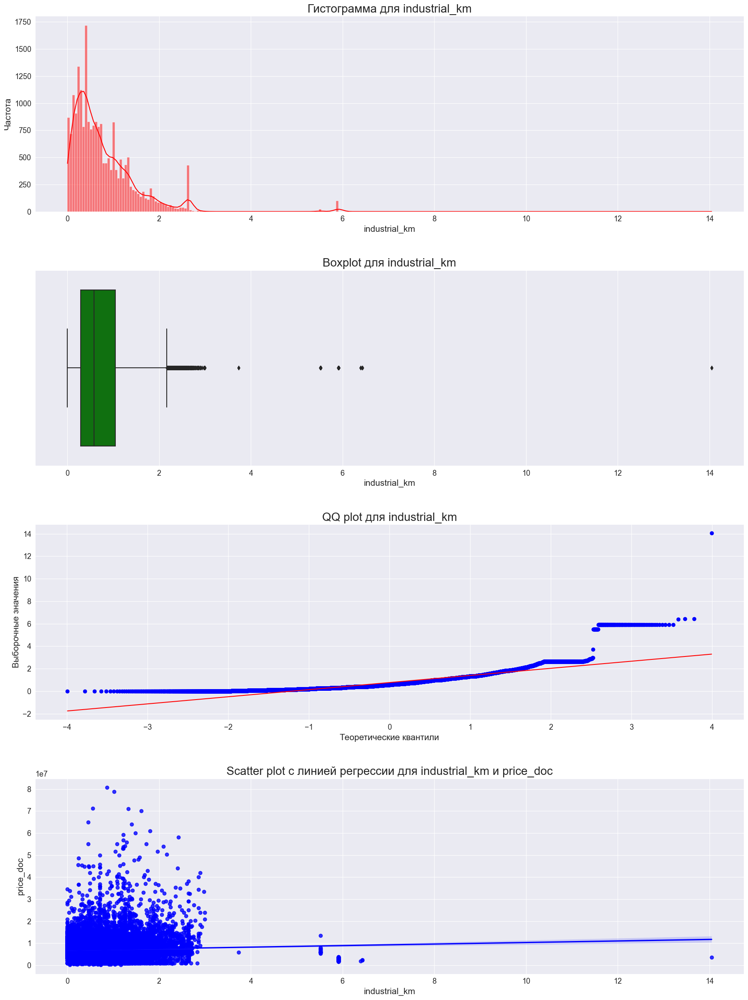


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак industrial_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         0.768502
std          0.718222
min          0.000000
25%          0.288289
50%          0.574383
75%          1.040797
max         14.048162
Name: industrial_km, dtype: float64

Корреляция Пирсона: 0.053238011898377735
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.053758180021838325
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.036997181922695244
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [22]:
quantitative_feature_analysis(df_train, 'industrial_km', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 14.048162
3. Медиана равна 0.574383
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 20) water_treatment_km

water_treatment_km: Расстояние до ближайшего очистного сооружения (в километрах). Тип данных: float64

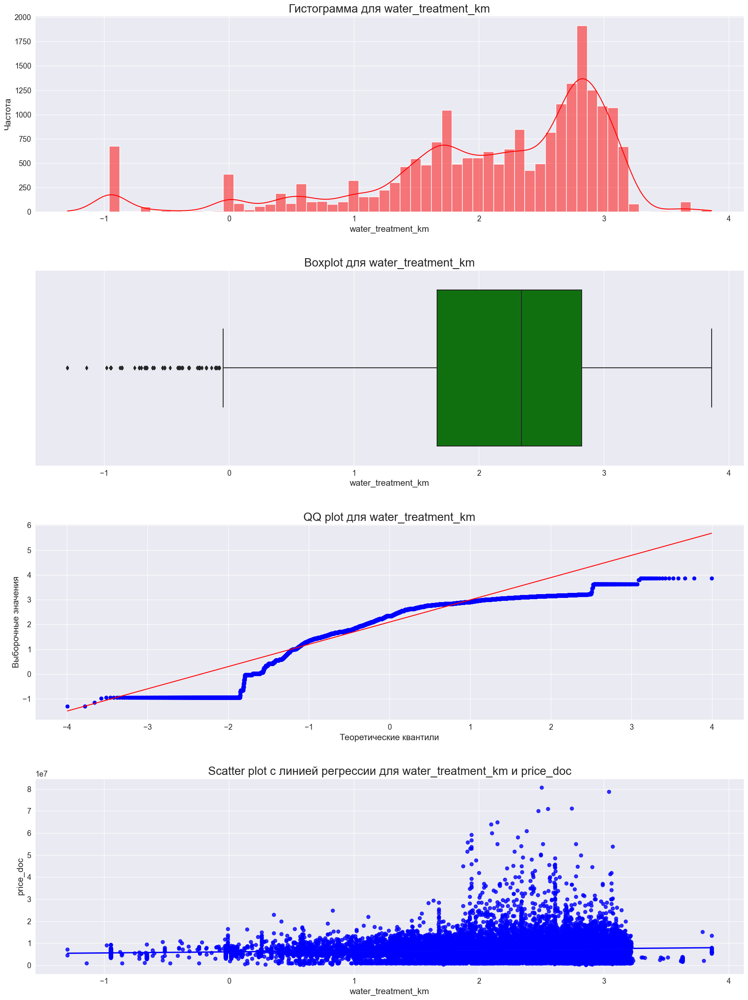


Тест Колмогорова-Смирнова:
Статистика=0.7515, p=0.0000
Отвергаем нулевую гипотезу. Признак water_treatment_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.095649
std          0.961112
min         -1.294120
25%          1.663562
50%          2.339692
75%          2.822017
max          3.862649
Name: water_treatment_km, dtype: float64

Корреляция Пирсона: 0.09978865993336006
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.09683736652192382
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.06377052629261426
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [23]:
quantitative_feature_analysis(df_train, 'water_treatment_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -1.294120 до 3.862649
3. Медиана равна 2.339692
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить все отрицательные значения или взять модуль

## 21) cemetery_km

cemetery_km: Расстояние до ближайшего кладбища (в километрах). Тип данных: float64

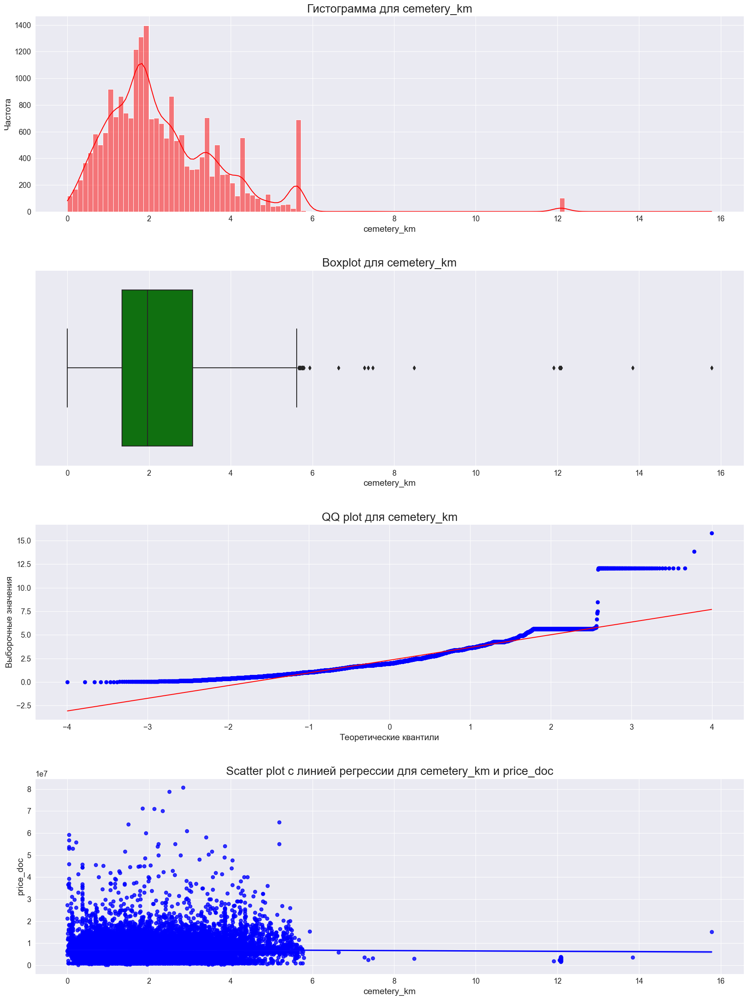


Тест Колмогорова-Смирнова:
Статистика=0.6991, p=0.0000
Отвергаем нулевую гипотезу. Признак cemetery_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.309772
std          1.445623
min          0.000000
25%          1.336053
50%          1.963061
75%          3.067517
max         15.778710
Name: cemetery_km, dtype: float64

Корреляция Пирсона: -0.024194724587450533
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.011755695542730928
Принимаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически НЕ ЗНАЧИМА.

Корреляция Кендалла: -0.008200455144878147
Принимаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически НЕ ЗНАЧИМА.


In [24]:
quantitative_feature_analysis(df_train, 'cemetery_km', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 15.778710
3. Медиана равна 1.963061
4. Не имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Убрать признак полностью

## 22) incineration_km

incineration_km: Расстояние до ближайшего мусоросжигательного завода (в километрах). Тип данных: float64

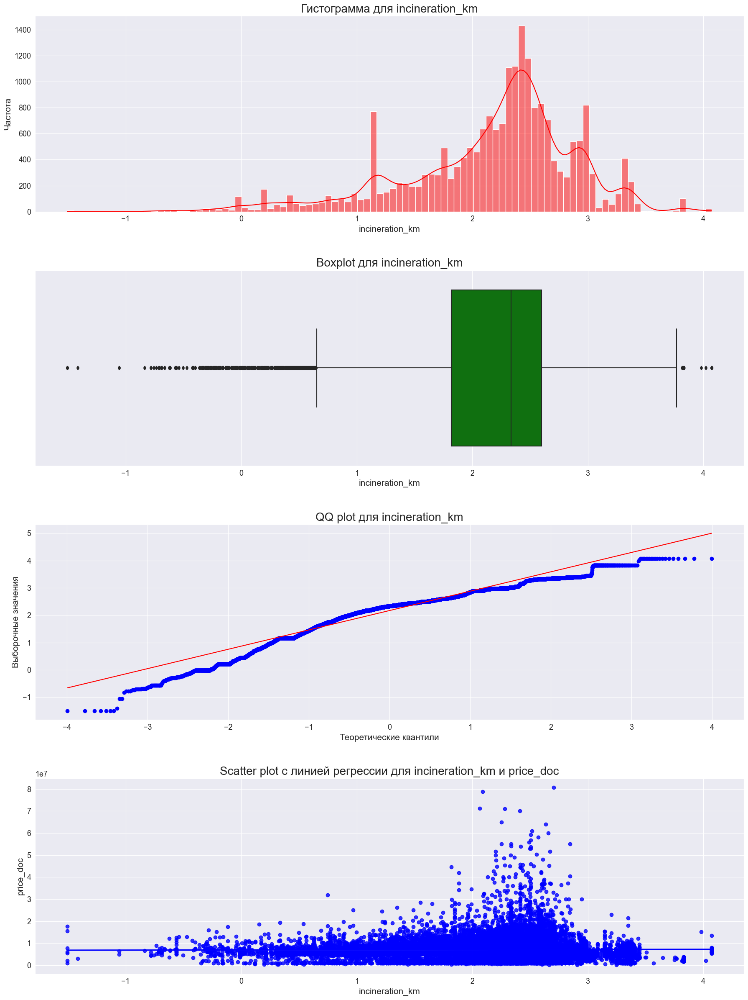


Тест Колмогорова-Смирнова:
Статистика=0.7918, p=0.0000
Отвергаем нулевую гипотезу. Признак incineration_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.168862
std          0.729668
min         -1.504110
25%          1.819042
50%          2.333840
75%          2.598617
max          4.071281
Name: incineration_km, dtype: float64

Корреляция Пирсона: 0.011231608368454417
Принимаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически НЕ ЗНАЧИМА.

Корреляция Спирмена: -0.07137888289784267
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.04565855633292248
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [25]:
quantitative_feature_analysis(df_train, 'incineration_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -1.504110 до 4.071281
3. Медиана равна 2.333840
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 23) ID_railroad_station_avto

ID_railroad_station_avto: Идентификатор ближайшей железнодорожной станции. Тип данных: category

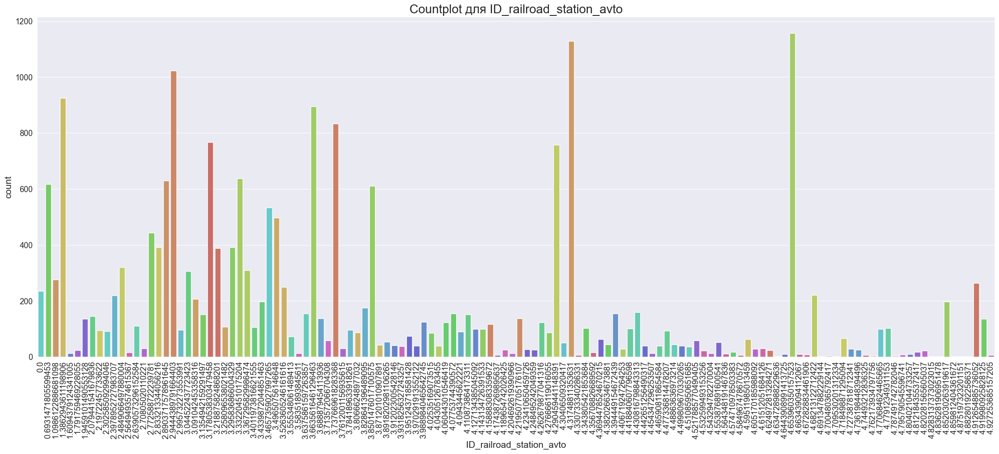

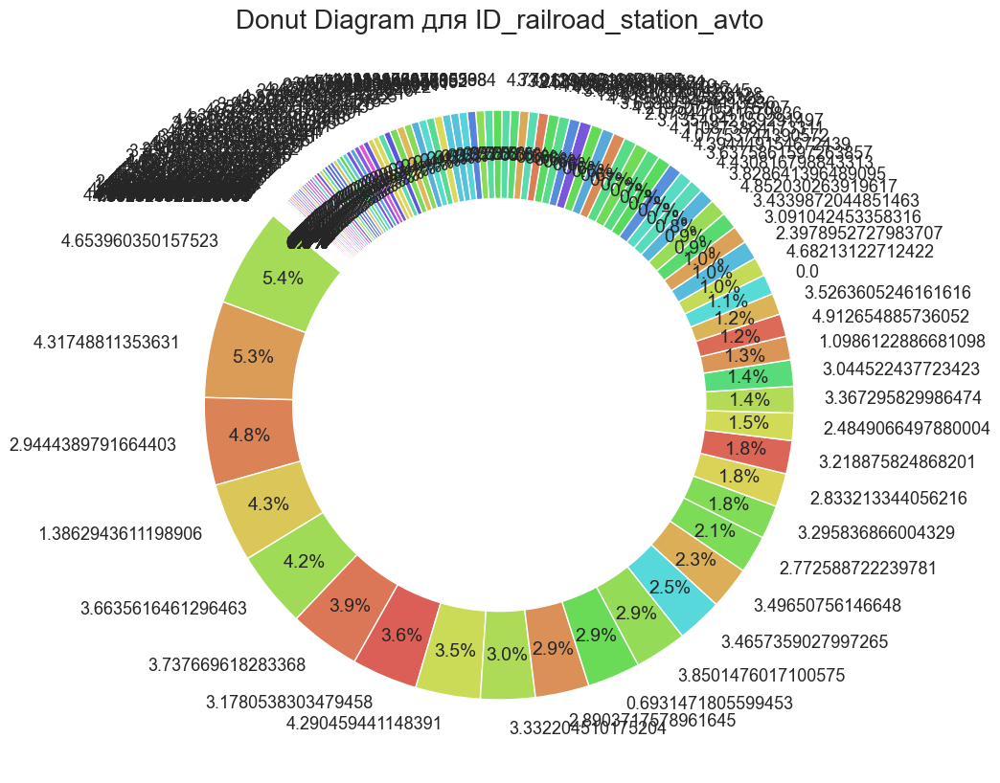

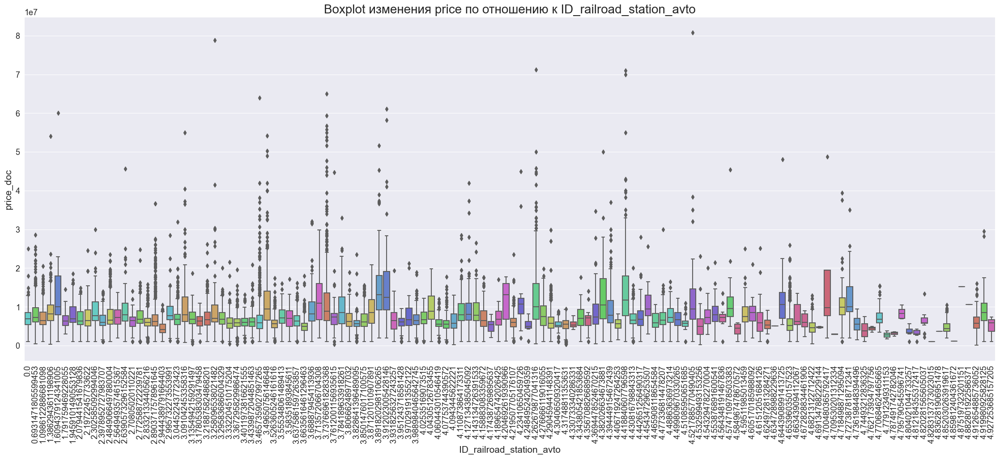

ANOVA F-статистика: 40.0355, p-value: 0.0000
Средние значения ЗНАЧИМО различаются между группами.


In [53]:
category_feature_analysis(df_train, 'ID_railroad_station_avto', 'price_doc')

1. Есть зависимость c price_doc

## 24) mkad_km

mkad_km: Расстояние до МКАД (Московская кольцевая автодорога) в километрах. Тип данных: float64

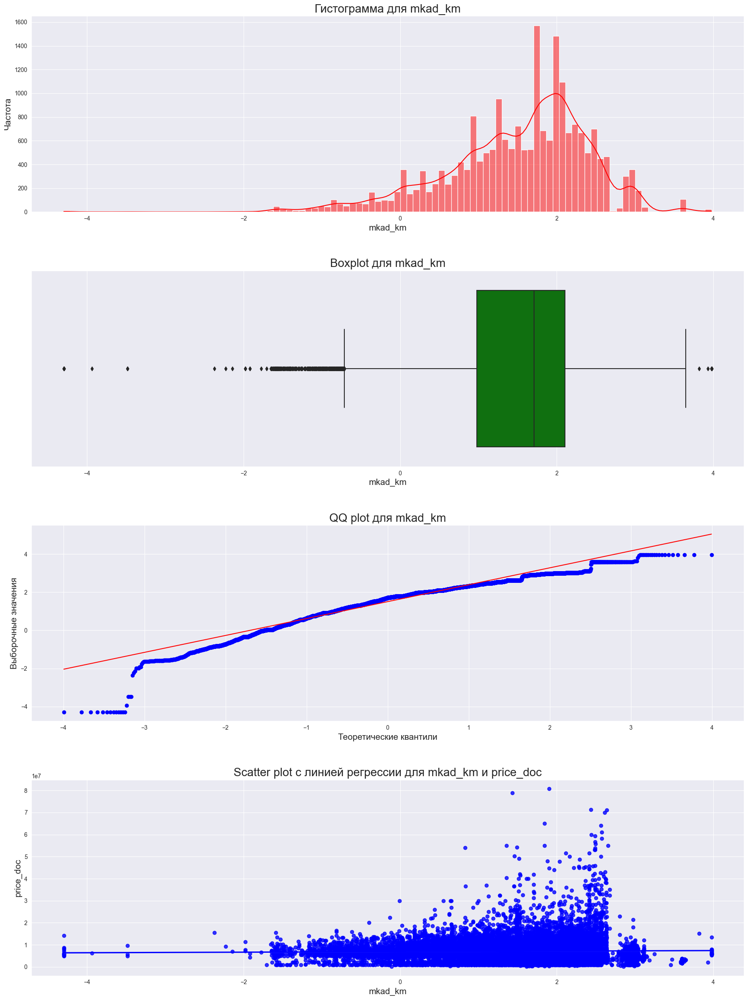


Тест Колмогорова-Смирнова:
Статистика=0.6047, p=0.0000
Отвергаем нулевую гипотезу. Признак mkad_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.506960
std          0.906977
min         -4.295762
25%          0.976851
50%          1.710063
75%          2.102273
max          3.975520
Name: mkad_km, dtype: float64

Корреляция Пирсона: 0.02345522573522007
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.05538975176248742
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.037516981929163355
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [7]:
quantitative_feature_analysis(df_train, 'mkad_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -4.295762 до 3.975520
3. Медиана равна 1.710063
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 25) ttk_km

ttk_km: Расстояние до ТТК (Третье транспортное кольцо) в километрах. Тип данных: float64

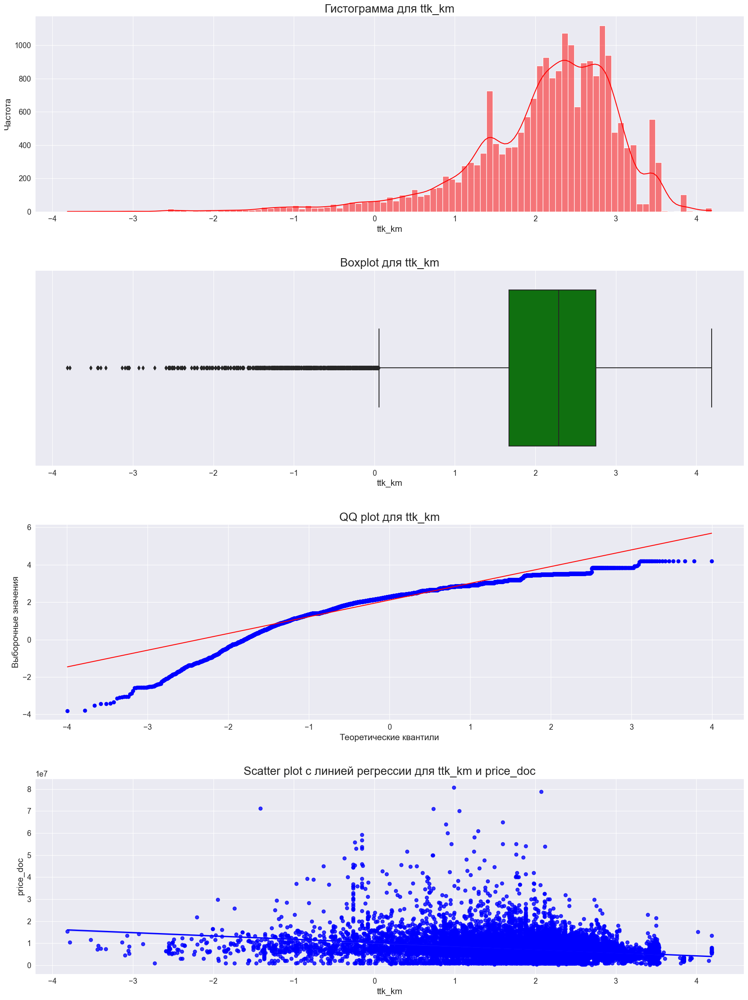


Тест Колмогорова-Смирнова:
Статистика=0.7529, p=0.0000
Отвергаем нулевую гипотезу. Признак ttk_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.111913
std          0.936051
min         -3.813639
25%          1.672790
50%          2.287870
75%          2.752096
max          4.190158
Name: ttk_km, dtype: float64

Корреляция Пирсона: -0.2998417011428871
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.3351552850935125
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.23332691733373143
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [9]:
quantitative_feature_analysis(df_train, 'ttk_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -3.813639 до 4.190158
3. Медиана равна 2.287870
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 26) oil_chemistry_km

oil_chemistry_km: Расстояние до ближайшего нефтехимического предприятия (в километрах). Тип данных: float64

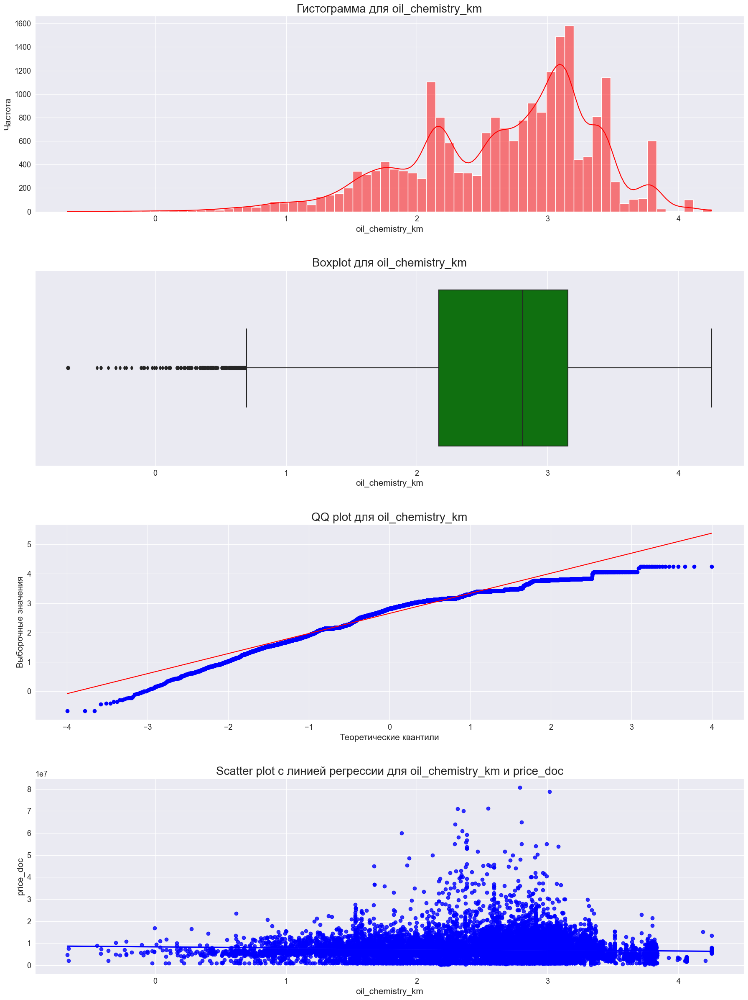


Тест Колмогорова-Смирнова:
Статистика=0.8721, p=0.0000
Отвергаем нулевую гипотезу. Признак oil_chemistry_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.650759
std          0.697254
min         -0.671953
25%          2.169075
50%          2.811528
75%          3.153783
max          4.254384
Name: oil_chemistry_km, dtype: float64

Корреляция Пирсона: -0.07008866779911838
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.14663068648977223
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.09745601055129624
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [11]:
quantitative_feature_analysis(df_train, 'oil_chemistry_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -0.671953 до 4.254384
3. Медиана равна 2.811528
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 27) nuclear_reactor_km

nuclear_reactor_km: Расстояние до ближайшего ядерного реактора (в километрах). Тип данных: float64

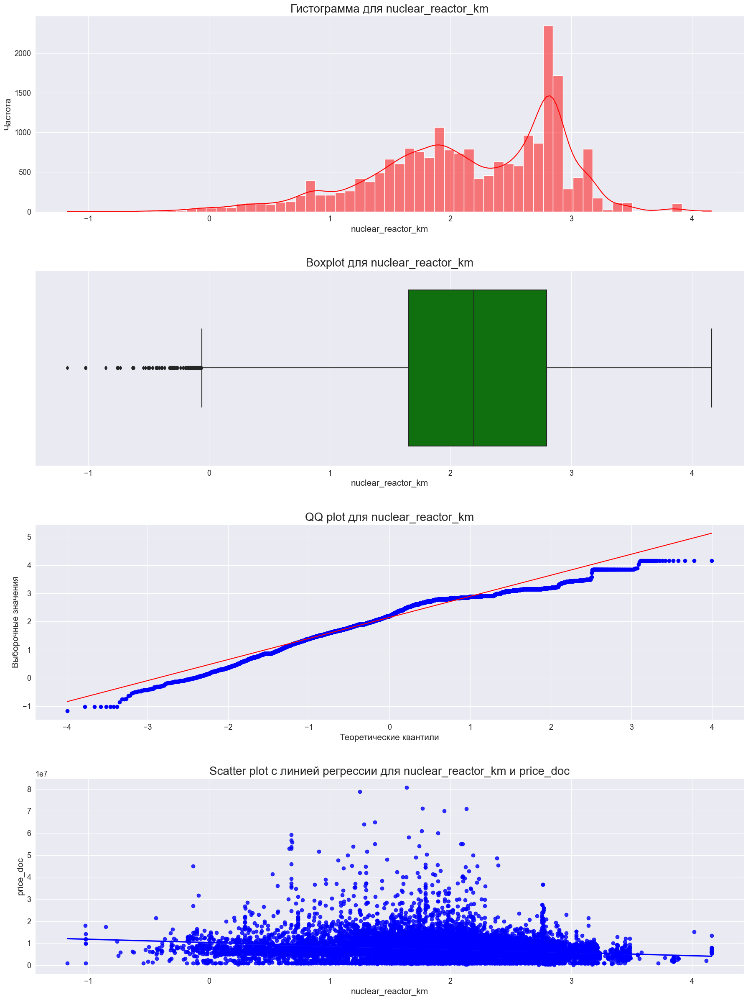


Тест Колмогорова-Смирнова:
Статистика=0.7709, p=0.0000
Отвергаем нулевую гипотезу. Признак nuclear_reactor_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.145977
std          0.762523
min         -1.171794
25%          1.653375
50%          2.195154
75%          2.795604
max          4.162890
Name: nuclear_reactor_km, dtype: float64

Корреляция Пирсона: -0.2426476431696494
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.3191291156742129
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.22021407588717956
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [13]:
quantitative_feature_analysis(df_train, 'nuclear_reactor_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -1.171794 до 4.162890
3. Медиана равна 2.195154
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 28) power_transmission_line_km

power_transmission_line_km: Расстояние до ближайшей линии электропередач (в километрах). Тип данных: float64

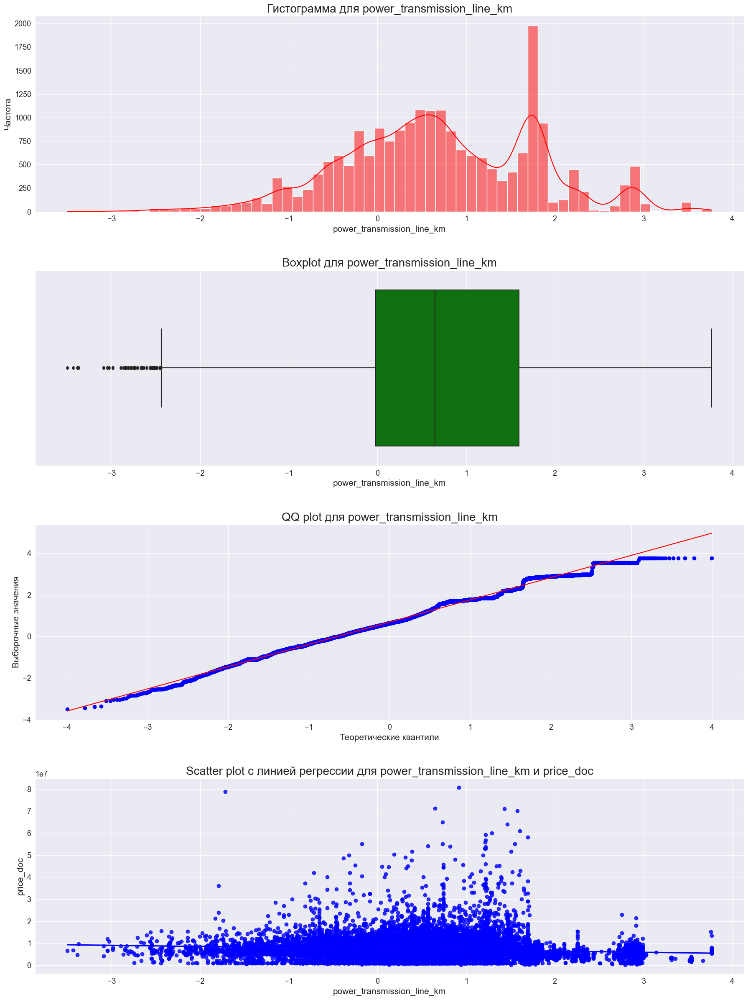


Тест Колмогорова-Смирнова:
Статистика=0.2606, p=0.0000
Отвергаем нулевую гипотезу. Признак power_transmission_line_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         0.690271
std          1.074492
min         -3.497732
25%         -0.019477
50%          0.646235
75%          1.594639
max          3.768715
Name: power_transmission_line_km, dtype: float64

Корреляция Пирсона: -0.11998094509963739
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.19403253678146543
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.1311642391048943
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [14]:
quantitative_feature_analysis(df_train, 'power_transmission_line_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -3.497732 до 3.768715
3. Медиана равна 0.646235
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 29) market_shop_km

market_shop_km: Расстояние до ближайшего рынка или магазина (в километрах). Тип данных: float64

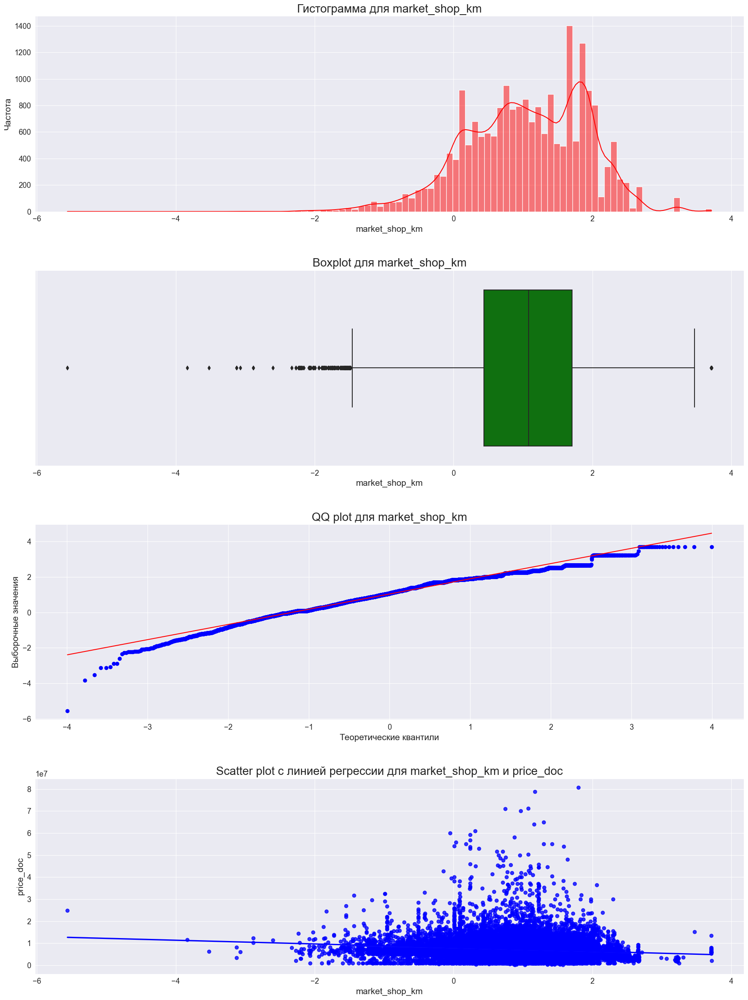


Тест Колмогорова-Смирнова:
Статистика=0.4281, p=0.0000
Отвергаем нулевую гипотезу. Признак market_shop_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.042905
std          0.866015
min         -5.560424
25%          0.436600
50%          1.078111
75%          1.709141
max          3.716097
Name: market_shop_km, dtype: float64

Корреляция Пирсона: -0.1553899951395696
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.2167493979756427
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.14746482778948528
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [16]:
quantitative_feature_analysis(df_train, 'market_shop_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -5.560424 до 3.716097
3. Медиана равна 1.078111
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 30) fitness_km

fitness_km: Расстояние до ближайшего фитнес-центра (в километрах). Тип данных: float64

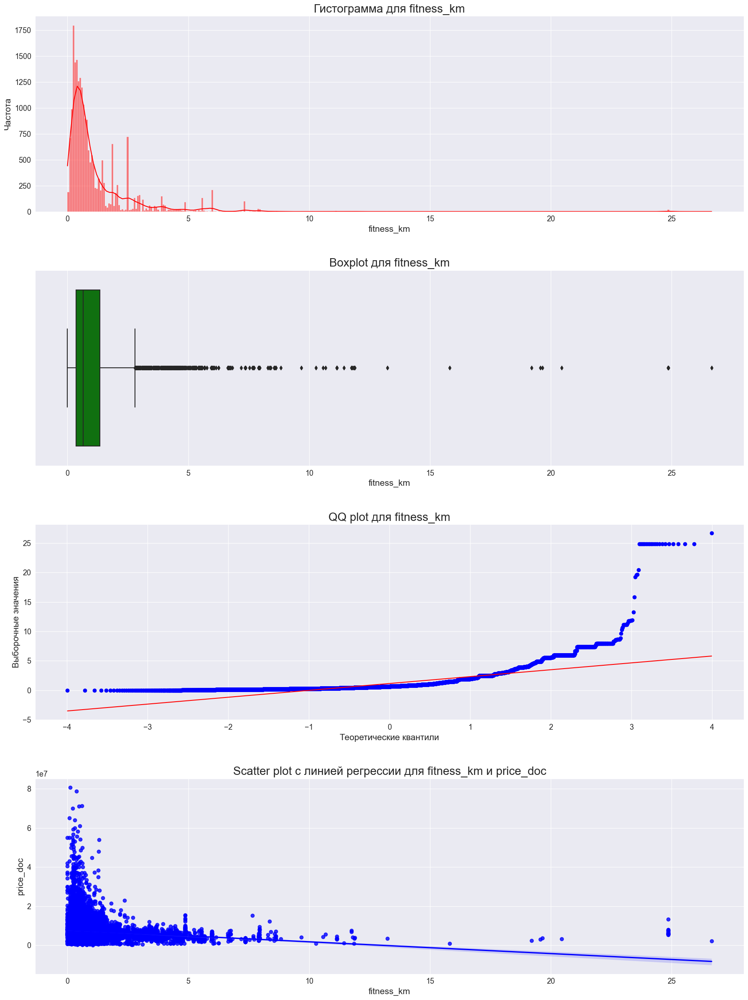


Тест Колмогорова-Смирнова:
Статистика=0.5226, p=0.0000
Отвергаем нулевую гипотезу. Признак fitness_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.155302
std          1.535428
min          0.000000
25%          0.360182
50%          0.654430
75%          1.333994
max         26.652505
Name: fitness_km, dtype: float64

Корреляция Пирсона: -0.19662298643087897
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.26739986210167316
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.18479314922855097
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [17]:
quantitative_feature_analysis(df_train, 'fitness_km', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 26.652505
3. Медиана равна 0.654430
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 31) stadium_km

stadium_km: Расстояние до ближайшего стадиона (в километрах). Тип данных: float64

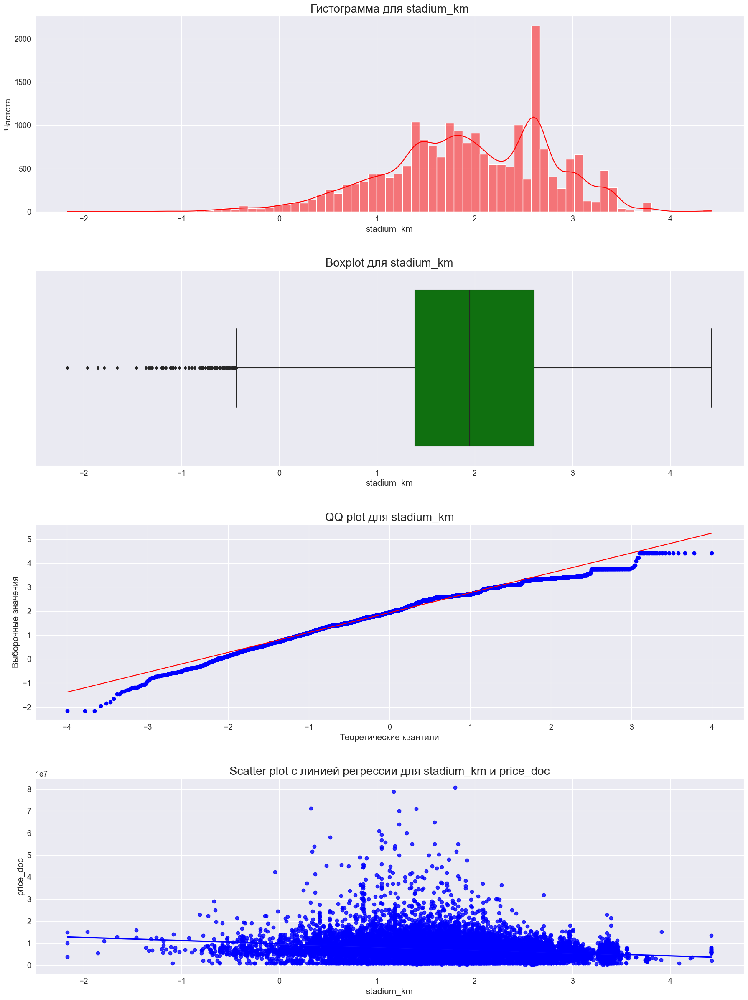


Тест Колмогорова-Смирнова:
Статистика=0.7075, p=0.0000
Отвергаем нулевую гипотезу. Признак stadium_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.936984
std          0.835306
min         -2.165038
25%          1.390835
50%          1.951334
75%          2.609465
max          4.423630
Name: stadium_km, dtype: float64

Корреляция Пирсона: -0.24775472392007475
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.2984970764411788
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.20431131462753924
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [18]:
quantitative_feature_analysis(df_train, 'stadium_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -2.165038 до 4.423630
3. Медиана равна 1.951334
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 32) basketball_km

basketball_km: Расстояние до ближайшей баскетбольной площадки (в километрах). Тип данных: float64

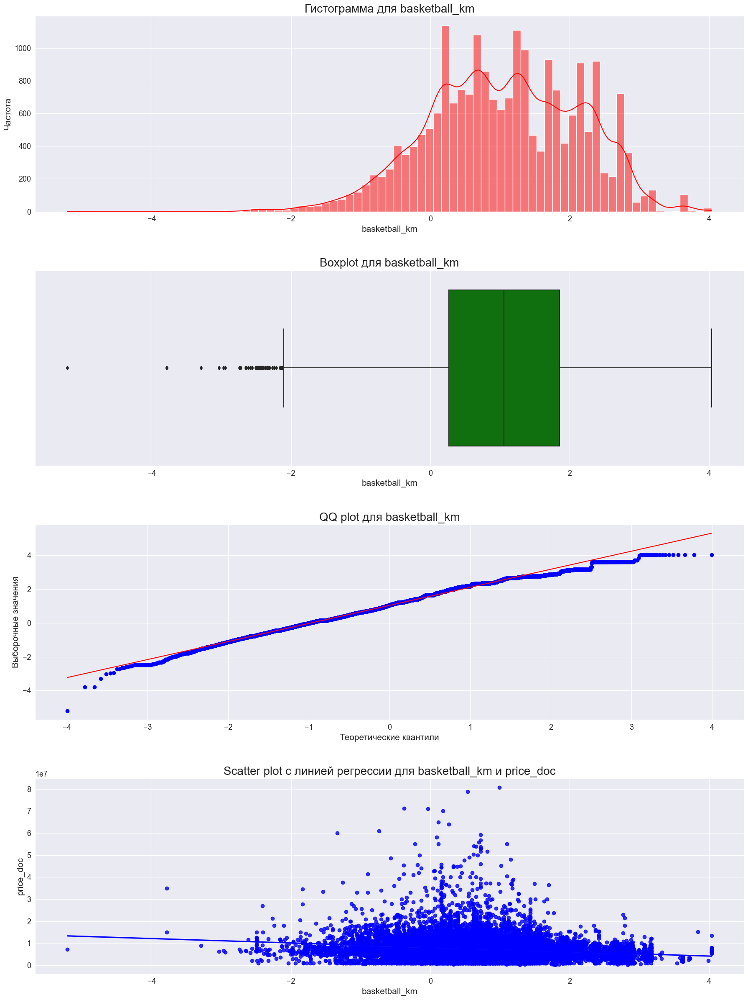


Тест Колмогорова-Смирнова:
Статистика=0.3807, p=0.0000
Отвергаем нулевую гипотезу. Признак basketball_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.043448
std          1.073377
min         -5.210630
25%          0.267047
50%          1.055415
75%          1.855079
max          4.037841
Name: basketball_km, dtype: float64

Корреляция Пирсона: -0.22700026709020993
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.2816330676101344
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.19503455539737585
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [19]:
quantitative_feature_analysis(df_train, 'basketball_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -5.210630 до 4.037841
3. Медиана равна 1.055415
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 33) detention_facility_km

detention_facility_km: Расстояние до ближайшего исправительного учреждения (в километрах). Тип данных: float64

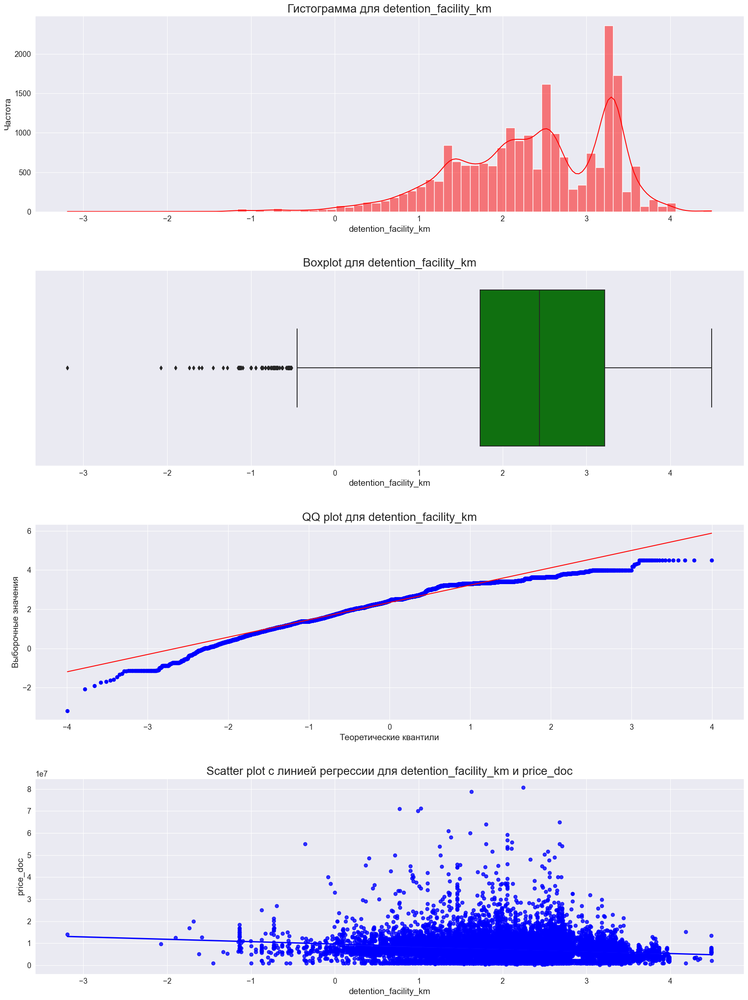


Тест Колмогорова-Смирнова:
Статистика=0.7809, p=0.0000
Отвергаем нулевую гипотезу. Признак detention_facility_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.343118
std          0.900849
min         -3.188660
25%          1.732764
50%          2.440538
75%          3.218377
max          4.492800
Name: detention_facility_km, dtype: float64

Корреляция Пирсона: -0.20664758959827184
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.27345364088000756
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.18853519750194506
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [20]:
quantitative_feature_analysis(df_train, 'detention_facility_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -3.188660 до 4.492800
3. Медиана равна 2.440538
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 34) additional_education_km

additional_education_km: Расстояние до ближайшего учреждения дополнительного образования (в километрах). Тип данных: float64

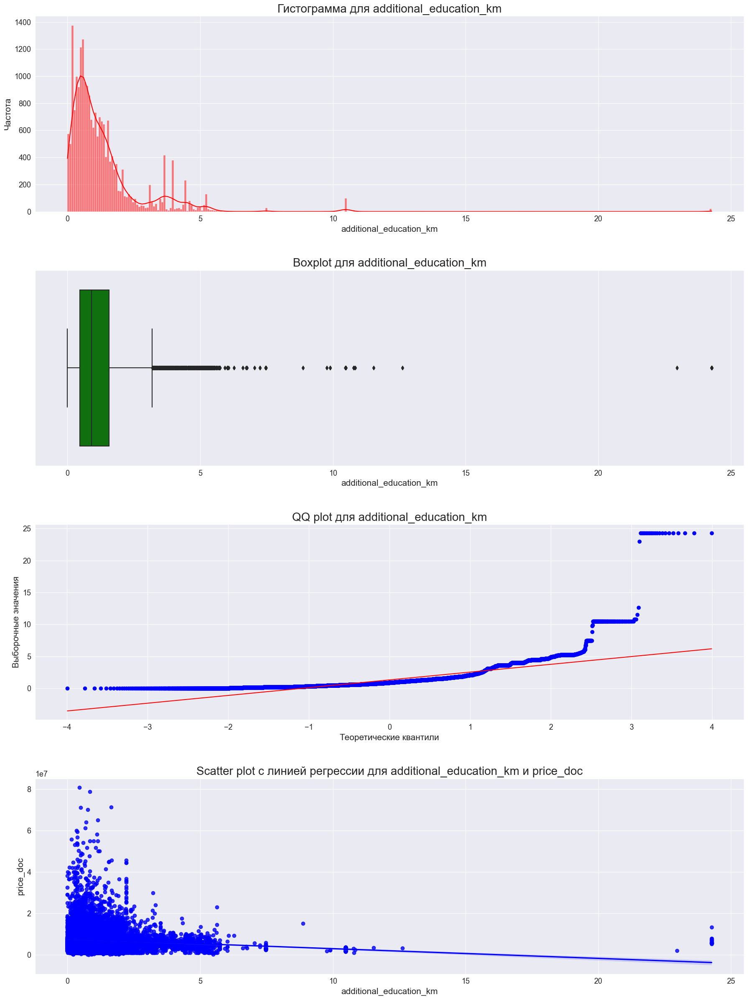


Тест Колмогорова-Смирнова:
Статистика=0.5128, p=0.0000
Отвергаем нулевую гипотезу. Признак additional_education_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.327968
std          1.520137
min          0.000000
25%          0.473349
50%          0.900319
75%          1.564696
max         24.268209
Name: additional_education_km, dtype: float64

Корреляция Пирсона: -0.15150617305541308
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.15555763177211746
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.10546394255226961
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [21]:
quantitative_feature_analysis(df_train, 'additional_education_km', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 24.268209
3. Медиана равна 0.900319
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 35) big_church_km

big_church_km: Расстояние до ближайшей крупной церкви (в километрах). Тип данных: float64

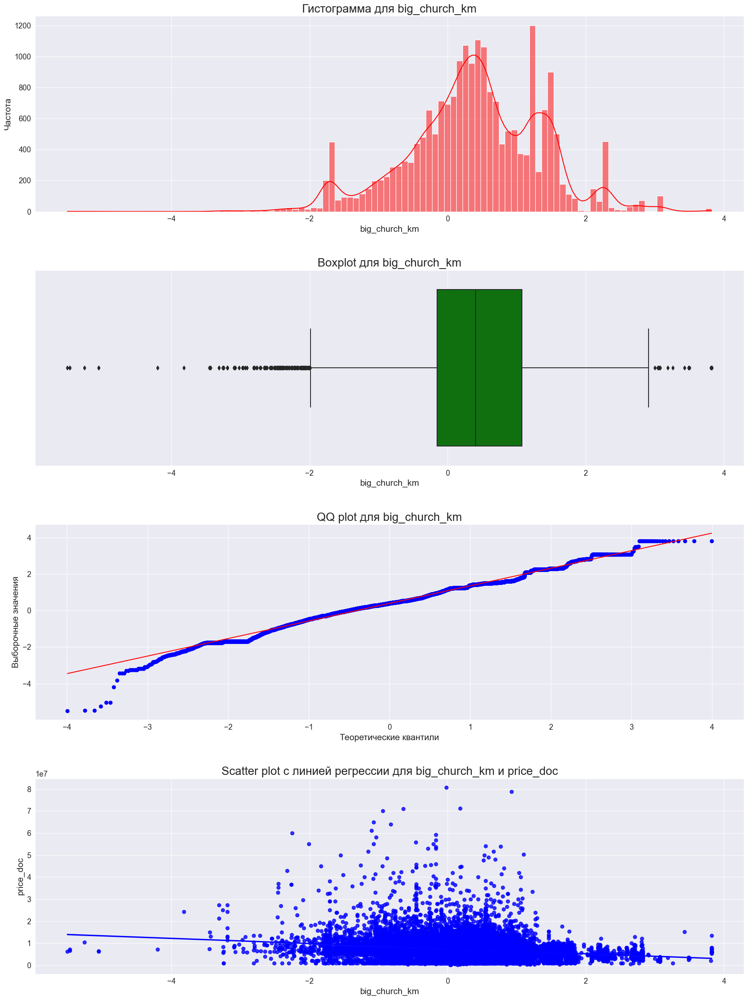


Тест Колмогорова-Смирнова:
Статистика=0.1980, p=0.0000
Отвергаем нулевую гипотезу. Признак big_church_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         0.393166
std          0.968606
min         -5.503652
25%         -0.149911
50%          0.404499
75%          1.073952
max          3.821421
Name: big_church_km, dtype: float64

Корреляция Пирсона: -0.2391909551102339
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.3007073589394072
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.20827954348807687
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [22]:
quantitative_feature_analysis(df_train, 'big_church_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -5.503652 до 3.821421
3. Медиана равна 0.404499
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 36) mosque_km

mosque_km: Расстояние до ближайшей мечети (в километрах). Тип данных: float64

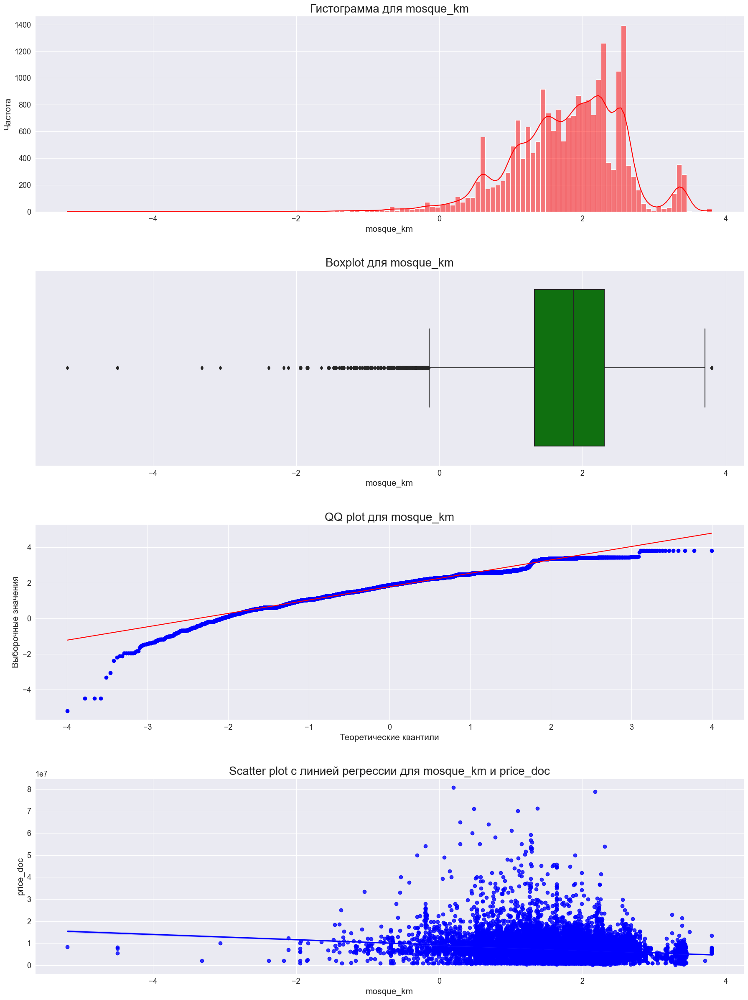


Тест Колмогорова-Смирнова:
Статистика=0.7077, p=0.0000
Отвергаем нулевую гипотезу. Признак mosque_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.787875
std          0.762706
min         -5.194945
25%          1.326032
50%          1.874393
75%          2.306243
max          3.803320
Name: mosque_km, dtype: float64

Корреляция Пирсона: -0.19255898784253922
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.17963067704213753
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.1227996423862607
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [23]:
quantitative_feature_analysis(df_train, 'mosque_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -5.194945 до 3.803320
3. Медиана равна 1.874393
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 37) theater_km

theater_km: Расстояние до ближайшего театра (в километрах). Тип данных: float64

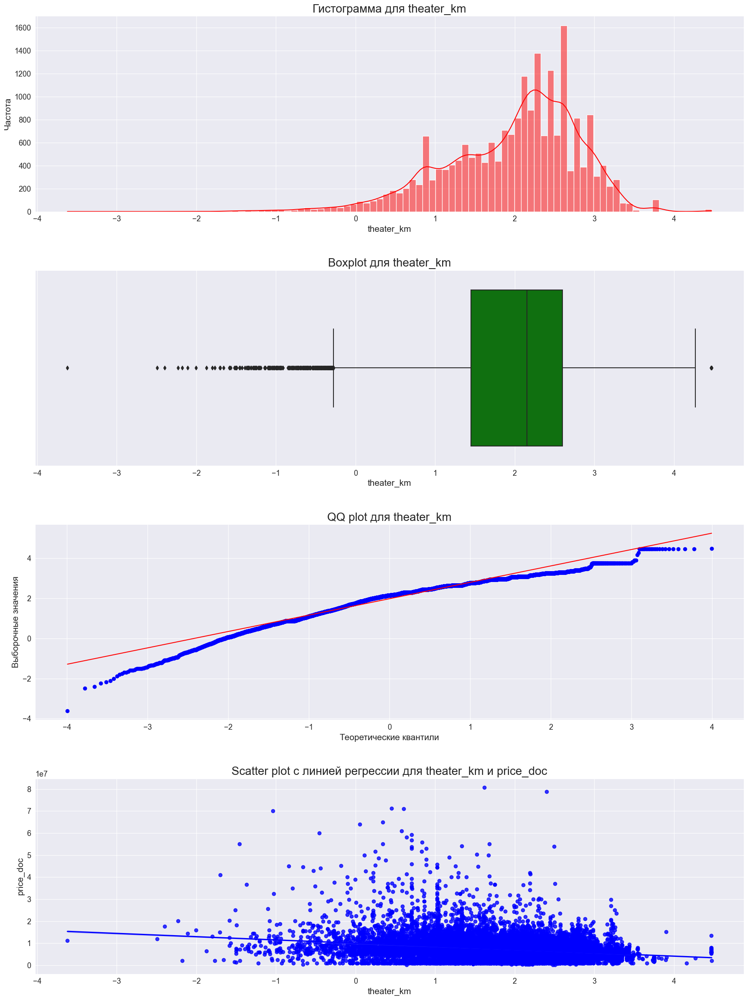


Тест Колмогорова-Смирнова:
Статистика=0.7073, p=0.0000
Отвергаем нулевую гипотезу. Признак theater_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.978835
std          0.834164
min         -3.619798
25%          1.448006
50%          2.153157
75%          2.599404
max          4.472789
Name: theater_km, dtype: float64

Корреляция Пирсона: -0.26113606748829443
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.24815790680955424
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.1718366561923469
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [24]:
quantitative_feature_analysis(df_train, 'theater_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -3.619798 до 4.472789
3. Медиана равна 2.153157
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 38) exhibition_km

exhibition_km: Расстояние до ближайшего выставочного центра (в километрах). Тип данных: float64

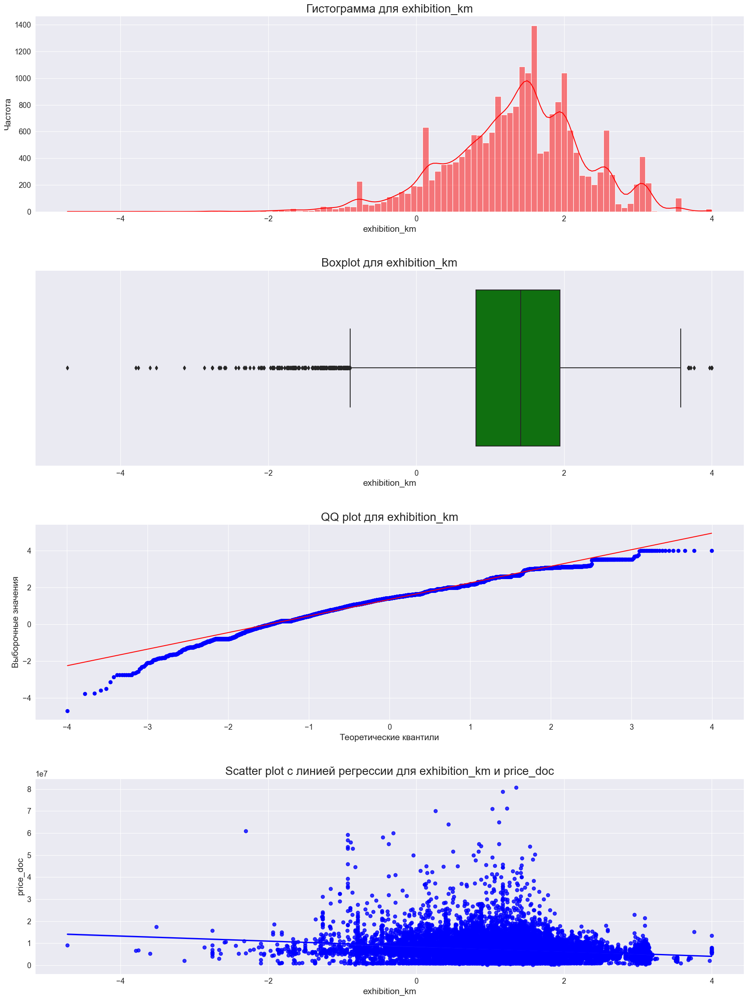


Тест Колмогорова-Смирнова:
Статистика=0.5456, p=0.0000
Отвергаем нулевую гипотезу. Признак exhibition_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         1.345166
std          0.907355
min         -4.716181
25%          0.810275
50%          1.415344
75%          1.946334
max          3.996938
Name: exhibition_km, dtype: float64

Корреляция Пирсона: -0.22208761680222505
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.2777657545239865
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.19149541981937204
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [25]:
quantitative_feature_analysis(df_train, 'exhibition_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -4.716181 до 3.996938
3. Медиана равна 1.415344
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 39) catering_km

catering_km: Расстояние до ближайшего заведения общественного питания (в километрах). Тип данных: float64

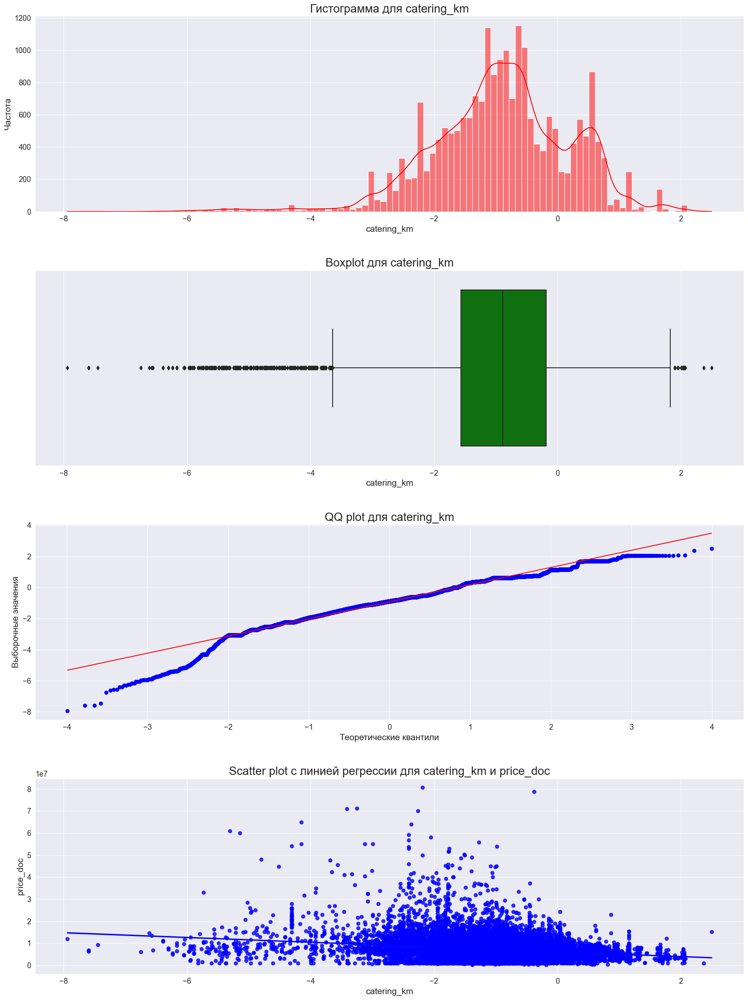


Тест Колмогорова-Смирнова:
Статистика=0.3730, p=0.0000
Отвергаем нулевую гипотезу. Признак catering_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean        -0.918657
std          1.117162
min         -7.938627
25%         -1.565852
50%         -0.888820
75%         -0.182727
max          2.498374
Name: catering_km, dtype: float64

Корреляция Пирсона: -0.2572705467967018
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.2740293315200819
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.18863717736876906
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [26]:
quantitative_feature_analysis(df_train, 'catering_km', 'price_doc')

1. Не нормальное распределение
2. Значения от -7.938627 до 2.498374
3. Медиана равна -0.888820
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения km принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 40) green_part_1000

green_part_1000: Доля зеленых зон в радиусе 1000 метров. Тип данных: float64

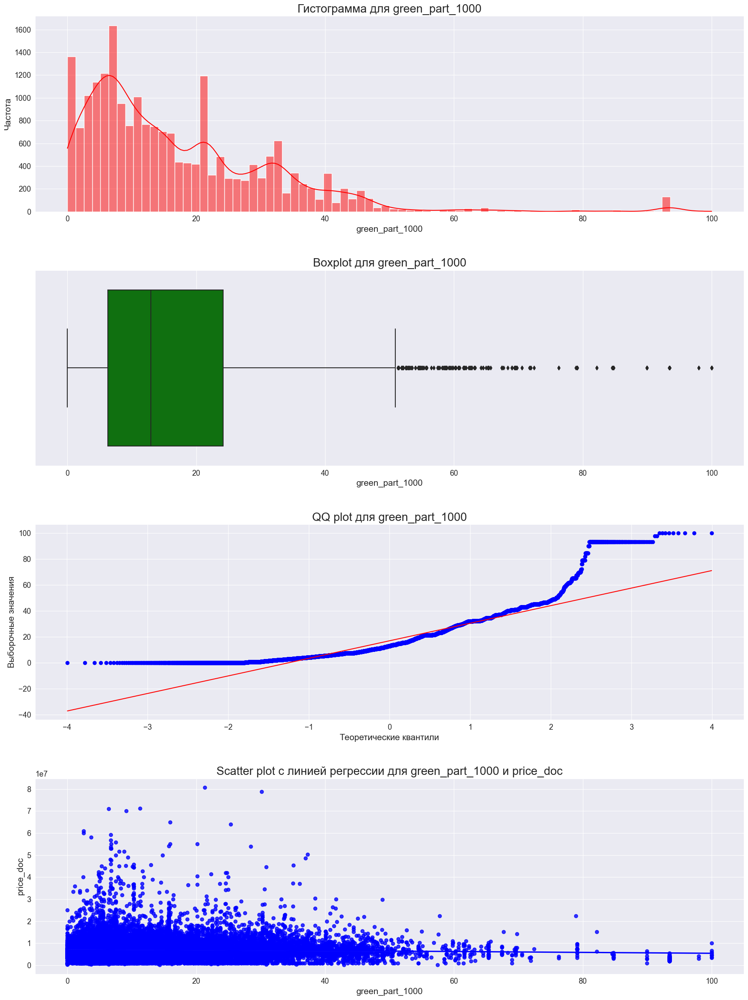


Тест Колмогорова-Смирнова:
Статистика=0.8998, p=0.0000
Отвергаем нулевую гипотезу. Признак green_part_1000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean        16.938400
std         14.607117
min          0.000000
25%          6.260000
50%         12.950000
75%         24.160000
max        100.000000
Name: green_part_1000, dtype: float64

Корреляция Пирсона: -0.062273942974789415
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.013959514633847484
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.009892715047489124
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [27]:
quantitative_feature_analysis(df_train, 'green_part_1000', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 100
3. Медиана равна 12.950000
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 41) cafe_sum_1000_min_price_avg

cafe_sum_1000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 1000 метров. Тип данных: float64

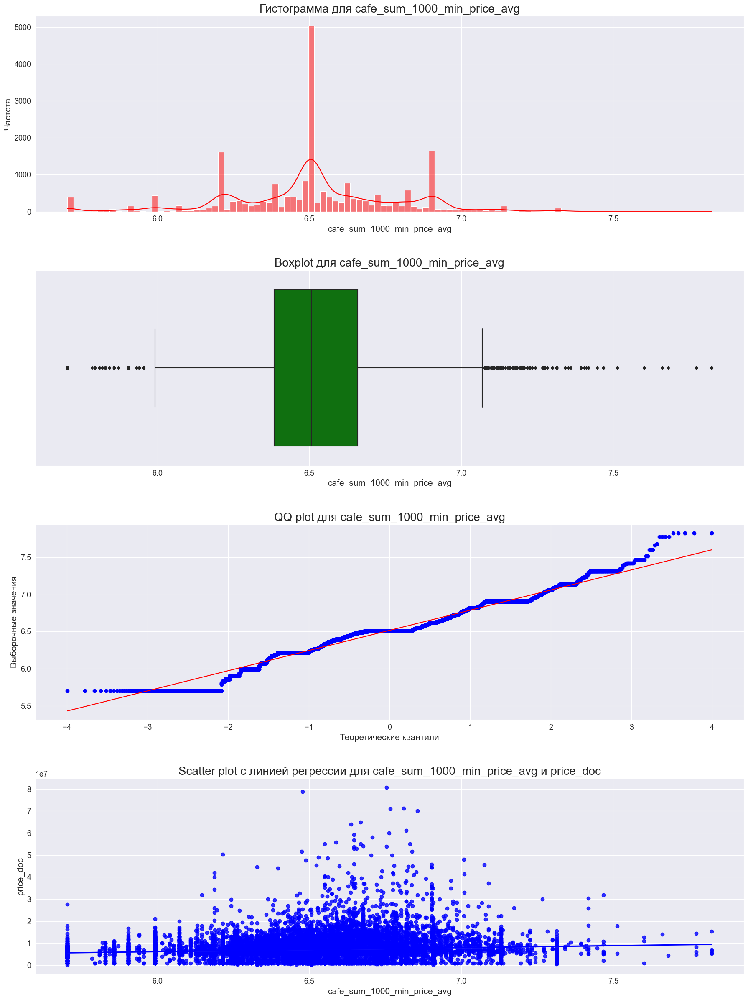


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_sum_1000_min_price_avg, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         6.515025
std          0.276715
min          5.703782
25%          6.384030
50%          6.506128
75%          6.659294
max          7.824046
Name: cafe_sum_1000_min_price_avg, dtype: float64

Корреляция Пирсона: 0.10636420821949175
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.07696854914187173
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.051141517470336566
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [28]:
quantitative_feature_analysis(df_train, 'cafe_sum_1000_min_price_avg', 'price_doc')

1. Не нормальное распределение
2. Значения от 5.703782 до 7.824046
3. Медиана равна 6.506128
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 42) cafe_count_1000_price_high

cafe_count_1000_price_high: Количество дорогих кафе в радиусе 1000 метров. Тип данных: int64

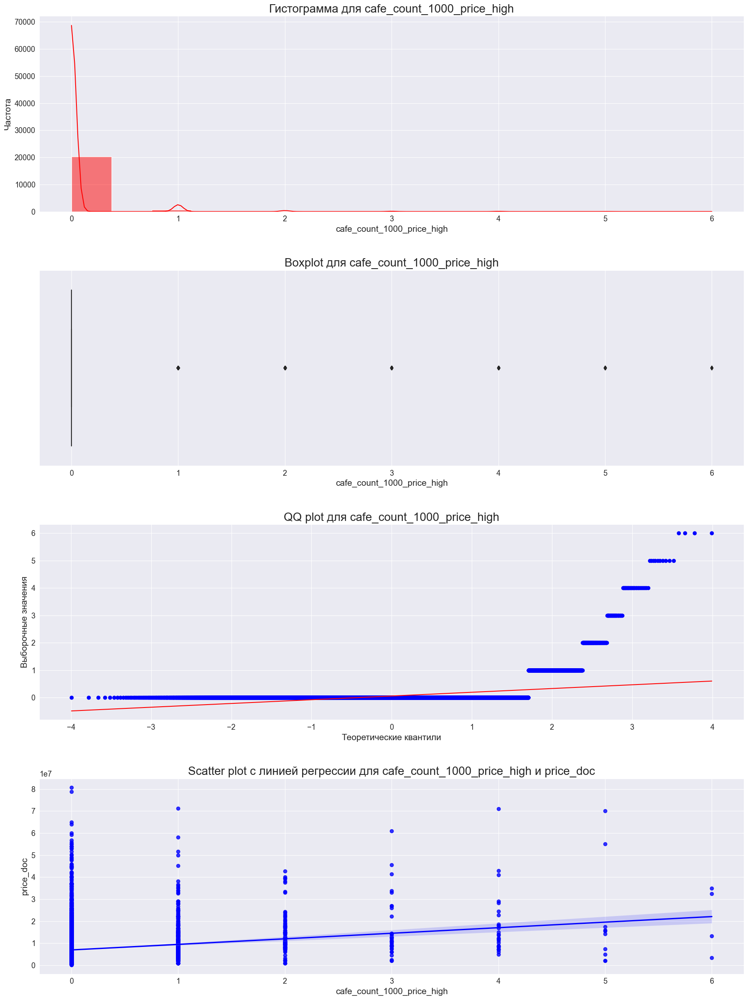


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_count_1000_price_high, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         0.059028
std          0.325858
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          6.000000
Name: cafe_count_1000_price_high, dtype: float64

Корреляция Пирсона: 0.17469180710426857
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.07142174559062077
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.058138115632243505
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [29]:
quantitative_feature_analysis(df_train, 'cafe_count_1000_price_high', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 6
3. Медиана равна 0
4. Имеется статистически значимая корреляция

## 43) cafe_sum_1500_min_price_avg

cafe_sum_1500_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 1500 метров. Тип данных: float64

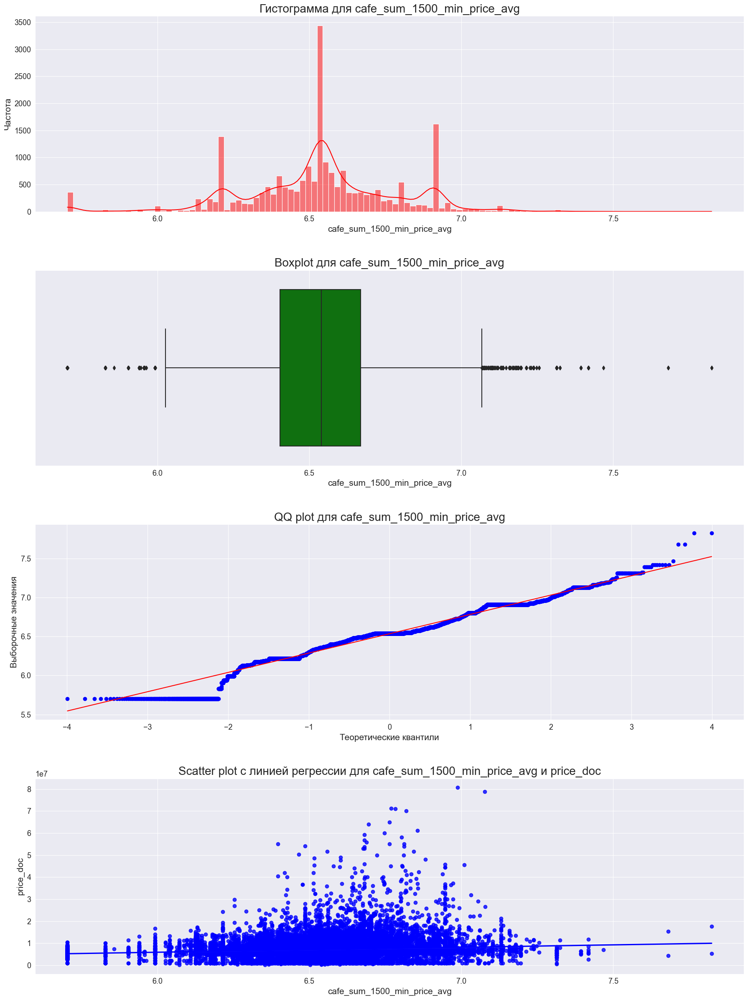


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_sum_1500_min_price_avg, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         6.535018
std          0.252222
min          5.703782
25%          6.402862
50%          6.540034
75%          6.668863
max          7.824046
Name: cafe_sum_1500_min_price_avg, dtype: float64

Корреляция Пирсона: 0.11985895187444373
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.08614615446271139
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.05809363930970903
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [30]:
quantitative_feature_analysis(df_train, 'cafe_sum_1500_min_price_avg', 'price_doc')

1. Не нормальное распределение
2. Значения от 5.703782 до 7.824046
3. Медиана равна 6.540034
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 44) green_part_2000

green_part_2000: Доля зеленых зон в радиусе 2000 метров. Тип данных: float64

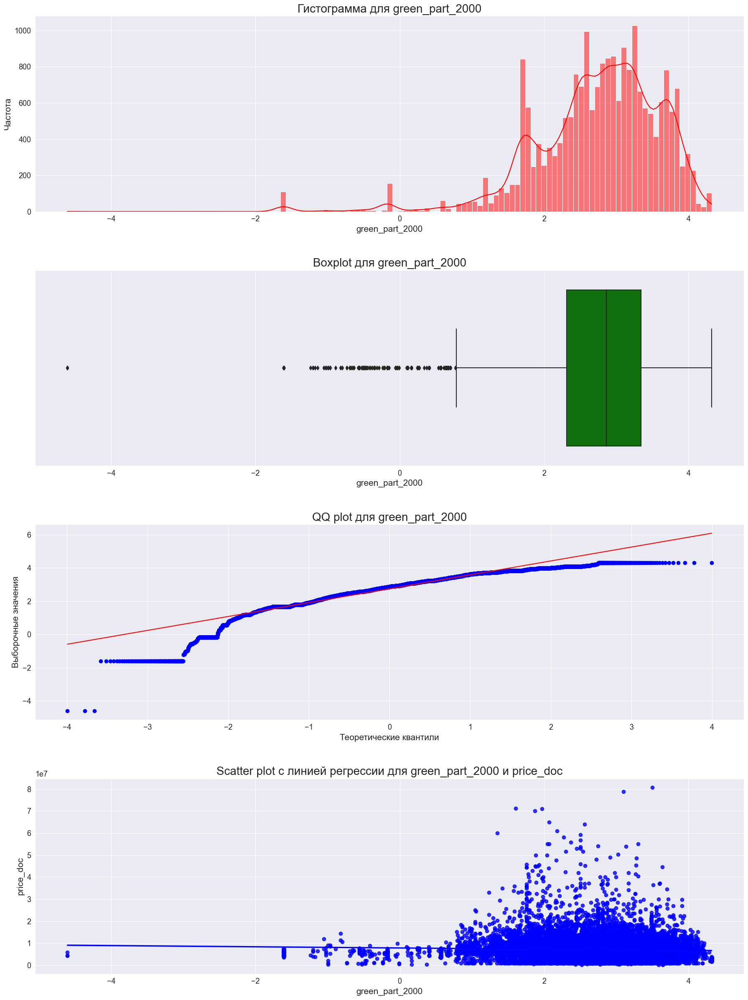


Тест Колмогорова-Смирнова:
Статистика=0.8778, p=0.0000
Отвергаем нулевую гипотезу. Признак green_part_2000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.749243
std          0.870977
min         -4.605170
25%          2.314514
50%          2.865054
75%          3.341447
max          4.321480
Name: green_part_2000, dtype: float64

Корреляция Пирсона: -0.0502801775314781
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: -0.07930341880189114
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: -0.054257423470993174
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [31]:
quantitative_feature_analysis(df_train, 'green_part_2000', 'price_doc')

1. Не нормальное распределение
2. Значения от -4.605170 до  4.321480
3. Медиана равна 2.865054
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Значения принимают отрицательные значения, что очень странно

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить признак полностью

## 45) cafe_sum_2000_min_price_avg

cafe_sum_2000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 2000 метров. Тип данных: float64

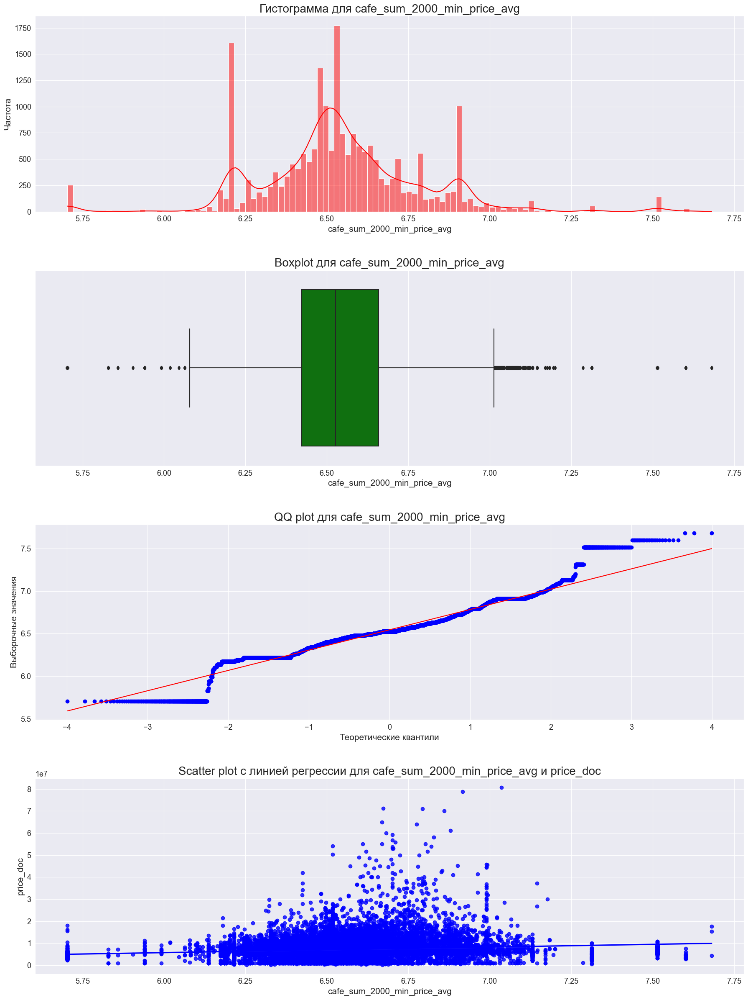


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_sum_2000_min_price_avg, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         6.545043
std          0.244766
min          5.703782
25%          6.422240
50%          6.526978
75%          6.659294
max          7.680947
Name: cafe_sum_2000_min_price_avg, dtype: float64

Корреляция Пирсона: 0.13078310859628675
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.12396503667225894
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.0846969801337401
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [32]:
quantitative_feature_analysis(df_train, 'cafe_sum_2000_min_price_avg', 'price_doc')

1. Не нормальное распределение
2. Значения от 5.703782 до 7.680947
3. Медиана равна 6.526978
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 46) mosque_count_3000

mosque_count_3000: Количество мечетей в радиусе 3000 метров. Тип данных: int64

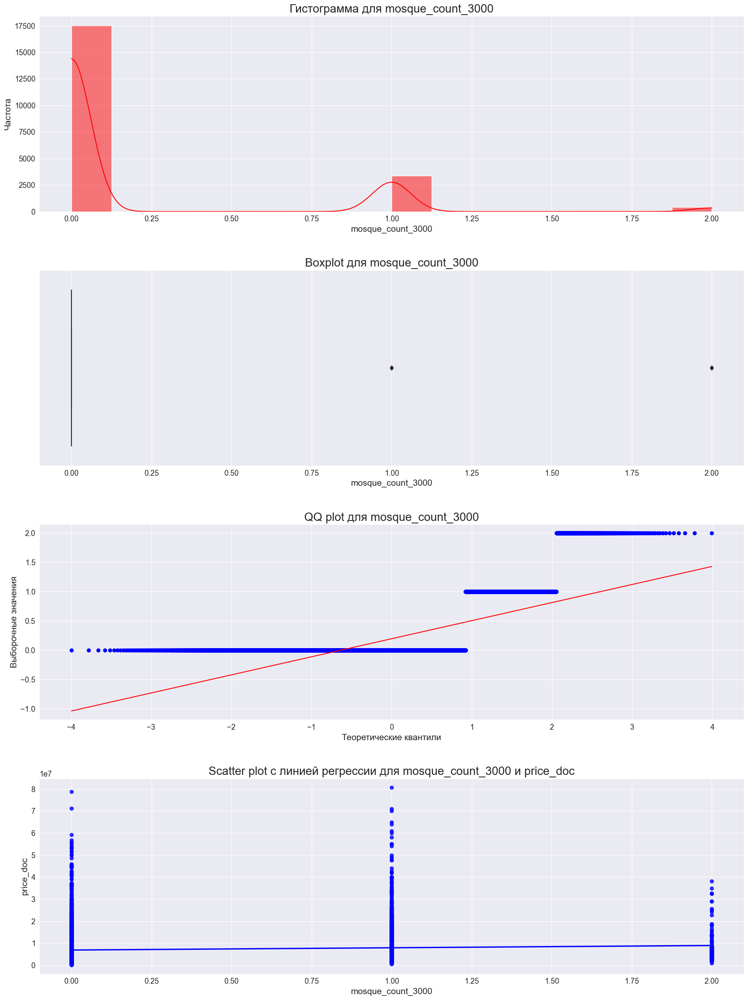


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак mosque_count_3000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         0.197900
std          0.445642
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.000000
Name: mosque_count_3000, dtype: float64

Корреляция Пирсона: 0.09817601989969246
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.09230538664138269
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.07504364165578391
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [33]:
quantitative_feature_analysis(df_train, 'mosque_count_3000', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 2
3. Медиана равна 0
4. Имеется статистически значимая корреляция

## 47) prom_part_5000

prom_part_5000: Промышленная часть в радиусе 5000 метров. Тип данных: float64

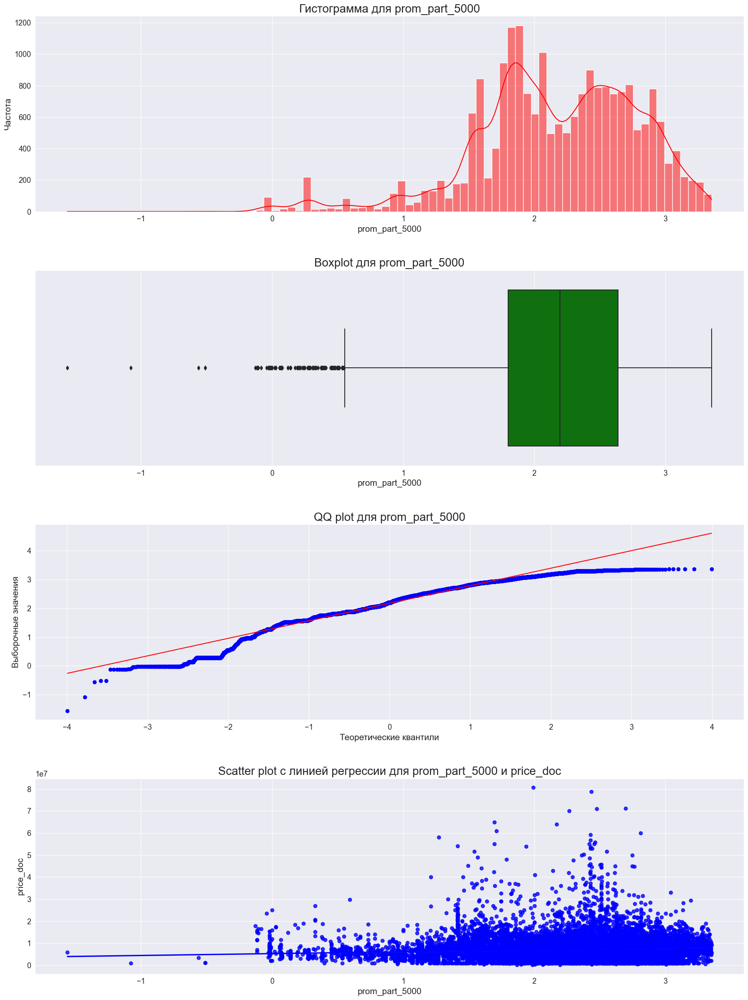


Тест Колмогорова-Смирнова:
Статистика=0.8395, p=0.0000
Отвергаем нулевую гипотезу. Признак prom_part_5000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         2.170806
std          0.619349
min         -1.560648
25%          1.801710
50%          2.195000
75%          2.636912
max          3.352007
Name: prom_part_5000, dtype: float64

Корреляция Пирсона: 0.11055979715981369
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.17423365040081149
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.11758612298070976
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [34]:
quantitative_feature_analysis(df_train, 'prom_part_5000', 'price_doc')

1. Не нормальное распределение
2. Значения от -1.560648 до 3.352007
3. Медиана равна 2.195000
4. Имеется статистически значимая корреляция
5. Имеются выбросы
6. Имеются отрицаельные значения, не понятно почему так

Варианты для обработки признака:
1. Удалить выбросы, либо оставить
2. Удалить все отрицательные значения или взять модуль

## 48) cafe_sum_5000_min_price_avg

cafe_sum_5000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 5000 метров. Тип данных: float64

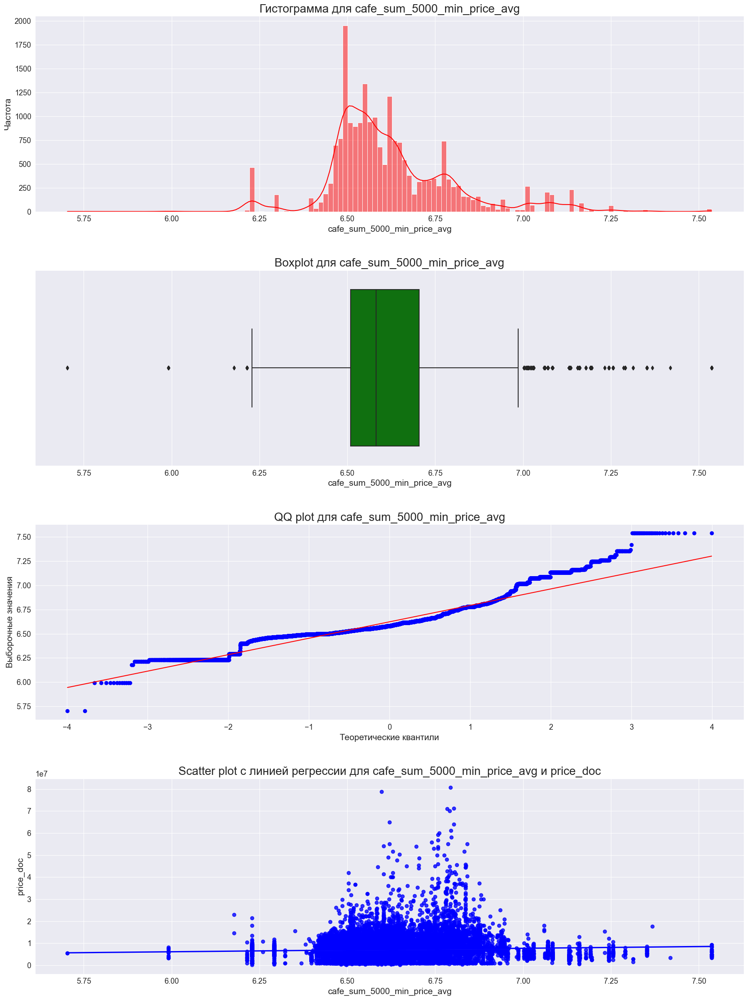


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_sum_5000_min_price_avg, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         6.622740
std          0.177794
min          5.703782
25%          6.509022
50%          6.581665
75%          6.703654
max          7.536364
Name: cafe_sum_5000_min_price_avg, dtype: float64

Корреляция Пирсона: 0.059520196083758366
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.055198882426839076
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.03809393491096474
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [35]:
quantitative_feature_analysis(df_train, 'cafe_sum_5000_min_price_avg', 'price_doc')

1. Не нормальное распределение
2. Значения от 5.703782 до 7.536364
3. Медиана равна 6.581665
4. Имеется статистически значимая корреляция
5. Имеются выбросы

Варианты для обработки признака:
1. Удалить выбросы, либо оставить

## 49) mosque_count_5000

mosque_count_5000: Количество мечетей в радиусе 5000 метров. Тип данных: int64

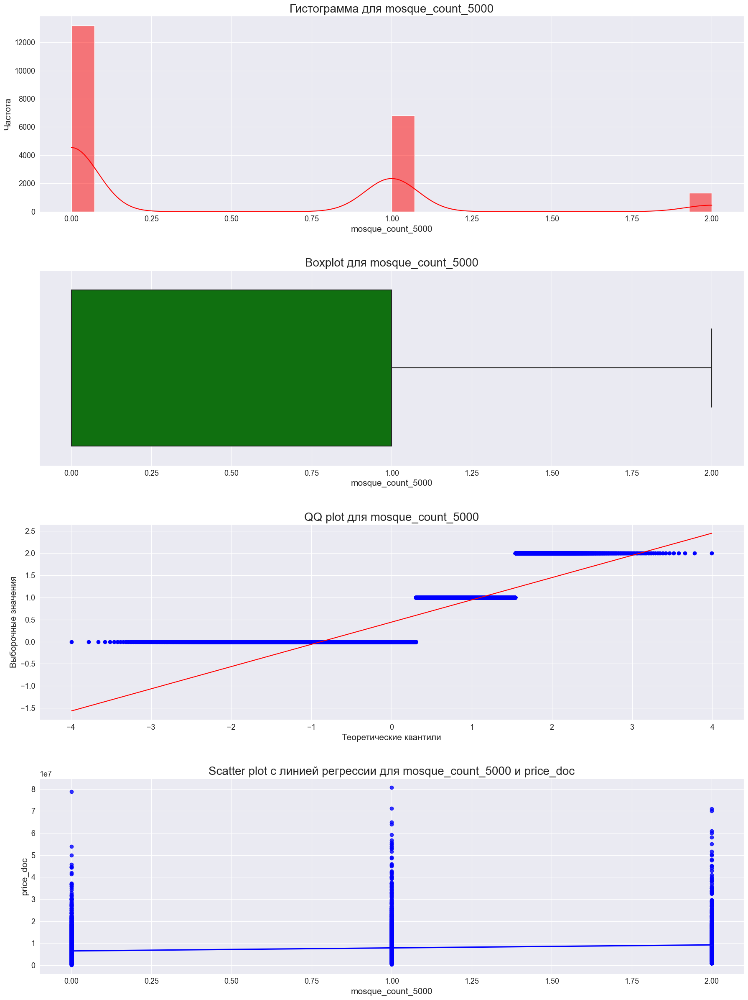


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак mosque_count_5000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean         0.442496
std          0.607982
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max          2.000000
Name: mosque_count_5000, dtype: float64

Корреляция Пирсона: 0.17783901097200744
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.14057441777987734
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.11252785490591424
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [36]:
quantitative_feature_analysis(df_train, 'mosque_count_5000', 'price_doc')

1. Не нормальное распределение
2. Значения от 0 до 2
3. Медиана равна 0
4. Имеется статистически значимая корреляция

## 50) year

year: Год данных. Тип данных: int64

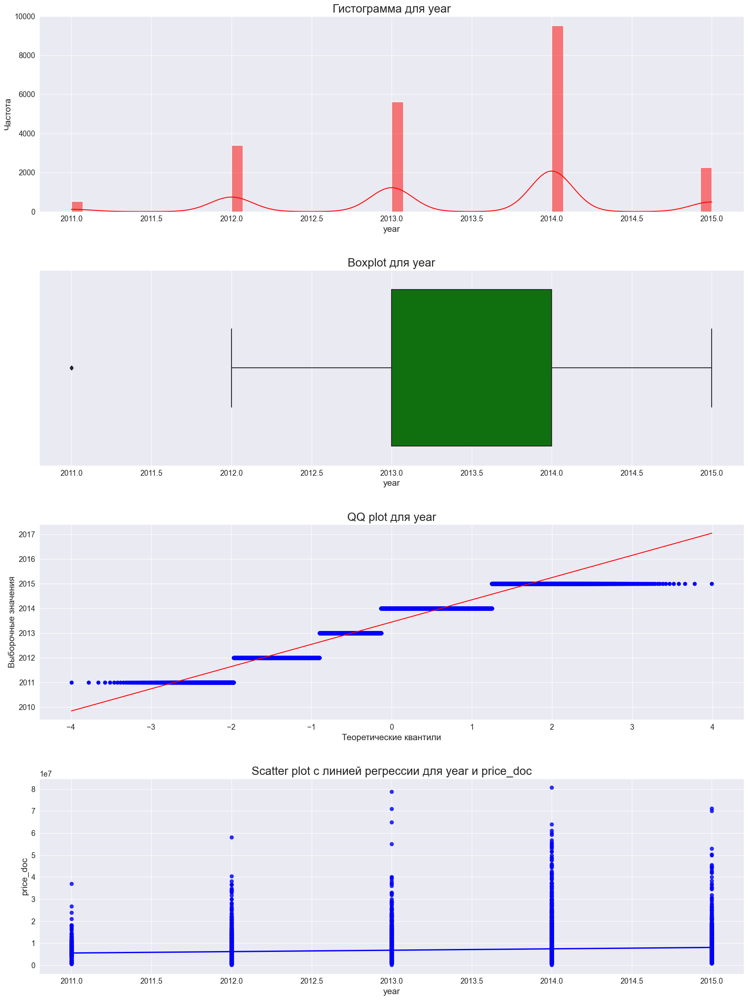


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак year, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    21329.000000
mean      2013.449388
std          0.961555
min       2011.000000
25%       2013.000000
50%       2014.000000
75%       2014.000000
max       2015.000000
Name: year, dtype: float64

Корреляция Пирсона: 0.12935327938159563
Отвергаем нулевую гипотезу для корреляции Пирсона. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Спирмена: 0.17354691517767262
Отвергаем нулевую гипотезу для корреляции Спирмена. Вероятно, корреляция статистически ЗНАЧИМА.

Корреляция Кендалла: 0.1320977837353135
Отвергаем нулевую гипотезу для корреляции Кендалла. Вероятно, корреляция статистически ЗНАЧИМА.


In [38]:
quantitative_feature_analysis(df_train, 'year', 'price_doc')

1. Не нормальное распределение
2. Значения от 2011 до 2015
3. Медиана равна 2014
4. Имеется статистически значимая корреляция

In [57]:
df_train_copy[df_train_copy['build_year'] > 2015][['build_year', 'year']]

,build_year,year
37,2016.0,2015
44,2017.0,2014
170,2016.0,2015
227,2016.0,2015
344,2017.0,2015
...,...,...
20993,2017.0,2014
21116,2017.0,2014
21192,2016.0,2014
21220,2016.0,2014


## 51) price_doc

price_doc: Цена недвижимости. Тип данных: int64

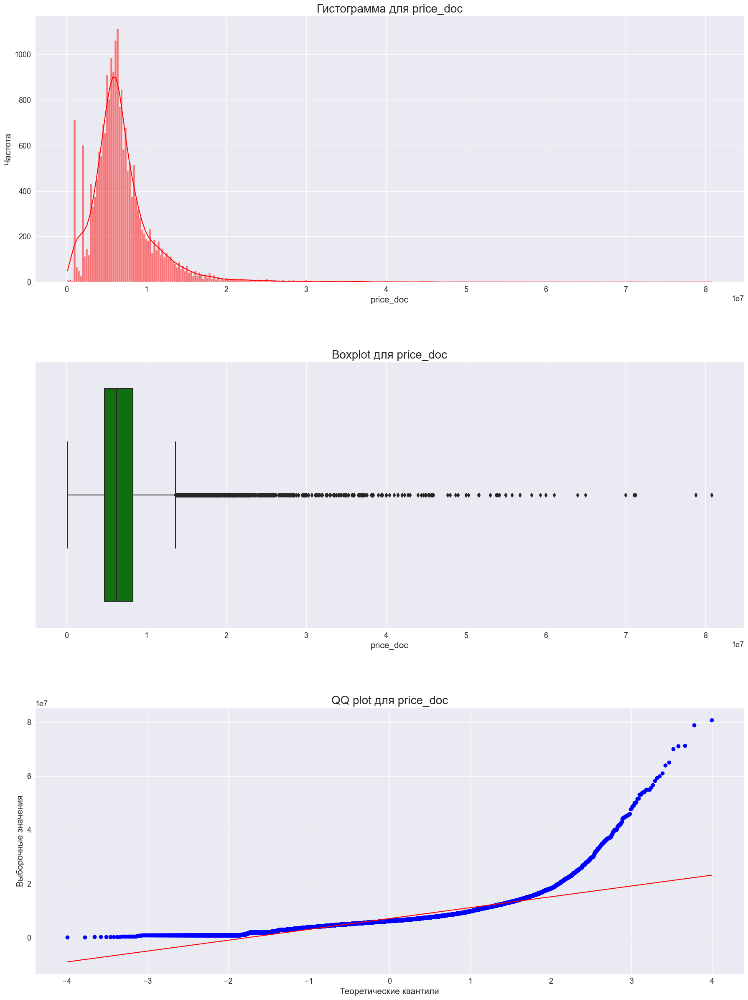


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак price_doc, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    2.132900e+04
mean     7.117599e+06
std      4.706342e+06
min      1.000000e+05
25%      4.745995e+06
50%      6.255454e+06
75%      8.300000e+06
max      8.077744e+07
Name: price_doc, dtype: float64


In [15]:
target_feature_analysis(df_train, 'price_doc')

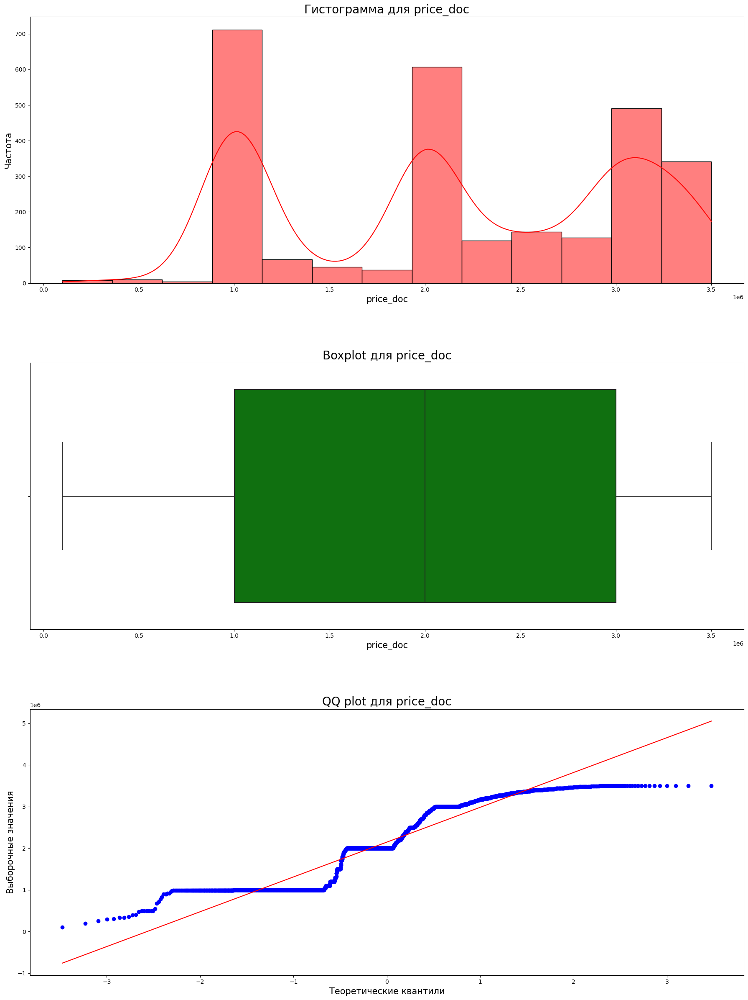


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак price_doc, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    2.714000e+03
mean     2.148545e+06
std      8.833069e+05
min      1.000000e+05
25%      1.001250e+06
50%      2.000000e+06
75%      3.000000e+06
max      3.500000e+06
Name: price_doc, dtype: float64


In [34]:
target_feature_analysis(df_train.loc[(df_train['price_doc'] <= 3_500_000)], 'price_doc')

1. Не нормальное распределение
2. Значения от 1.000000e+05 до 1.000000e+05
3. Медиана равна 2.000000e+06
4. Имеются выбросы
5. Видно, что значения 1М, 2М, 3М часто встречаются
6. Квартира в Москве за 100к, звучит интересно даже для того времени. Нужно будет проанализировать этот момент.

## Взаимосвязь признаков

Посмторим тепловую карту, чтобы увидеть взаимосвязь признаков. Будем использовать коэффициент корреляции Спирмена, так как нормального распредления в исходных данных нет ни у одного признака. 

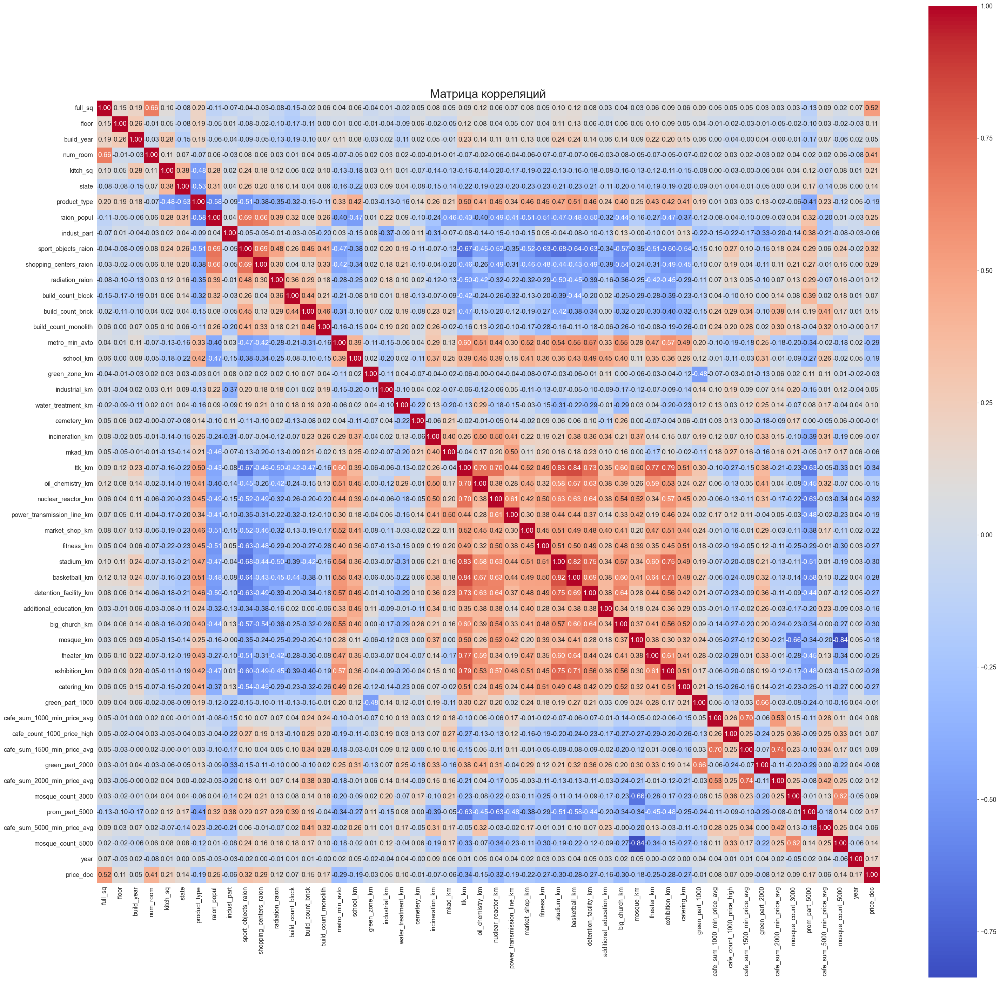

In [145]:
df_corr = df_train.drop(columns='ID_railroad_station_avto')
plt.figure(figsize=(36, 36))
sns.heatmap(df_corr.corr(method='spearman'), annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True)
plt.title('Матрица корреляций', fontsize='xx-large')
plt.show()

Из тепловой карты видно, что присутствует линейная мультиколлениарность.

In [15]:
# Посчитаем VIF между данными
vif_df_train = df_train.copy()
vif_df_train = vif_df_train.dropna()
vif_df_train = vif_df_train.drop(columns=['ID_railroad_station_avto', 'product_type', 'radiation_raion'], axis=1)
X = vif_df_train.assign(const=1)
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["features"] = X.columns
vif

,VIF Factor,features
0,1.180582e+00,full_sq
1,1.126367e+00,floor
2,1.136642e+00,build_year
3,1.269552e+00,num_room
4,1.006112e+00,kitch_sq
5,1.355525e+00,state
6,5.160729e+00,raion_popul
7,1.744444e+00,indust_part
8,6.918734e+00,sport_objects_raion
9,3.880107e+00,shopping_centers_raion


Из результатов VIF, можно сказать, что у нас нет прям сильной нелинейной мультиколлениарной зависимотси в данных.

# Выводы, что можно сделать с тренировочными данными

1. Поработать с дупликатами
2. Удалить выбросы больше  у kitch_sq
3. Удалить выбросы, либо оставить у indust_part, sport_objects_raion, shopping_centers_raion, build_count_block, build_count_brick, build_count_monolith, school_km, industrial_km, fitness_km, additional_education_km, green_part_1000, cafe_sum_1000_min_price_avg, cafe_sum_1500_min_price_avg, cafe_sum_2000_min_price_avg, prom_part_5000, cafe_sum_5000_min_price_avg
3. Заменить значения у full_sq, floor, build_year, num_room, school_km, green_zone_km, industrial_km с 0 на NaN, статистическим значением или удалить записи
4. Заменить значения у kitch_sq у записей с 0 на NaN, статистическим значением, удалить записи или оставить, так как могут быть квартиры евроформата
5. Синтетически увеличить количество записей с True у product_type, radiation_raion
6. Удалить все отрицательные значения или взять модуль у water_treatment_km, incineration_km, mkad_km, ttk_km, oil_chemistry_km, nuclear_reactor_km, power_transmission_line_km, market_shop_km, stadium_km, basketball_km, detention_facility_km, big_church_km, mosque_km, theater_km, exhibition_km, catering_km + /Удалить выбросы
7. Убрать признак cemetery_km полностью из датасета
9. Есть признаки, где 0 скорее всего это заполненный пропуск, ибо есть 0.0 и 0.000000
10. Оставить какой-то один признак из : cafe_sum_1000_min_price_avg, cafe_sum_1500_min_price_avg, cafe_sum_2000_min_price_avg, cafe_sum_5000_min_price_avg
11. Оставить какой-то один признак из: green_part_100, который измеряется от 0 до 100; или green_part_2000, который измеряется приблизительно от -4 до 4
12. Заменить в 17850 записи значение в build_year на NaN, статистическим значением или удалить записи
13. Заменить у ID_railroad_station_avto, где 0 на NaN, статистическим значением, удалить записи
14. Заменить у state, где значение 33 на NaN, статистическим значением или удалить записи
15. Непонятна ситуация с build_year и year: как год постройки может быть больше, год сбора данных. Возможно стоить удалить year
16. Сделать state катеогриальным признаком
17. Заменить в записи у которой 77 этаж (floor) на NaN, статистическим значением или удалить записи
18. Заменить в записи у которой 0, 1, 5326 квм (full_sq) на NaN, статистическим значением или удалить записи

# Первичный анализ тестовых данных

In [17]:
df_test = pd.read_csv('test.csv', index_col=0)
df_test

,full_sq,floor,build_year,num_room,kitch_sq,state,product_type,raion_popul,indust_part,sport_objects_raion,shopping_centers_raion,radiation_raion,build_count_block,build_count_brick,build_count_monolith,metro_min_avto,school_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,ID_railroad_station_avto,mkad_km,ttk_km,oil_chemistry_km,nuclear_reactor_km,power_transmission_line_km,market_shop_km,fitness_km,stadium_km,basketball_km,detention_facility_km,additional_education_km,big_church_km,mosque_km,theater_km,exhibition_km,catering_km,green_part_1000,cafe_sum_1000_min_price_avg,cafe_count_1000_price_high,cafe_sum_1500_min_price_avg,green_part_2000,cafe_sum_2000_min_price_avg,mosque_count_3000,prom_part_5000,cafe_sum_5000_min_price_avg,mosque_count_5000,year
0,39,4.0,1979.0,2.0,6.0,2.0,0,12.419041,0.090799,16,15,0,3.0,4.0,17.0,2.165861,0.147556,0.170420,1.475158,1.104952,1.073515,2.080026,2.772589,1.392881,2.115977,1.479443,1.355364,-1.322760,0.191903,0.213466,2.028943,1.170693,1.129259,0.262734,-0.285141,2.046173,2.332643,0.978010,-1.003724,27.71,6.396930,0,6.448605,2.996732,6.303241,0,2.520113,6.459278,0,2011
1,28,1.0,1979.0,2.0,6.0,2.0,0,12.018097,0.133215,13,4,1,58.0,209.0,4.0,1.402401,0.223022,0.449427,0.562567,1.150458,2.270123,2.377894,2.833213,1.702367,1.702891,1.610474,1.704648,1.229427,0.215018,0.400246,1.408162,-0.497302,1.543901,1.190042,-1.040694,2.168354,1.745304,1.139911,-0.406035,5.63,6.684612,0,6.694178,2.773838,6.513097,0,2.863914,6.496021,0,2012
2,38,3.0,1979.0,2.0,6.0,2.0,0,11.262899,0.195781,2,2,0,71.0,105.0,4.0,1.716016,0.167914,0.427386,0.522147,1.380482,3.910716,1.835218,0.693147,2.176477,1.582322,2.505367,1.434325,0.327853,-0.368654,0.353373,1.960999,1.187520,2.551791,0.926111,0.753745,0.099388,0.482398,-1.924079,-1.181752,1.92,6.407985,0,6.545967,2.156403,6.466891,1,3.064325,6.572366,1,2012
3,38,3.0,1979.0,2.0,6.0,2.0,1,9.164611,0.072158,1,0,0,42.0,67.0,6.0,7.132375,2.883598,0.035035,0.424423,1.709037,3.359101,2.174799,4.290459,0.915597,2.753252,3.048251,2.614743,-1.114898,2.022965,1.445152,2.684398,1.763692,3.224599,3.631929,1.425543,1.256516,2.653971,2.089293,0.412722,31.84,6.506128,0,6.540034,3.733853,6.214608,0,1.962908,6.664128,1,2012
4,53,10.0,2009.0,2.0,9.0,2.0,0,11.482043,0.122090,7,0,0,101.0,216.0,11.0,1.338043,0.258376,0.400178,0.325128,3.062183,2.593761,0.917256,2.197225,1.827193,1.800156,2.811634,0.173754,-0.623408,1.190584,0.850225,0.851996,-1.680091,1.447375,0.696804,0.567319,1.115930,1.976331,0.927116,-0.817383,3.85,5.703782,0,6.318157,2.269028,6.416732,0,2.869035,6.500013,1,2014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9137,54,4.0,1975.0,2.0,9.0,3.0,0,10.187839,0.000000,20,5,0,17.0,134.0,16.0,1.269094,1.006318,0.257613,1.402309,2.096540,1.490366,2.636322,3.465736,2.562574,0.890058,2.291475,1.284277,1.464899,1.157284,0.295314,1.227908,0.267047,1.804851,0.701003,-0.824019,0.689626,0.054438,0.436575,-2.368886,25.33,6.637795,0,6.695205,2.564180,6.775925,1,2.169054,6.802828,1,2014
9138,30,2.0,1979.0,2.0,6.0,2.0,0,12.024569,0.111627,18,3,1,208.0,125.0,49.0,6.377488,0.158074,0.202388,1.057006,2.922134,4.342457,2.425829,4.394449,1.733531,1.552211,2.926528,0.613859,0.939284,1.259870,0.130690,0.947379,0.011217,1.784375,0.240411,0.336779,1.854748,2.306994,0.632270,-1.622894,8.17,6.663554,0,6.684612,2.899772,6.633318,0,2.449279,6.624397,0,2013
9139,41,2.0,1961.0,2.0,6.0,2.0,0,11.457000,0.038693,7,5,1,108.0,105.0,4.0,1.097456,0.147277,0.273060,1.322936,2.350696,1.795429,2.101041,3.433987,0.326449,2.028704,1.336626,2.723715,0.272647,0.679318,0.256284,1.311505,-0.527575,2.193402,0.280992,-1.299794,2.100664,0.495588,1.057806,-0.965761,19.55,6.339777,0,6.346671,3.037354,6.339777,0,1.798404,6.483780,0,2014
9140,78,5.0,1979.0,3.0,0.0,2.0,1,11.274795,0.437885,3,5,1,55.0,28.0,12.0,2.894451,0.431915,0.481168,0.385530,2.897434

In [18]:
df_test.shape

(9142, 50)

In [19]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9142 entries, 0 to 9141
Data columns (total 50 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   full_sq                      9142 non-null   int64  
 1   floor                        9142 non-null   float64
 2   build_year                   9142 non-null   float64
 3   num_room                     9142 non-null   float64
 4   kitch_sq                     9142 non-null   float64
 5   state                        9142 non-null   float64
 6   product_type                 9142 non-null   int64  
 7   raion_popul                  9142 non-null   float64
 8   indust_part                  9142 non-null   float64
 9   sport_objects_raion          9142 non-null   int64  
 10  shopping_centers_raion       9142 non-null   int64  
 11  radiation_raion              9142 non-null   int64  
 12  build_count_block            9142 non-null   float64
 13  build_count_brick      

In [20]:
df_test.isna().sum().sort_values(ascending=False)

full_sq                        0
exhibition_km                  0
power_transmission_line_km     0
market_shop_km                 0
fitness_km                     0
stadium_km                     0
basketball_km                  0
detention_facility_km          0
additional_education_km        0
big_church_km                  0
mosque_km                      0
theater_km                     0
catering_km                    0
floor                          0
green_part_1000                0
cafe_sum_1000_min_price_avg    0
cafe_count_1000_price_high     0
cafe_sum_1500_min_price_avg    0
green_part_2000                0
cafe_sum_2000_min_price_avg    0
mosque_count_3000              0
prom_part_5000                 0
cafe_sum_5000_min_price_avg    0
mosque_count_5000              0
nuclear_reactor_km             0
oil_chemistry_km               0
ttk_km                         0
mkad_km                        0
build_year                     0
num_room                       0
kitch_sq  

В тестовых данных также нет пропусков, что наводит на мысль, что пропуски были заменены на какое-то значение, например: 0 или статтистическое значение

In [21]:
df_test.duplicated(keep=False).sum()

244

In [22]:
columns_except_price_doc_test = df_test.columns.tolist()
df_test[df_test.duplicated(keep=False)].sort_values(by=columns_except_price_doc_test)

,full_sq,floor,build_year,num_room,kitch_sq,state,product_type,raion_popul,indust_part,sport_objects_raion,shopping_centers_raion,radiation_raion,build_count_block,build_count_brick,build_count_monolith,metro_min_avto,school_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,ID_railroad_station_avto,mkad_km,ttk_km,oil_chemistry_km,nuclear_reactor_km,power_transmission_line_km,market_shop_km,fitness_km,stadium_km,basketball_km,detention_facility_km,additional_education_km,big_church_km,mosque_km,theater_km,exhibition_km,catering_km,green_part_1000,cafe_sum_1000_min_price_avg,cafe_count_1000_price_high,cafe_sum_1500_min_price_avg,green_part_2000,cafe_sum_2000_min_price_avg,mosque_count_3000,prom_part_5000,cafe_sum_5000_min_price_avg,mosque_count_5000,year
575,18,5.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012
4410,18,5.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012
4758,19,1.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012
8737,19,1.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012
9105,19,1.0,1979.0,2.0,6.0,2.0,0,11.643050,0.371149,4,5,0,43.0,126.0,16.0,1.410454,0.767046,0.547056,0.556444,2.758806,1.336053,2.693797,4.653960,0.274706,2.442769,3.188294,2.448977,-0.198147,0.090692,1.005901,2.098598,1.302624,3.004364,0.375637,0.995148,1.940410,2.043259,0.268580,-1.874600,7.75,6.214608,0,6.551080,3.120160,6.492240,0,2.617396,6.678908,0,2012
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6218,115,6.5,1979.0,2.0,6.0,2.0,1,10.593455,0.075424,3,0,0,0.0,1.0,0.0,26.836561,15.148083,0.119937,0.050728,2.775609,2.346409,3.273034,4.682131,3.003827,3.488578,3.654369,3.454404,2.863289,0.653696,1.163119,3.361265,3.171396,3.832855,1.032055,2.822811,2.880381,3.345918,3.074257,-0.457243,41.42,6.907755,0,7.130899,3.989539,7.130899,0,1.184790,7.244228,0,2013
2235,135,1.0,1979.0,3.0,1.0,2.0,1,7.898411,0.004949,0,0,0,42.0,67.0,6.0,60.941737,47.394706,0.091069,5.516558,3.862649,5.286283,4.071281,4.820282,3.975520,4.190158,4.254384,4.162890,3.768715,3.708131,24.852968,4.419712,4.037841,4.489144,24.268209,3.821421,3.803320,4.469059,3.996938,-1.794009,44.84,6.907755,0,6.907755,4.042525,6.907755,0,2.195000,6.907755,0,2014
8896,135,1.0,1979.0,3.0,1.0,2.0,1,7.898411,0.004949,0,0,0,42.0,67.0,6.0,60.941737,47.394706,0.091069,5.516558,3.862649,5.286283,4.071281,4.820282,3.975520,4.190158,4.254384,4.162890,3.768715,3.708131,24.852968,4.419712,4.037841,4.489144,24.268209,3.821421,3.803320,4.469059,3.996938,-1.794009,44.84,6.907755,0,6.907755,4.042525,6.907755,0,2.195000,6.907755,0,2014
1552,167,1.0,1979.0,3.0,1.0,2.0,1,7.898411,0.004949,0,0,0,42.0,67.0,6.0,60.941737,47.394706,0.091069,5.5165

В тестовых данных также присутствуют дубликаты.

In [23]:
df_test['product_type'] = df_test['product_type'].astype('bool')
df_test['radiation_raion'] = df_test['radiation_raion'].astype('bool')
df_test['ID_railroad_station_avto'] = df_test['ID_railroad_station_avto'].astype('category')

df_test.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9142 entries, 0 to 9141
Data columns (total 50 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   full_sq                      9142 non-null   int64   
 1   floor                        9142 non-null   float64 
 2   build_year                   9142 non-null   float64 
 3   num_room                     9142 non-null   float64 
 4   kitch_sq                     9142 non-null   float64 
 5   state                        9142 non-null   float64 
 6   product_type                 9142 non-null   bool    
 7   raion_popul                  9142 non-null   float64 
 8   indust_part                  9142 non-null   float64 
 9   sport_objects_raion          9142 non-null   int64   
 10  shopping_centers_raion       9142 non-null   int64   
 11  radiation_raion              9142 non-null   bool    
 12  build_count_block            9142 non-null   float64 
 13  build_co

# Анализ каждого признака в отдельности в тестовых данных

## 1) full_sq

full_sq: Полная площадь квартиры (в квадратных метрах). Тип данных: int64

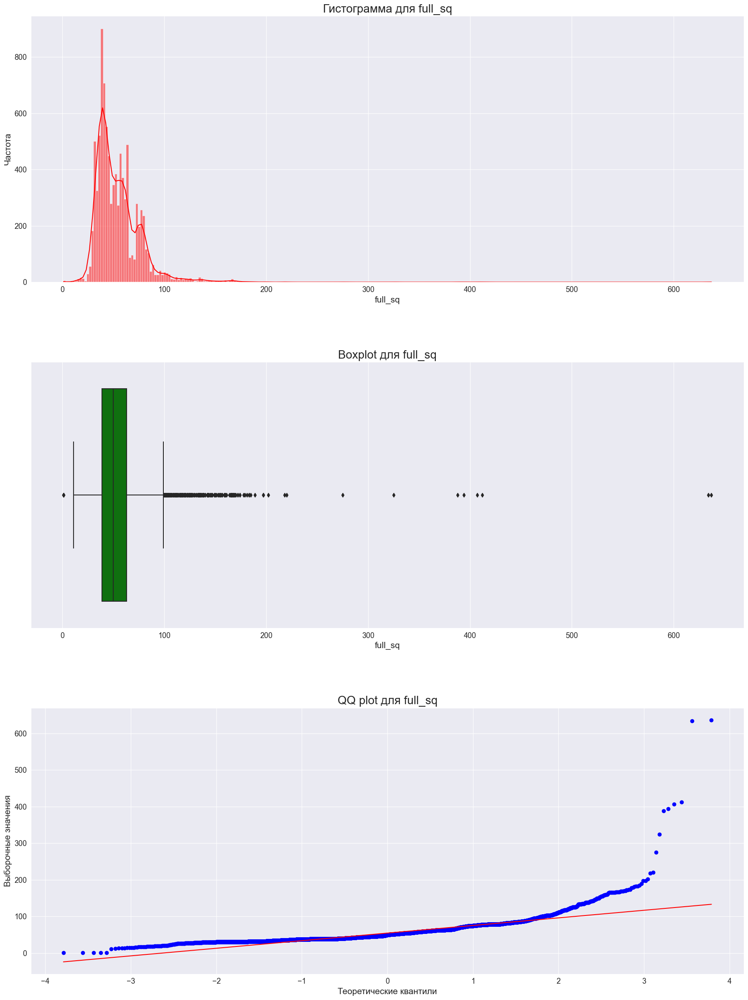


Тест Колмогорова-Смирнова:
Статистика=0.9995, p=0.0000
Отвергаем нулевую гипотезу. Признак full_sq, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean       54.507001
std        24.392465
min         1.000000
25%        39.000000
50%        50.000000
75%        63.000000
max       637.000000
Name: full_sq, dtype: float64


In [84]:
quantitative_feature_analysis_test(df_test, 'full_sq')

1. Не нормальное распределение
2. Значения от 1 до 637
3. Медиана равна 50
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить выбросы на NaN или стастическое значение

## 2) floor

floor: Этаж, на котором расположена квартира. Тип данных: float64

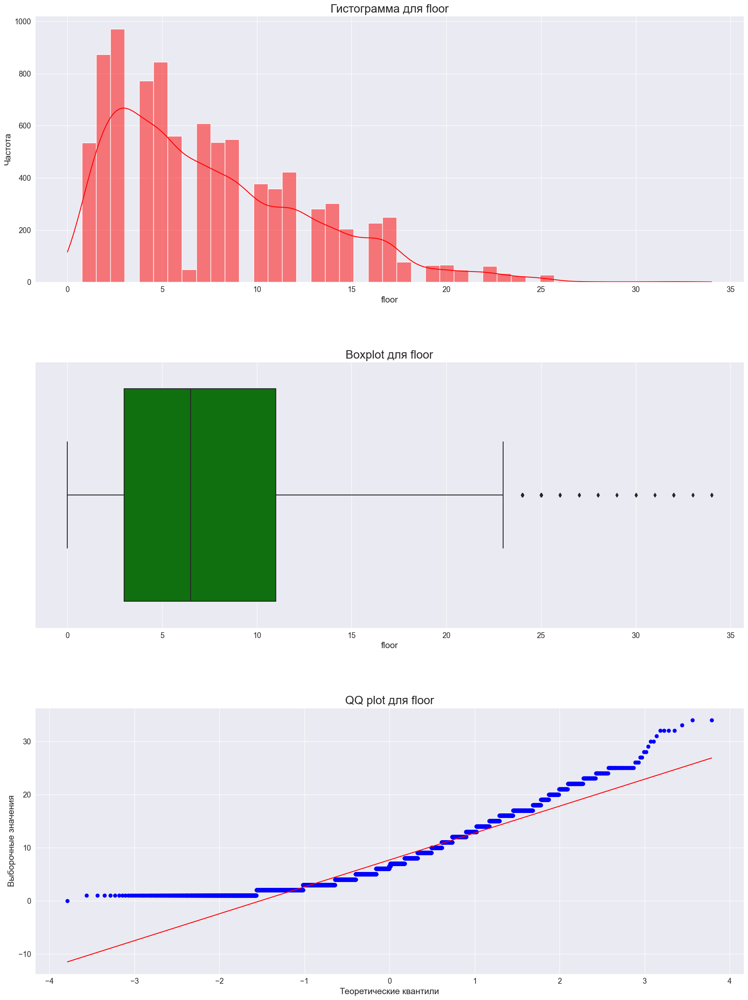


Тест Колмогорова-Смирнова:
Статистика=0.9186, p=0.0000
Отвергаем нулевую гипотезу. Признак floor, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        7.673430
std         5.274204
min         0.000000
25%         3.000000
50%         6.500000
75%        11.000000
max        34.000000
Name: floor, dtype: float64


In [86]:
quantitative_feature_analysis_test(df_test, 'floor')

1. Не нормальное распределение
2. Значения от 0 до 34
3. Медиана равна 6.5

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение

## 3) build_year

build_year: Год постройки здания. Тип данных: float64

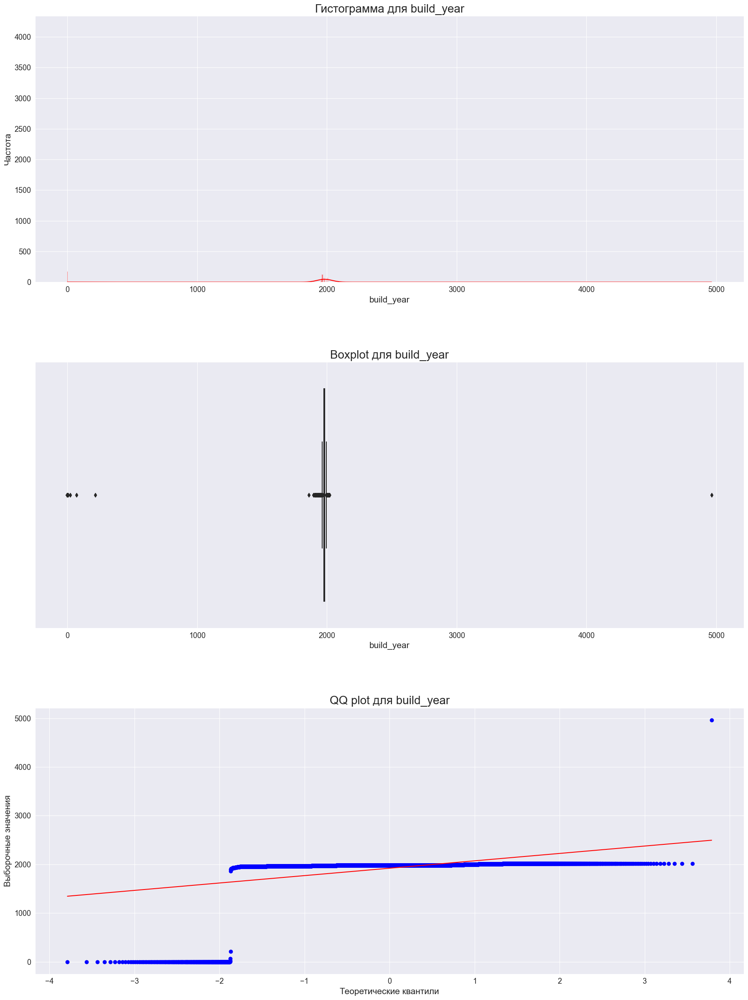


Тест Колмогорова-Смирнова:
Статистика=0.9696, p=0.0000
Отвергаем нулевую гипотезу. Признак build_year, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean     1921.884380
std       343.774812
min         0.000000
25%      1975.000000
50%      1979.000000
75%      1983.000000
max      4965.000000
Name: build_year, dtype: float64


In [87]:
quantitative_feature_analysis_test(df_test, 'build_year')

1. Не нормальное распределение
2. Значения от 0 до 4965
3. Медиана равна 1979
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить значения < 1147 и > 2024  на NaN или стастическое значение

## 4) num_room

num_room: Количество комнат в квартире. Тип данных: float64

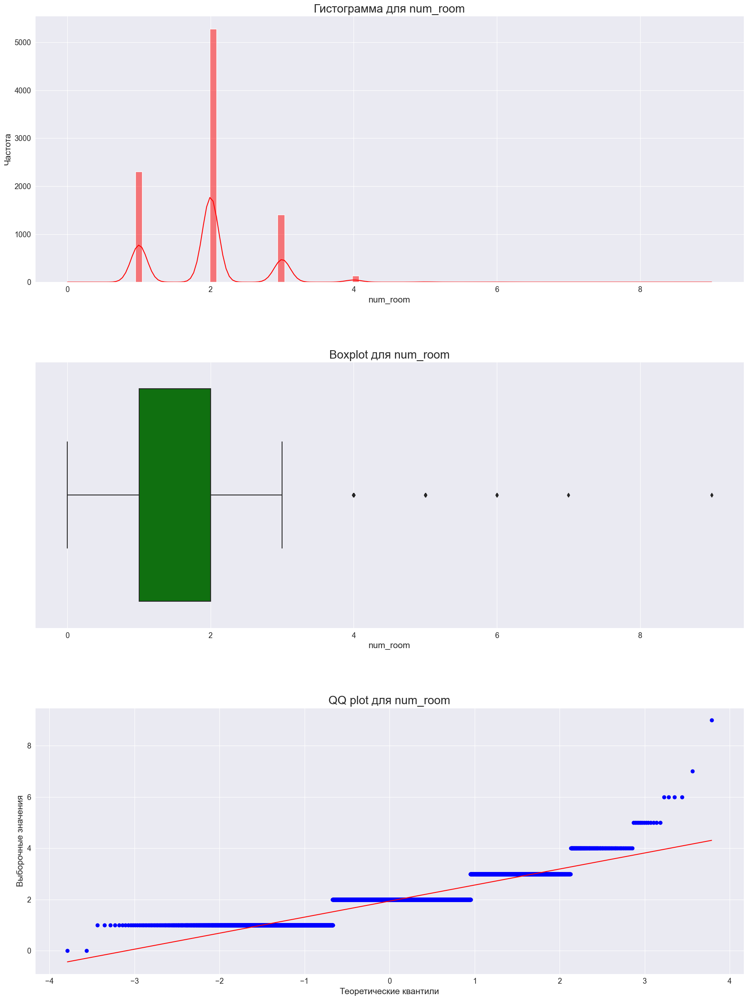


Тест Колмогорова-Смирнова:
Статистика=0.8411, p=0.0000
Отвергаем нулевую гипотезу. Признак num_room, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.937760
std         0.698787
min         0.000000
25%         1.000000
50%         2.000000
75%         2.000000
max         9.000000
Name: num_room, dtype: float64


In [88]:
quantitative_feature_analysis_test(df_test, 'num_room')

1. Не нормальное распределение
2. Значения от 0 до 9
3. Медиана равна 2

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение

## 5) kitch_sq

kitch_sq: Площадь кухни (в квадратных метрах). Тип данных: float64

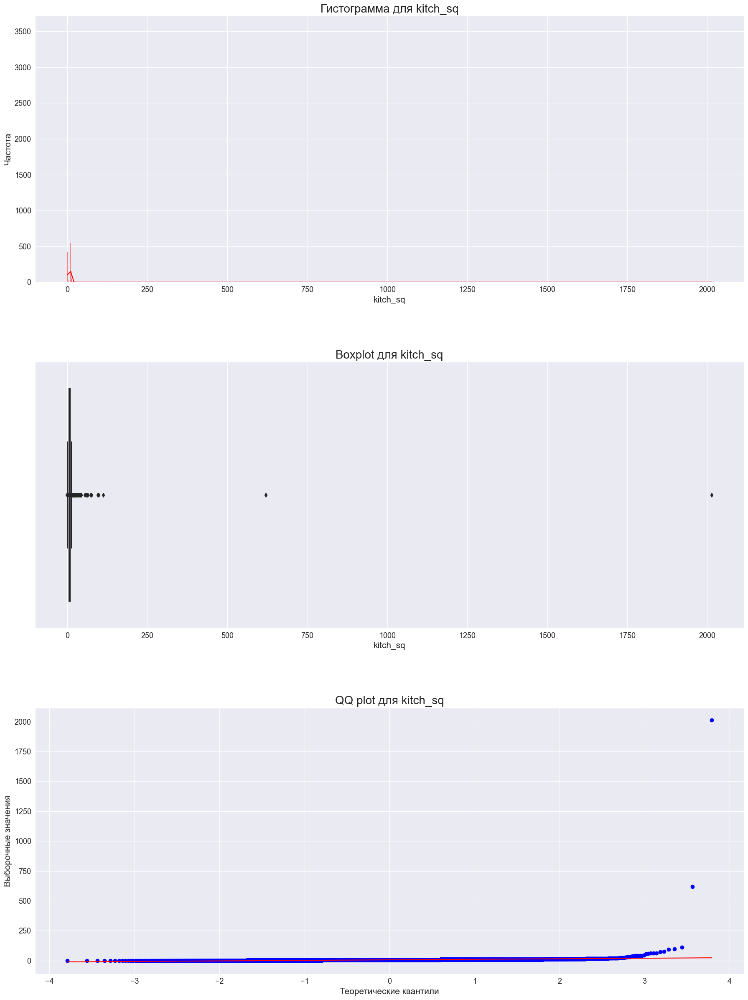


Тест Колмогорова-Смирнова:
Статистика=0.7952, p=0.0000
Отвергаем нулевую гипотезу. Признак kitch_sq, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        6.231131
std        22.355353
min         0.000000
25%         5.000000
50%         6.000000
75%         8.000000
max      2014.000000
Name: kitch_sq, dtype: float64


In [90]:
quantitative_feature_analysis_test(df_test, 'kitch_sq')

1. Не нормальное распределение
2. Значения от 0 до 2014
3. Медиана равна 6
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить значения больше 500 на NaN или стастическое значение

In [19]:
print(f"Общее количество записей с kitch_sq равным 0: {df_test[df_test['kitch_sq'] == 0].shape[0]}")
print(f"Количество записей с num_room равным 1 и kitch_sq равным 0: {df_test[(df_test['num_room'] == 1) & (df_test['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 2 и kitch_sq равным 0: {df_test[(df_test['num_room'] == 2) & (df_test['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 3 и kitch_sq равным 0: {df_test[(df_test['num_room'] == 3) & (df_test['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 4 и kitch_sq равным 0: {df_test[(df_test['num_room'] == 4) & (df_test['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 5 и kitch_sq равным 0: {df_test[(df_test['num_room'] == 5) & (df_test['kitch_sq'] == 0)].shape[0]}")
print(f"Количество записей с num_room равным 6 и kitch_sq равным 0: {df_test[(df_test['num_room'] == 6) & (df_test['kitch_sq'] == 0)].shape[0]}")

Общее количество записей с kitch_sq равным 0: 422
Количество записей с num_room равным 1 и kitch_sq равным 0: 175
Количество записей с num_room равным 2 и kitch_sq равным 0: 153
Количество записей с num_room равным 3 и kitch_sq равным 0: 85
Количество записей с num_room равным 4 и kitch_sq равным 0: 5
Количество записей с num_room равным 5 и kitch_sq равным 0: 2
Количество записей с num_room равным 6 и kitch_sq равным 0: 0


## 6) state

state: Состояние квартиры. Тип данных: float64

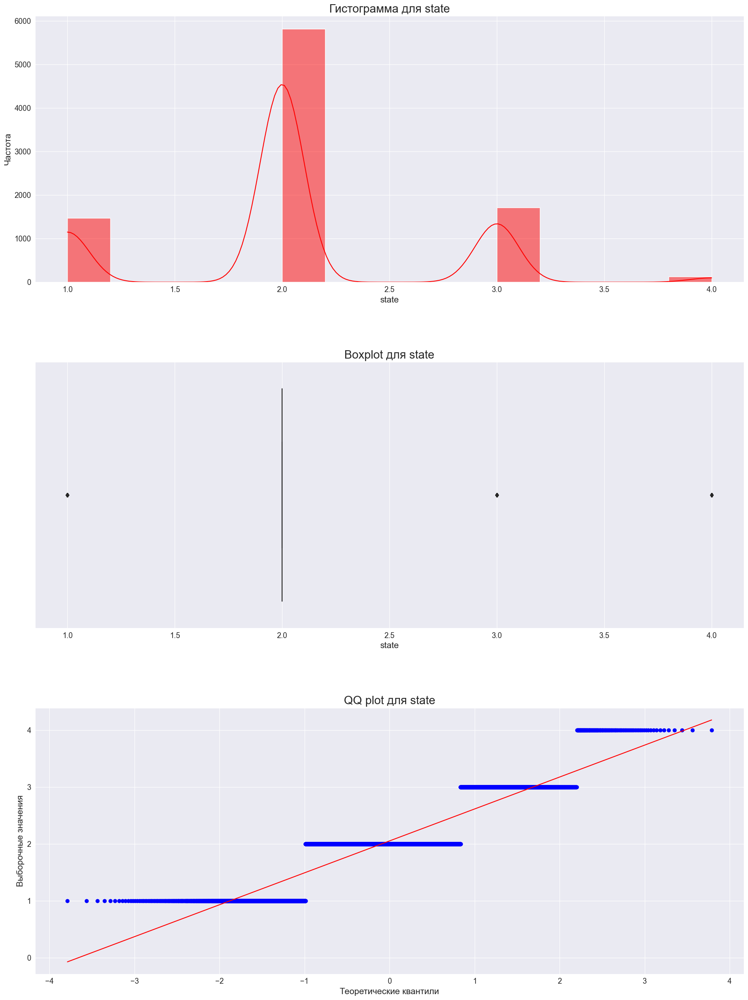


Тест Колмогорова-Смирнова:
Статистика=0.8413, p=0.0000
Отвергаем нулевую гипотезу. Признак state, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.054255
std         0.633725
min         1.000000
25%         2.000000
50%         2.000000
75%         2.000000
max         4.000000
Name: state, dtype: float64


In [89]:
quantitative_feature_analysis_test(df_test, 'state')

1. Не нормальное распределение
2. Значения от 1 до 4
3. Медиана равна 2

## 7) product_type

product_type: Тип недвижимости. Тип данных: bool

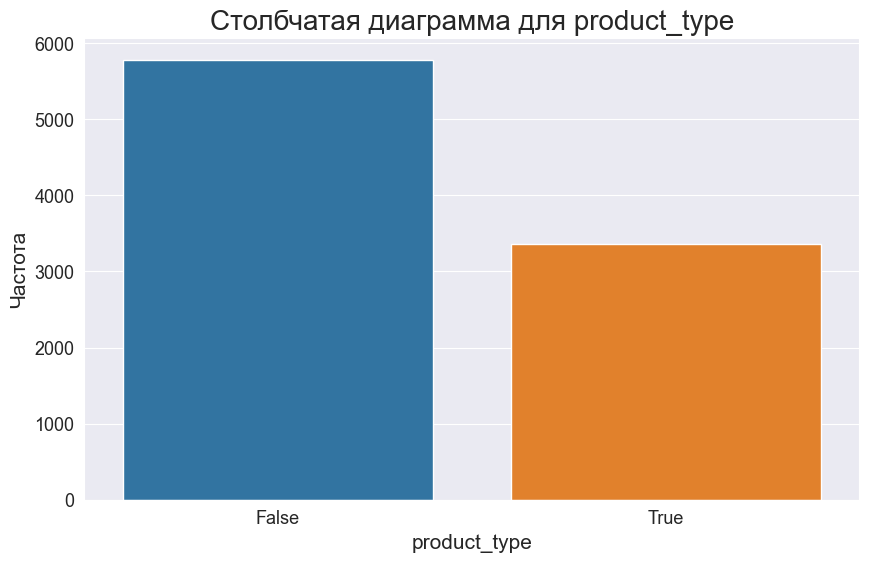

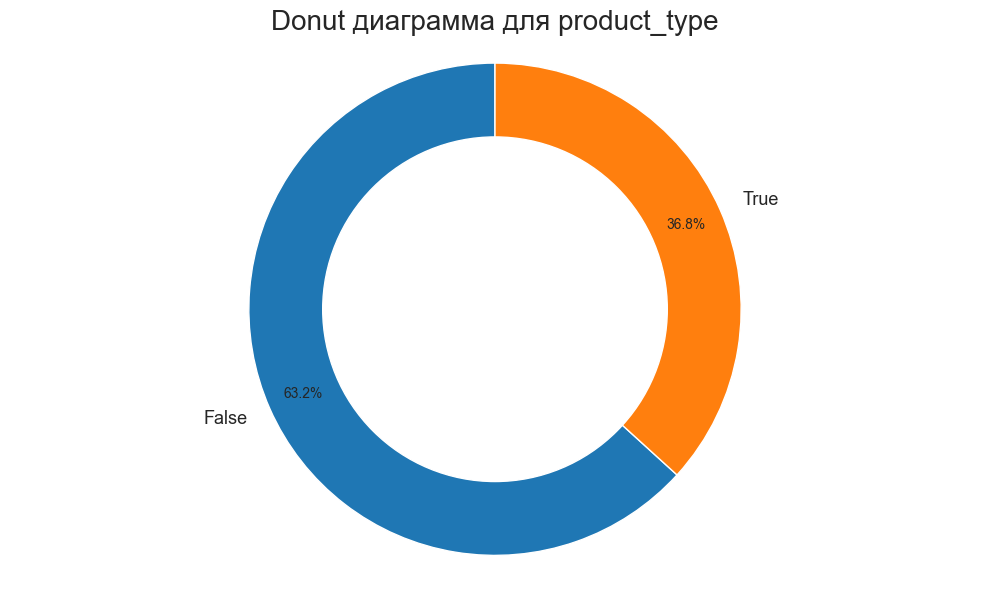


Описательная статистика:
count      9142
unique        2
top       False
freq       5782
Name: product_type, dtype: object


In [95]:
binary_feature_analysis_test(df_test, 'product_type')

1. Не равномерное распределение
2. Больше всего в количестве False

## 8) raion_popul

raion_popul: Население района. Тип данных: float64

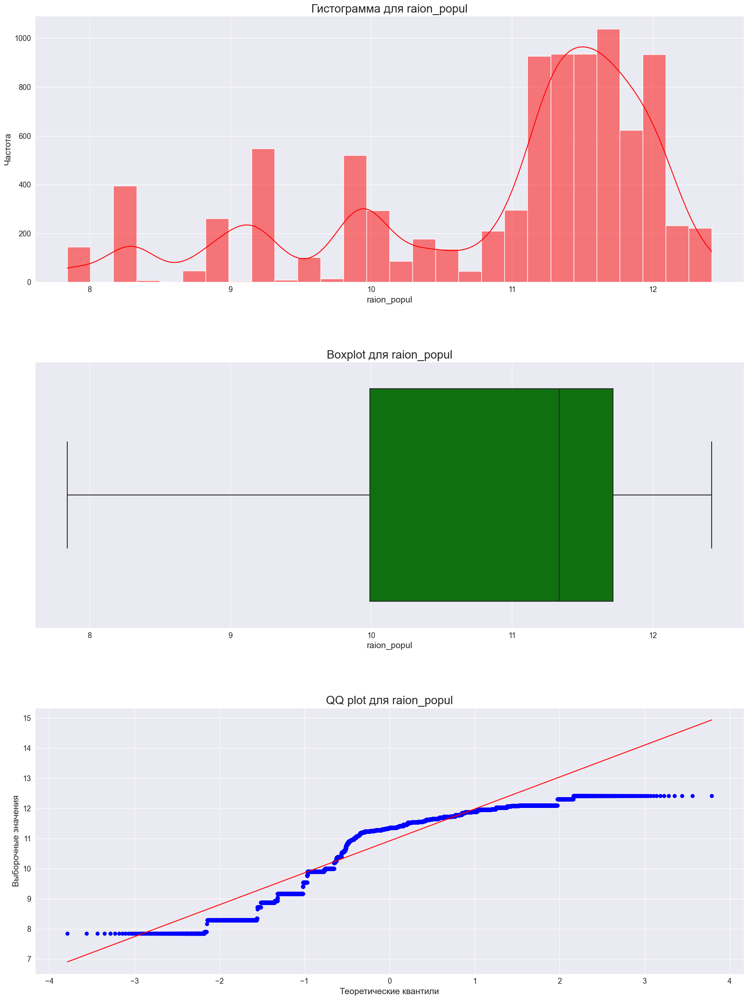


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак raion_popul, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean       10.916803
std         1.143172
min         7.842279
25%         9.990536
50%        11.336713
75%        11.719940
max        12.419041
Name: raion_popul, dtype: float64


In [96]:
quantitative_feature_analysis_test(df_test, 'raion_popul')

1. Не нормальное распределение
2. Значения от 7.842279 до 12.419041
3. Медиана равна 11.336713

## 9) indust_part

indust_part: Промышленная часть района. Тип данных: float64

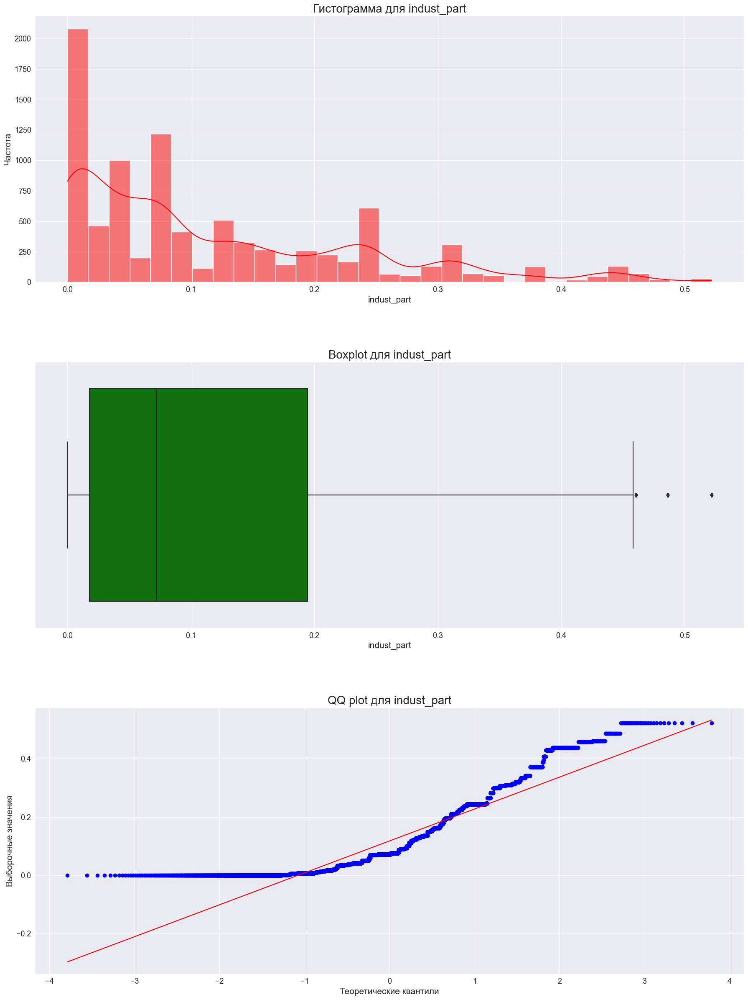


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак indust_part, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        0.117859
std         0.117517
min         0.000000
25%         0.017647
50%         0.072158
75%         0.194489
max         0.521867
Name: indust_part, dtype: float64


In [97]:
quantitative_feature_analysis_test(df_test, 'indust_part')

1. Не нормальное распределение
2. Значения от 0 до 0.521867
3. Медиана равна 0.072158
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить выбросы на NaN или стастическое значение

## 10) sport_objects_raion

sport_objects_raion: Количество спортивных объектов в районе. Тип данных: int64

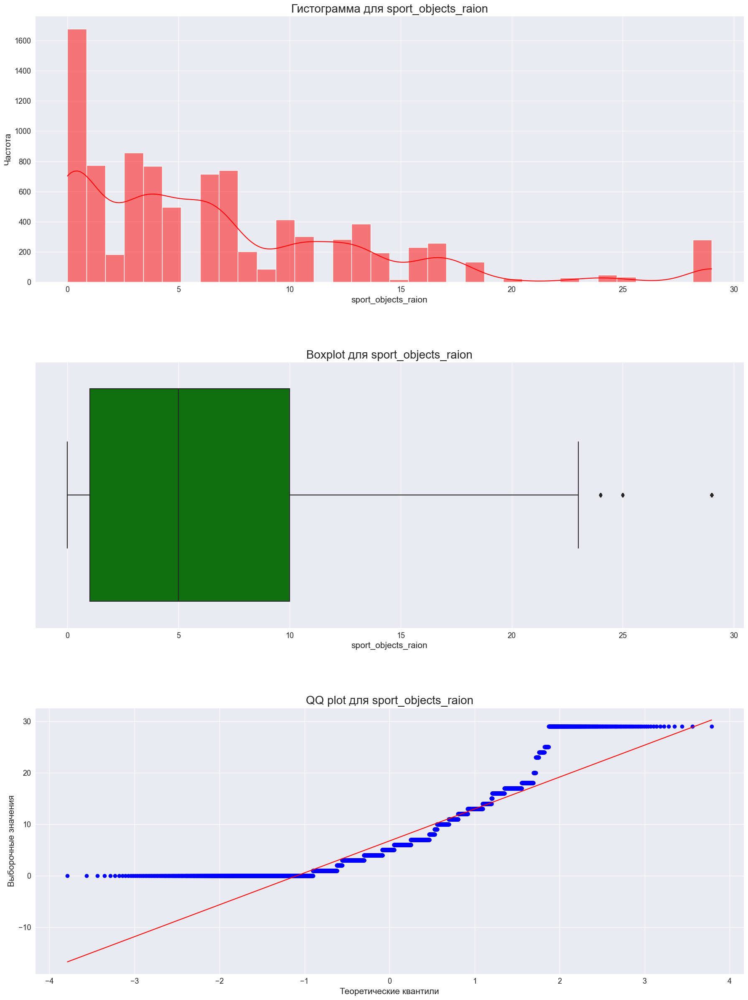


Тест Колмогорова-Смирнова:
Статистика=0.7103, p=0.0000
Отвергаем нулевую гипотезу. Признак sport_objects_raion, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        6.759024
std         6.703401
min         0.000000
25%         1.000000
50%         5.000000
75%        10.000000
max        29.000000
Name: sport_objects_raion, dtype: float64


In [98]:
quantitative_feature_analysis_test(df_test, 'sport_objects_raion')

1. Не нормальное распределение
2. Значения от 0 до 29
3. Медиана равна 5
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить выбросы на NaN или стастическое значение

## 11) shopping_centers_raion

shopping_centers_raion: Количество торговых центров в районе. Тип данных: int64

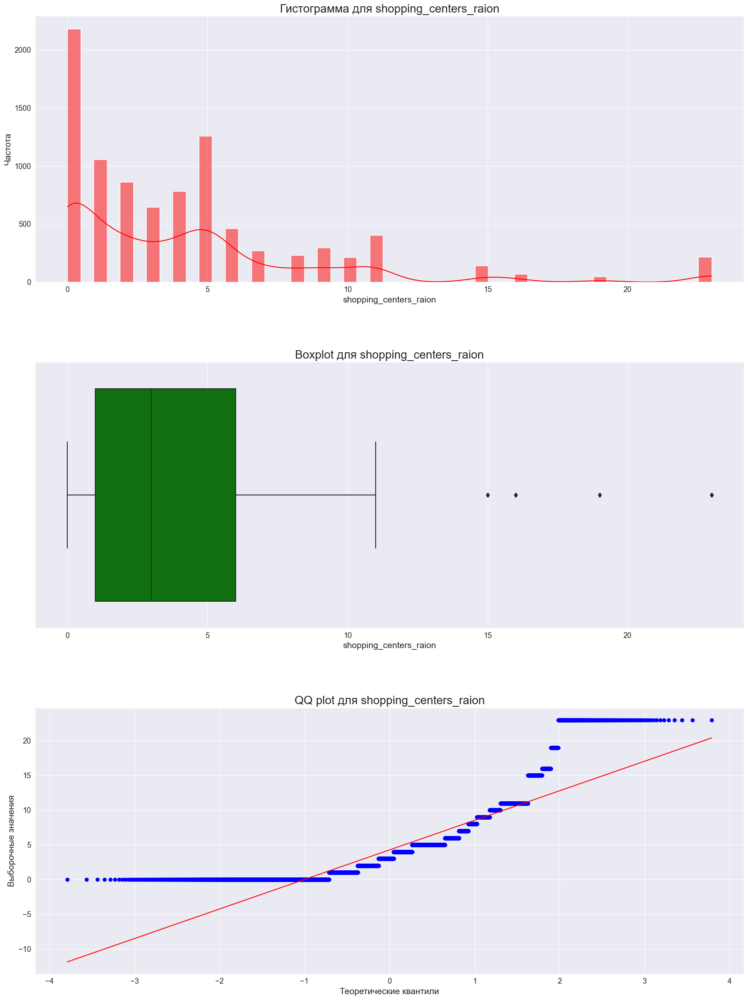


Тест Колмогорова-Смирнова:
Статистика=0.6232, p=0.0000
Отвергаем нулевую гипотезу. Признак shopping_centers_raion, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        4.268978
std         4.767033
min         0.000000
25%         1.000000
50%         3.000000
75%         6.000000
max        23.000000
Name: shopping_centers_raion, dtype: float64


In [99]:
quantitative_feature_analysis_test(df_test, 'shopping_centers_raion')

1. Не нормальное распределение
2. Значения от 0 до 23
3. Медиана равна 3
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить выбросы на NaN или стастическое значение

## 12) radiation_raion

radiation_raion: Наличие радиационных объектов в районе. Тип данных: bool

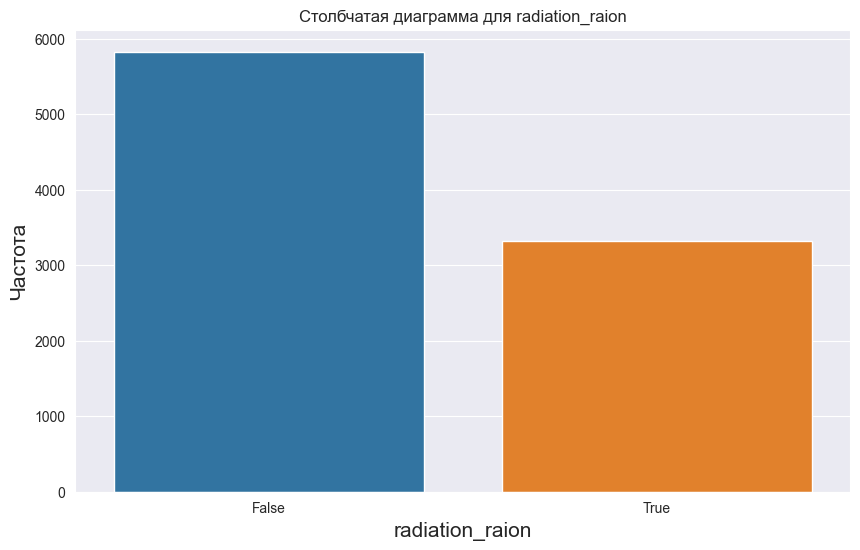

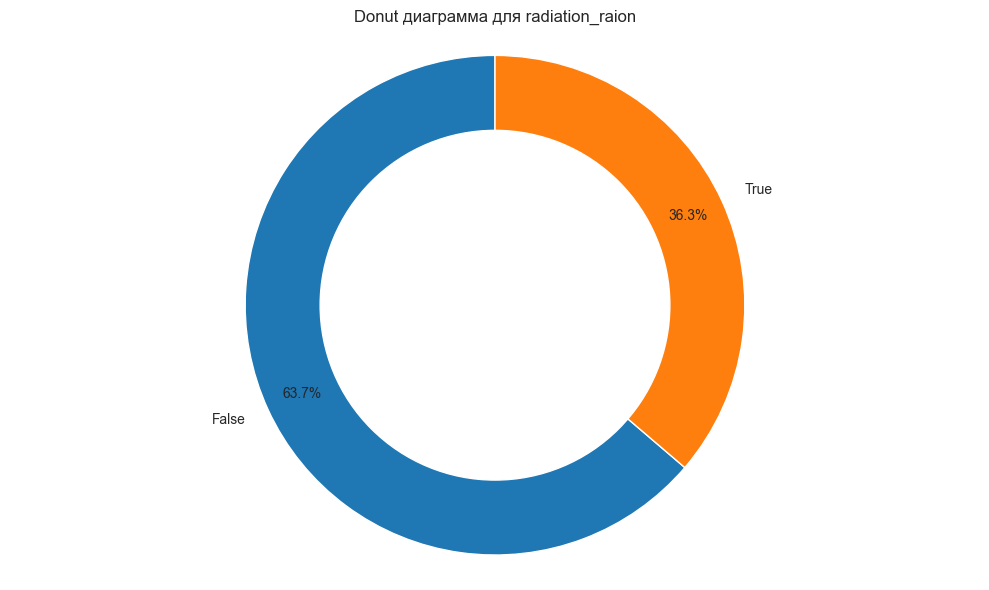


Описательная статистика:
count      9142
unique        2
top       False
freq       5827
Name: radiation_raion, dtype: object


In [18]:
binary_feature_analysis_test(df_test, 'radiation_raion')

1. Не равномерное распределение
2. Больше всего в количестве False

## 13) build_count_block

build_count_block: Количество зданий блочного типа. Тип данных: float64

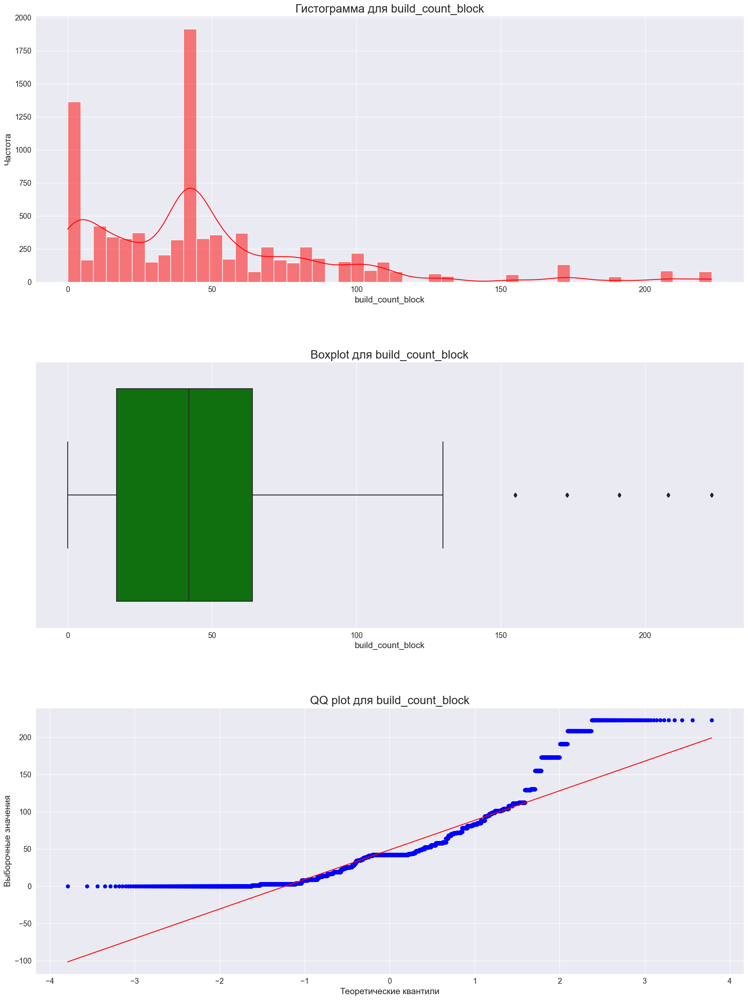


Тест Колмогорова-Смирнова:
Статистика=0.9351, p=0.0000
Отвергаем нулевую гипотезу. Признак build_count_block, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean       48.705972
std        43.034709
min         0.000000
25%        17.000000
50%        42.000000
75%        64.000000
max       223.000000
Name: build_count_block, dtype: float64


In [101]:
quantitative_feature_analysis_test(df_test, 'build_count_block')

1. Не нормальное распределение
2. Значения от 0 до 223
3. Медиана равна 42
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить выбросы на NaN или стастическое значение

## 14) build_count_brick

build_count_brick: Количество кирпичных зданий. Тип данных: float64

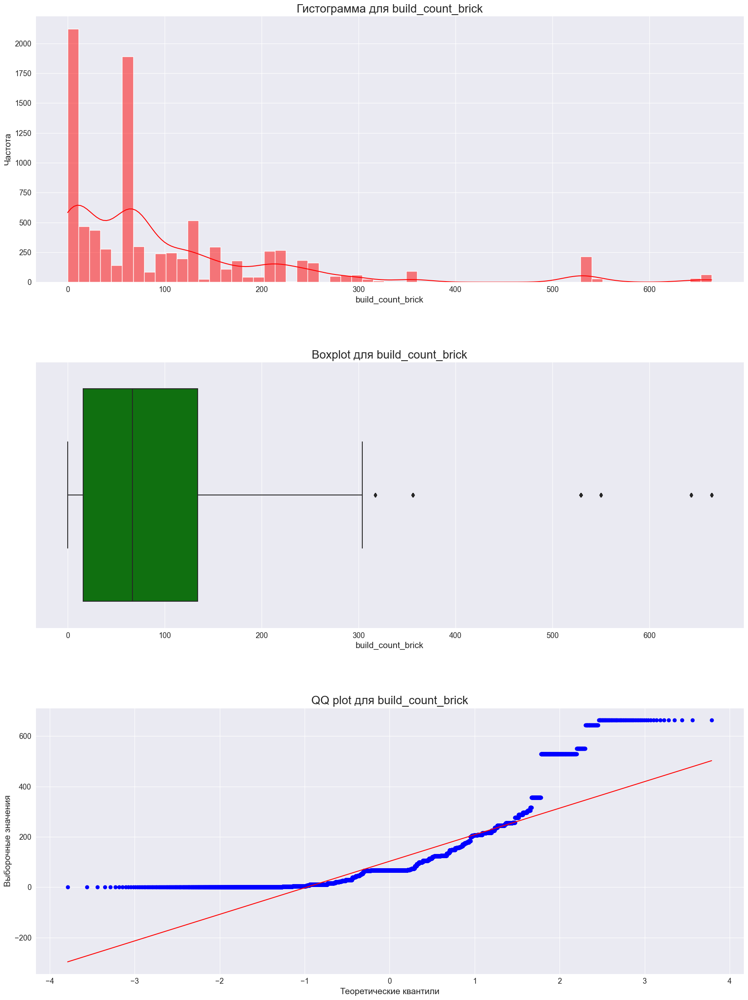


Тест Колмогорова-Смирнова:
Статистика=0.8766, p=0.0000
Отвергаем нулевую гипотезу. Признак build_count_brick, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean      102.909648
std       122.019804
min         0.000000
25%        16.000000
50%        67.000000
75%       134.000000
max       664.000000
Name: build_count_brick, dtype: float64


In [102]:
quantitative_feature_analysis_test(df_test, 'build_count_brick')

1. Не нормальное распределение
2. Значения от 1 до 637
3. Медиана равна 50
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить выбросы на NaN или стастическое значение

## 15) build_count_monolith

build_count_monolith: Количество монолитных зданий. Тип данных: float64

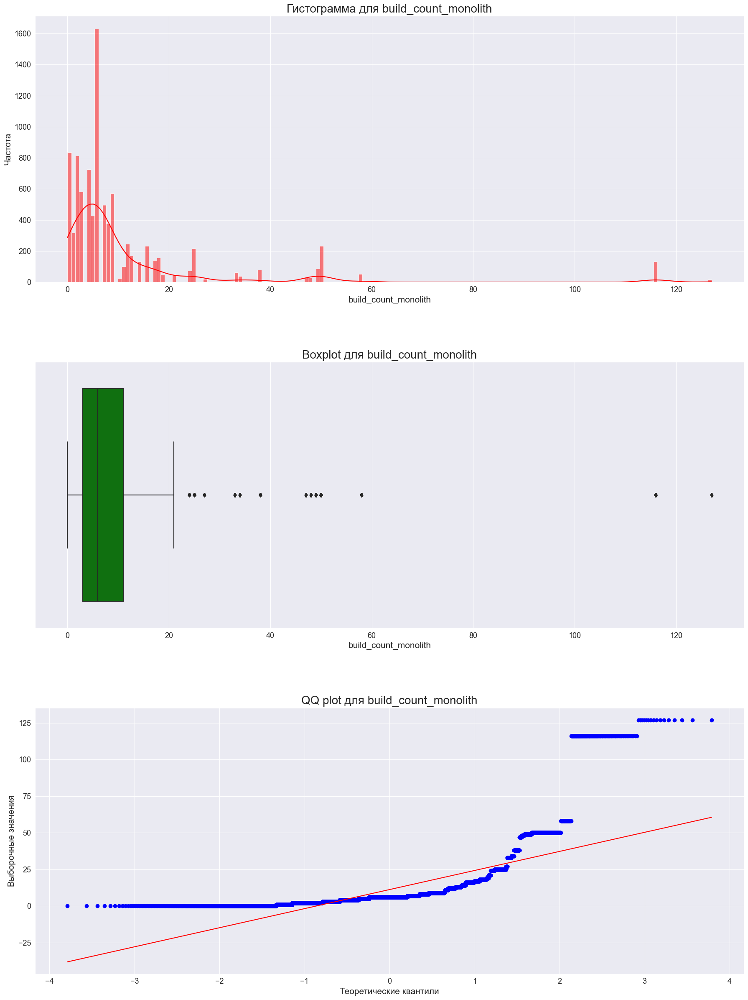


Тест Колмогорова-Смирнова:
Статистика=0.8511, p=0.0000
Отвергаем нулевую гипотезу. Признак build_count_monolith, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean       11.219755
std        17.778677
min         0.000000
25%         3.000000
50%         6.000000
75%        11.000000
max       127.000000
Name: build_count_monolith, dtype: float64


In [103]:
quantitative_feature_analysis_test(df_test, 'build_count_monolith')

1. Не нормальное распределение
2. Значения от 0 до 127
3. Медиана равна 6
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить выбросы на NaN или стастическое значение

## 16) metro_min_avto

metro_min_avto: Время до ближайшей станции метро на автомобиле (в минутах). Тип данных: float64

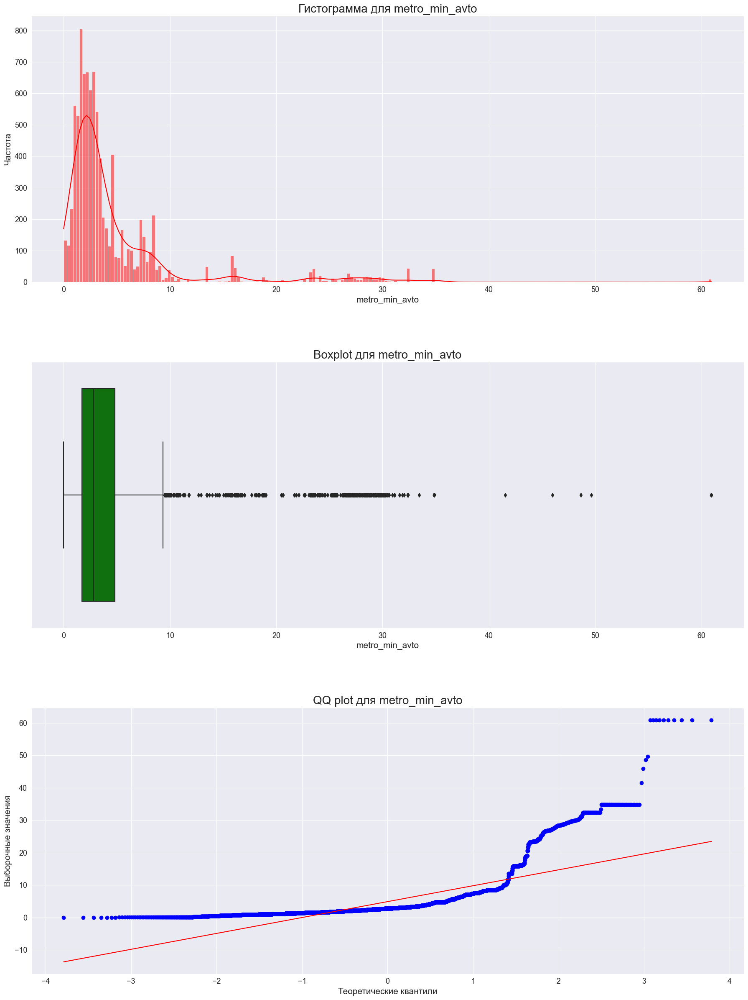


Тест Колмогорова-Смирнова:
Статистика=0.7695, p=0.0000
Отвергаем нулевую гипотезу. Признак metro_min_avto, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        4.889851
std         6.423226
min         0.000000
25%         1.721316
50%         2.800657
75%         4.824991
max        60.941737
Name: metro_min_avto, dtype: float64


In [104]:
quantitative_feature_analysis_test(df_test, 'metro_min_avto')

1. Не нормальное распределение
2. Значения от 0 до 60.941737
3. Медиана равна 2.800657
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение
2. Заменить выбросы на NaN или стастическое значение

## 17) school_km

school_km: Расстояние до ближайшей школы (в километрах). Тип данных: float64

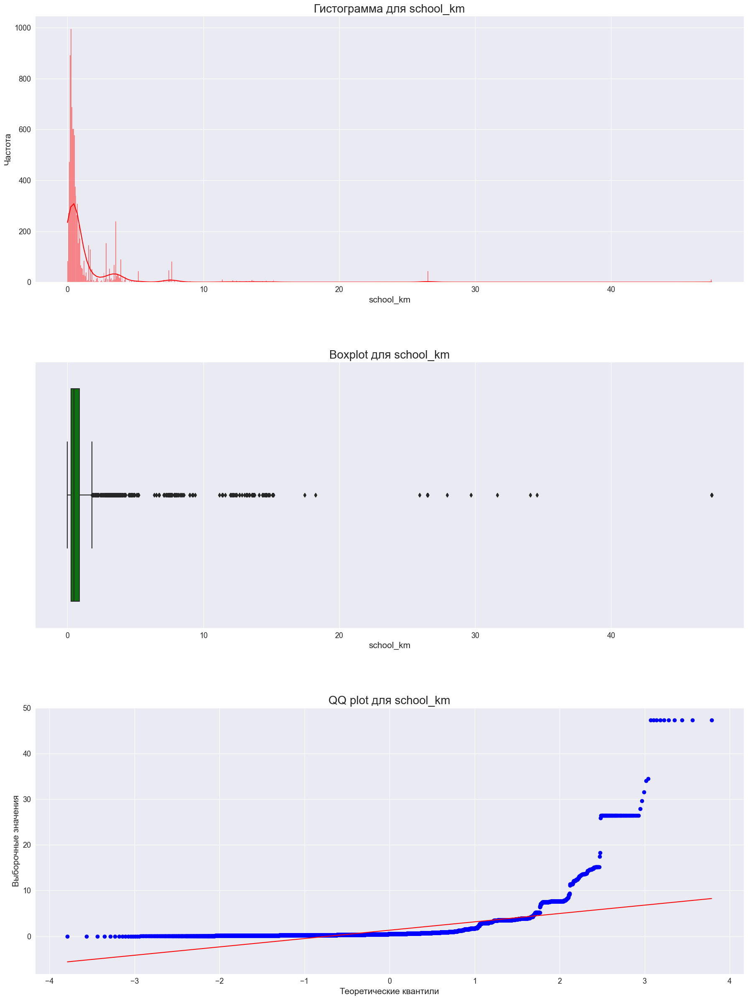


Тест Колмогорова-Смирнова:
Статистика=0.5188, p=0.0000
Отвергаем нулевую гипотезу. Признак school_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.315053
std         3.096861
min         0.000000
25%         0.269716
50%         0.466223
75%         0.885490
max        47.394706
Name: school_km, dtype: float64


In [105]:
quantitative_feature_analysis_test(df_test, 'school_km')

1. Не нормальное распределение
2. Значения от 0 до 47.394706
3. Медиана равна 0.466223
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение
2. Заменить выбросы на NaN или стастическое значение

## 18) green_zone_km

green_zone_km: Расстояние до ближайшей зеленой зоны (в километрах). Тип данных: float64

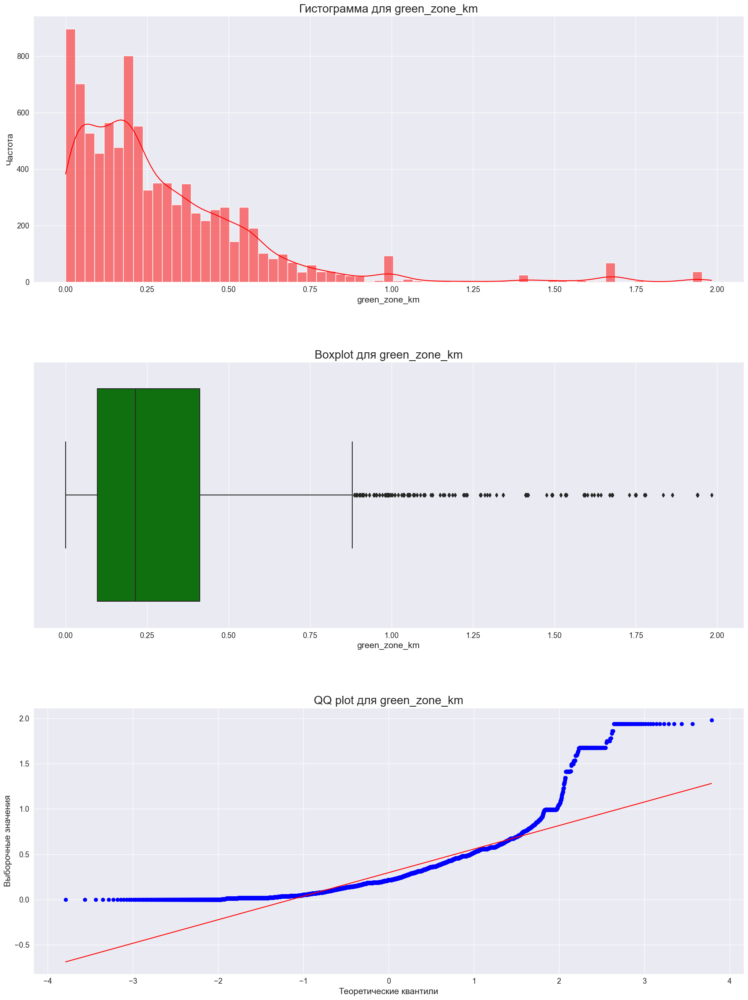


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак green_zone_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        0.296206
std         0.293810
min         0.000000
25%         0.097727
50%         0.214336
75%         0.411440
max         1.982448
Name: green_zone_km, dtype: float64


In [107]:
quantitative_feature_analysis_test(df_test, 'green_zone_km')

1. Не нормальное распределение
2. Значения от 0 до 1.982448
3. Медиана равна 0.214336
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение
2. Заменить выбросы на NaN или стастическое значение

## 19) industrial_km

industrial_km: Расстояние до ближайшей промышленной зоны (в километрах). Тип данных: float64

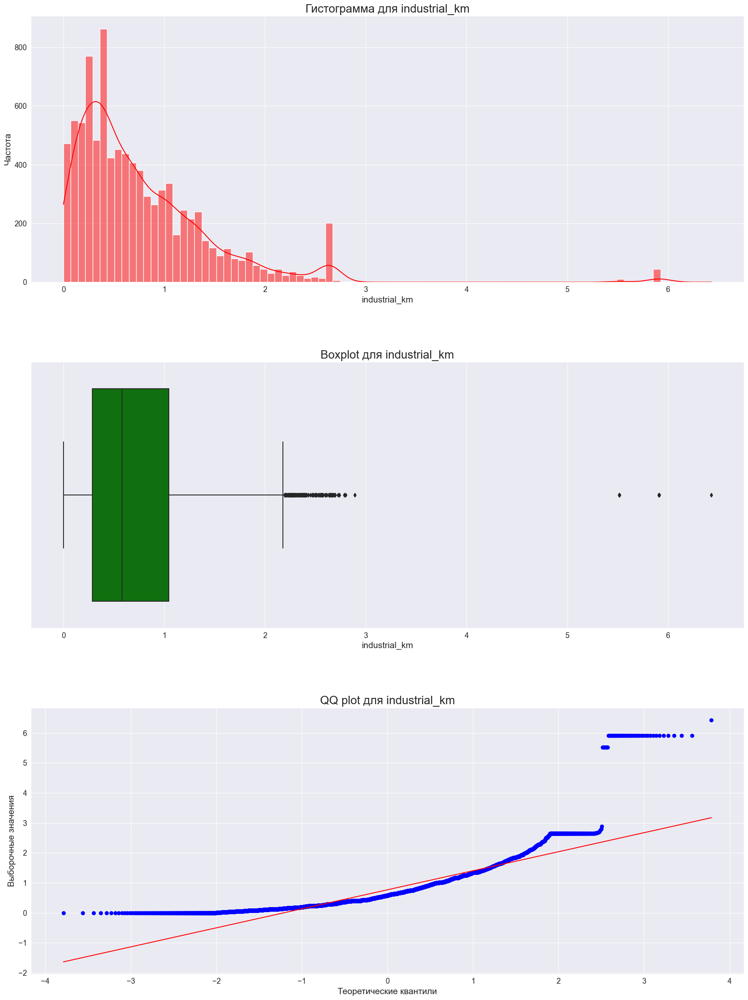


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак industrial_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        0.769600
std         0.717365
min         0.000000
25%         0.288225
50%         0.581633
75%         1.043829
max         6.430456
Name: industrial_km, dtype: float64


In [108]:
quantitative_feature_analysis_test(df_test, 'industrial_km')

1. Не нормальное распределение
2. Значения от 0 до 6.430456
3. Медиана равна 0.581633
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение
2. Заменить выбросы на NaN или стастическое значение

## 20) water_treatment_km

water_treatment_km: Расстояние до ближайшего очистного сооружения (в километрах). Тип данных: float64

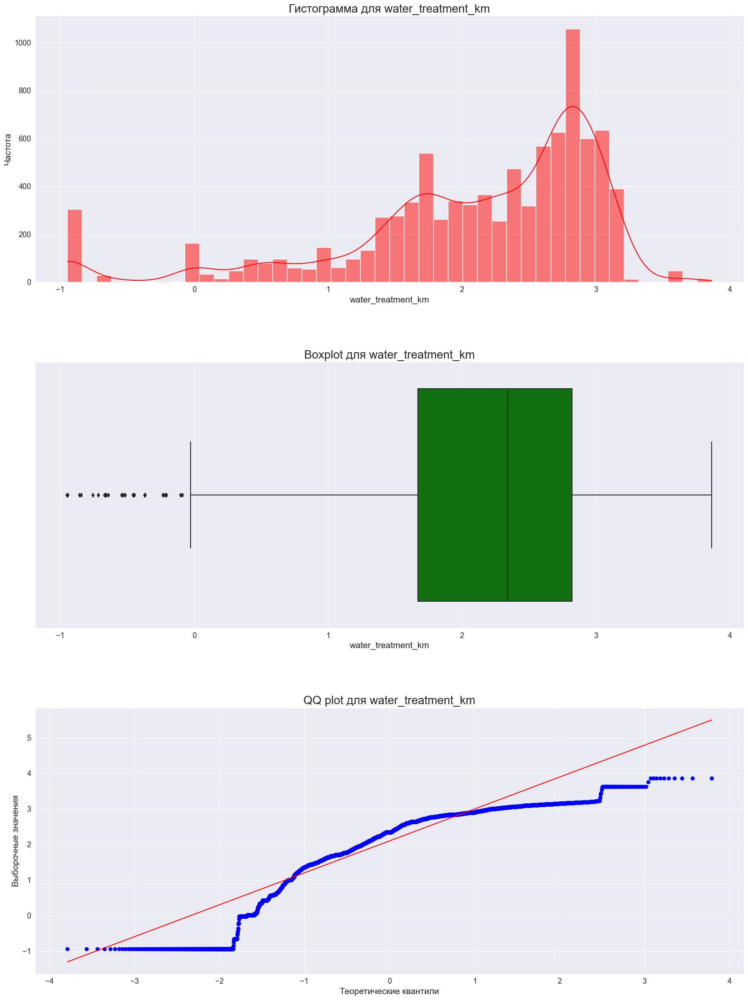


Тест Колмогорова-Смирнова:
Статистика=0.7552, p=0.0000
Отвергаем нулевую гипотезу. Признак water_treatment_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.097006
std         0.964735
min        -0.947325
25%         1.668567
50%         2.339692
75%         2.820865
max         3.862649
Name: water_treatment_km, dtype: float64


In [109]:
quantitative_feature_analysis_test(df_test, 'water_treatment_km')

1. Не нормальное распределение
2. Значения от -0.947325 до 3.862649
3. Медиана равна 2.339692
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение
2. Заменить значения меньше 0 на NaN или стастическое значение

## 21) cemetery_km

cemetery_km: Расстояние до ближайшего кладбища (в километрах). Тип данных: float64

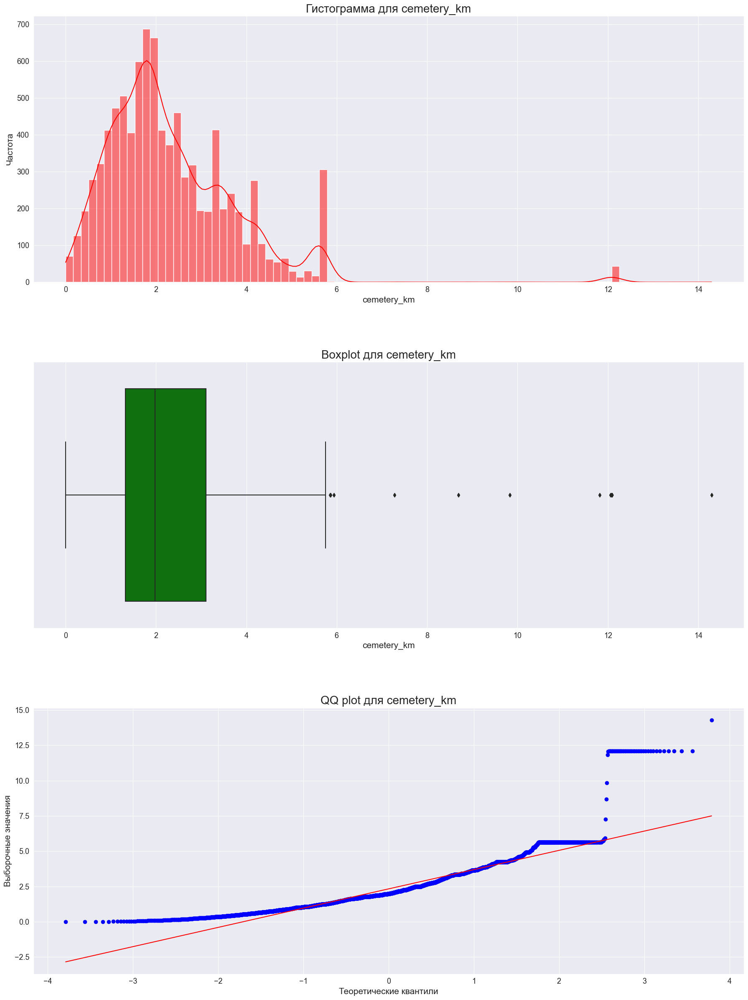


Тест Колмогорова-Смирнова:
Статистика=0.7015, p=0.0000
Отвергаем нулевую гипотезу. Признак cemetery_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.326413
std         1.463715
min         0.000000
25%         1.321237
50%         1.982601
75%         3.108333
max        14.295050
Name: cemetery_km, dtype: float64


In [110]:
quantitative_feature_analysis_test(df_test, 'cemetery_km')

1. Не нормальное распределение
2. Значения от 0 до 14.295050
3. Медиана равна 1.982601
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение
2. Заменить выбросы на NaN или стастическое значение

## 22) incineration_km

incineration_km: Расстояние до ближайшего мусоросжигательного завода (в километрах). Тип данных: float64

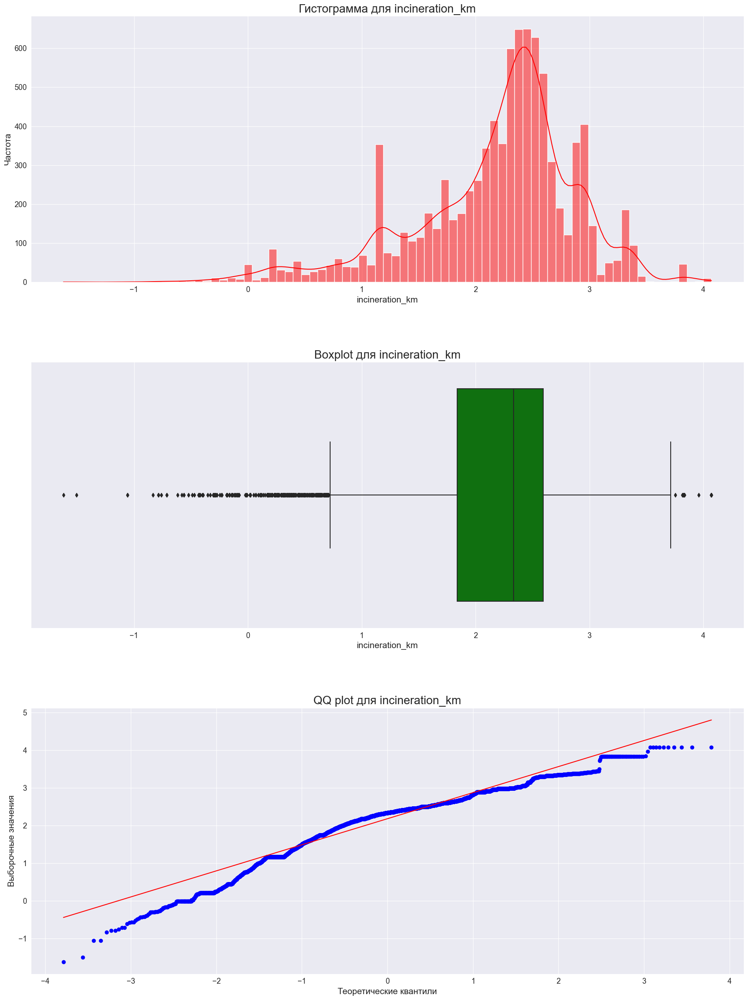


Тест Колмогорова-Смирнова:
Статистика=0.7983, p=0.0000
Отвергаем нулевую гипотезу. Признак incineration_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.178617
std         0.712604
min        -1.619130
25%         1.840116
50%         2.335101
75%         2.594017
max         4.071281
Name: incineration_km, dtype: float64


In [111]:
quantitative_feature_analysis_test(df_test, 'incineration_km')

1. Не нормальное распределение
2. Значения от  -1.619130 до 4.071281
3. Медиана равна 2.335101
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 23) ID_railroad_station_avto

ID_railroad_station_avto: Идентификатор ближайшей железнодорожной станции. Тип данных: category

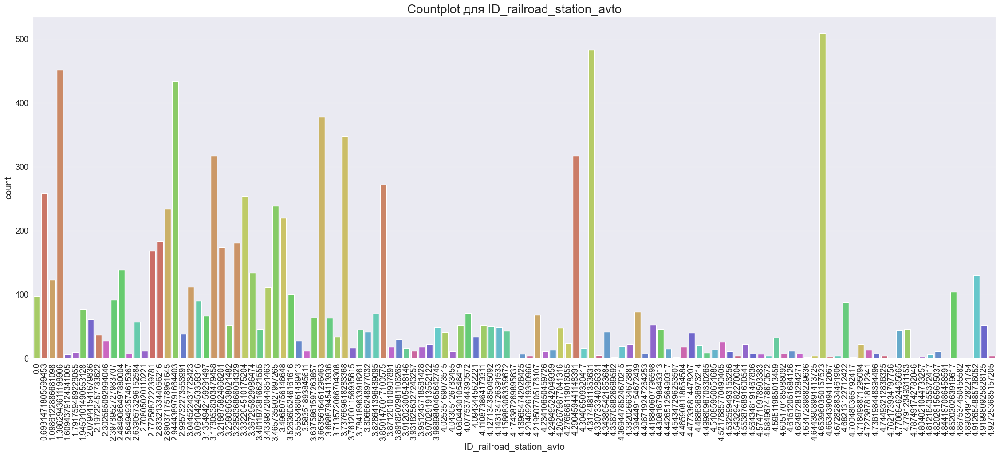

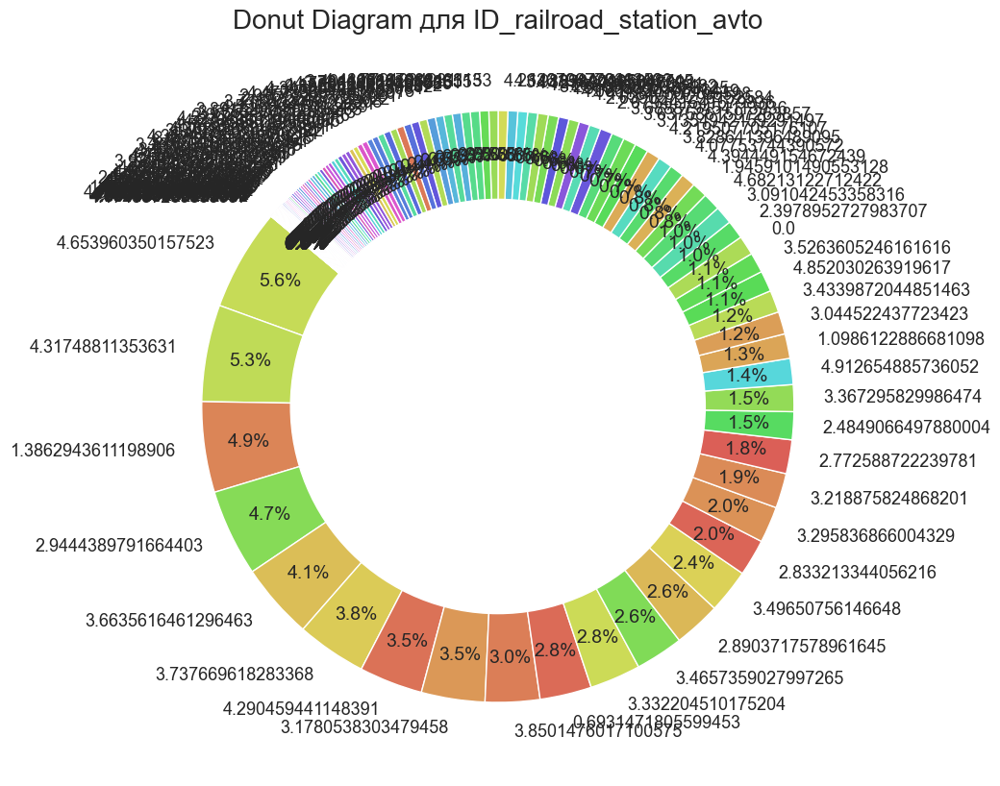

In [113]:
category_feature_analysis_test(df_test, 'ID_railroad_station_avto')

In [147]:
train_unique_values = df_train['ID_railroad_station_avto'].unique()
test_unique_values = df_test['ID_railroad_station_avto'].unique()

different_values_in_test = set(test_unique_values) - set(train_unique_values)
different_values_in_train = set(train_unique_values) - set(test_unique_values)

print("Значения, присутствующие в тестовом наборе, но отсутствующие в обучающем наборе:", different_values_in_test)
print("Значения, присутствующие в обучающем наборе, но отсутствующие в тестовом наборе:", different_values_in_train)

Значения, присутствующие в тестовом наборе, но отсутствующие в обучающем наборе: {4.890349128221754, 4.844187086458591, 4.867534450455582}
Значения, присутствующие в обучающем наборе, но отсутствующие в тестовом наборе: {4.859812404361672, 4.795790545596741, 4.836281906951478, 4.875197323201151, 4.709530201312334, 4.882801922586371, 4.8283137373023015, 4.691347882229144}


## 24) mkad_km

mkad_km: Расстояние до МКАД (Московская кольцевая автодорога) в километрах. Тип данных: float64

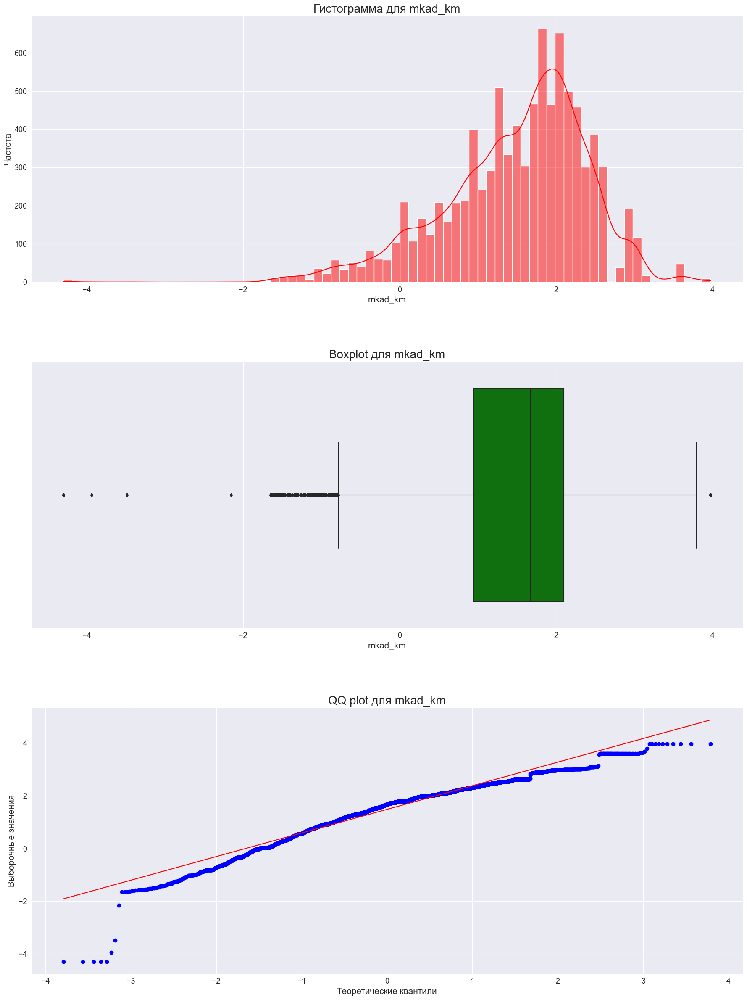


Тест Колмогорова-Смирнова:
Статистика=0.5939, p=0.0000
Отвергаем нулевую гипотезу. Признак mkad_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.485865
std         0.913975
min        -4.295762
25%         0.948067
50%         1.674713
75%         2.102273
max         3.975520
Name: mkad_km, dtype: float64


In [114]:
quantitative_feature_analysis_test(df_test, 'mkad_km')

1. Не нормальное распределение
2. Значения от -4.295762 до 3.975520
3. Медиана равна 1.674713
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 25) ttk_km

ttk_km: Расстояние до ТТК (Третье транспортное кольцо) в километрах. Тип данных: float64

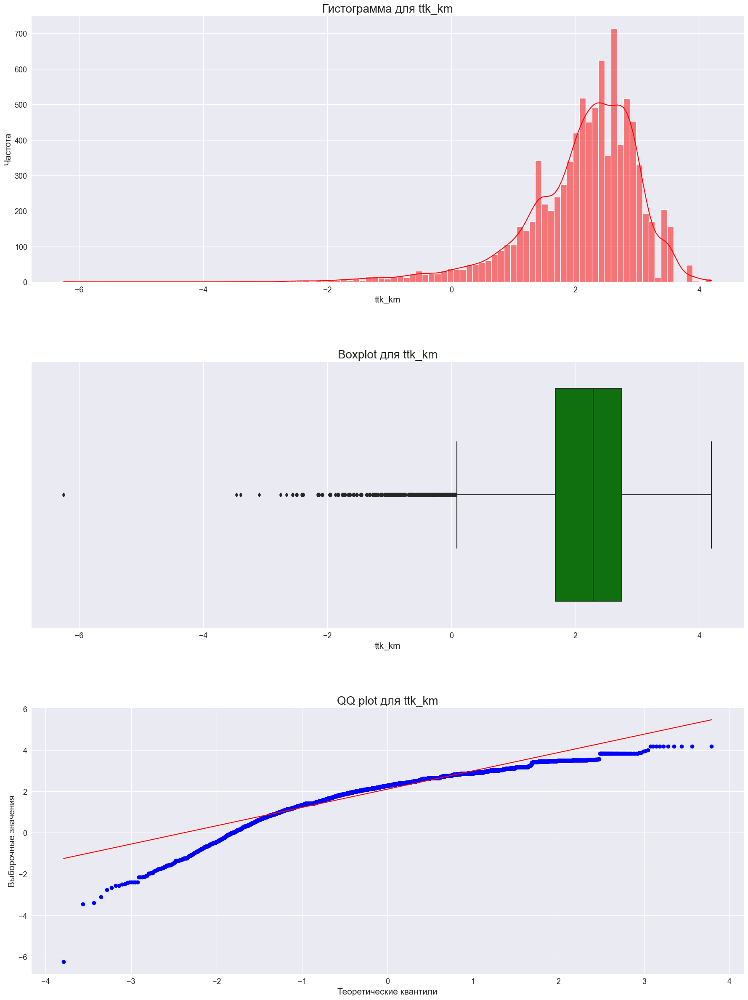


Тест Колмогорова-Смирнова:
Статистика=0.7550, p=0.0000
Отвергаем нулевую гипотезу. Признак ttk_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.110097
std         0.928787
min        -6.247775
25%         1.676444
50%         2.284296
75%         2.743927
max         4.190158
Name: ttk_km, dtype: float64


In [115]:
quantitative_feature_analysis_test(df_test, 'ttk_km')

1. Не нормальное распределение
2. Значения от -6.247775 до 4.190158
3. Медиана равна 2.284296
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 26) oil_chemistry_km

oil_chemistry_km: Расстояние до ближайшего нефтехимического предприятия (в километрах). Тип данных: float64

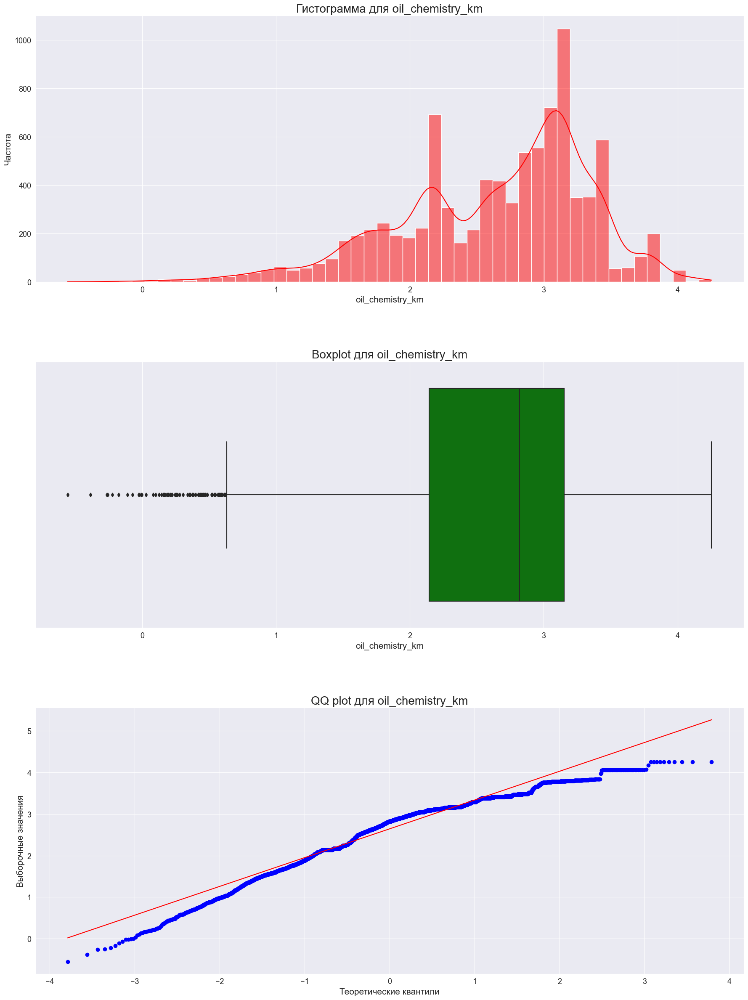


Тест Колмогорова-Смирнова:
Статистика=0.8681, p=0.0000
Отвергаем нулевую гипотезу. Признак oil_chemistry_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.642155
std         0.707903
min        -0.556621
25%         2.143169
50%         2.819273
75%         3.153783
max         4.254384
Name: oil_chemistry_km, dtype: float64


In [116]:
quantitative_feature_analysis_test(df_test, 'oil_chemistry_km')

1. Не нормальное распределение
2. Значения от -0.556621 до 4.254384
3. Медиана равна 2.819273
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 27) nuclear_reactor_km

nuclear_reactor_km: Расстояние до ближайшего ядерного реактора (в километрах). Тип данных: float64

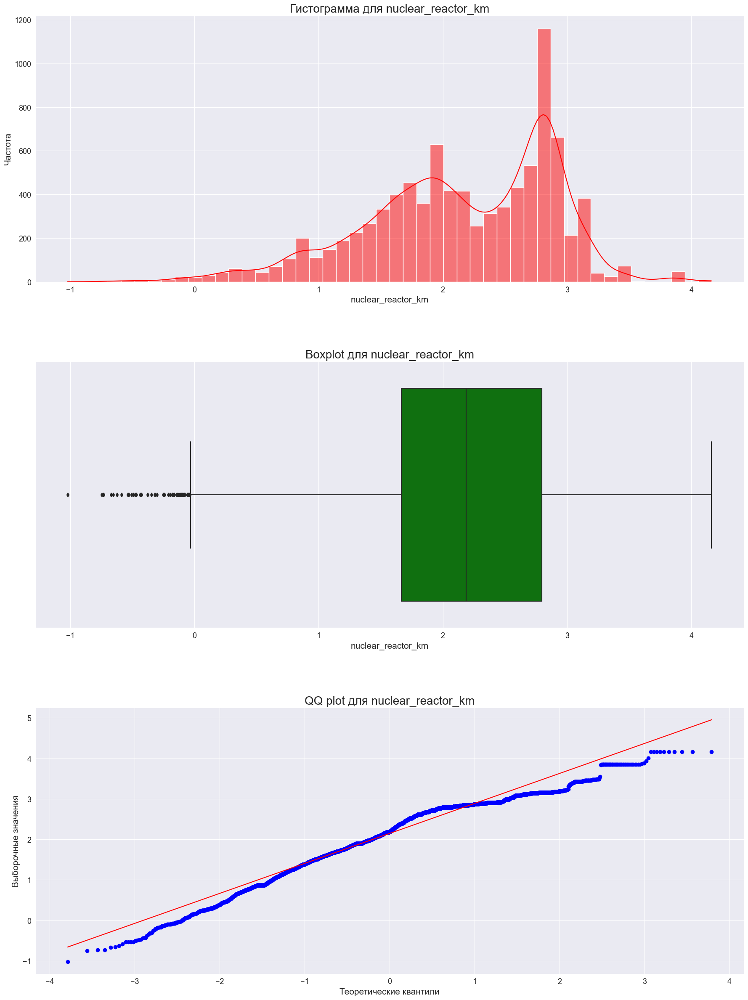


Тест Колмогорова-Смирнова:
Статистика=0.7718, p=0.0000
Отвергаем нулевую гипотезу. Признак nuclear_reactor_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.146889
std         0.754959
min        -1.020550
25%         1.664081
50%         2.188303
75%         2.795604
max         4.162890
Name: nuclear_reactor_km, dtype: float64


In [117]:
quantitative_feature_analysis_test(df_test, 'nuclear_reactor_km')

1. Не нормальное распределение
2. Значения от -1.020550 до 4.162890
3. Медиана равна 2.188303
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 28) power_transmission_line_km

power_transmission_line_km: Расстояние до ближайшей линии электропередач (в километрах). Тип данных: float64

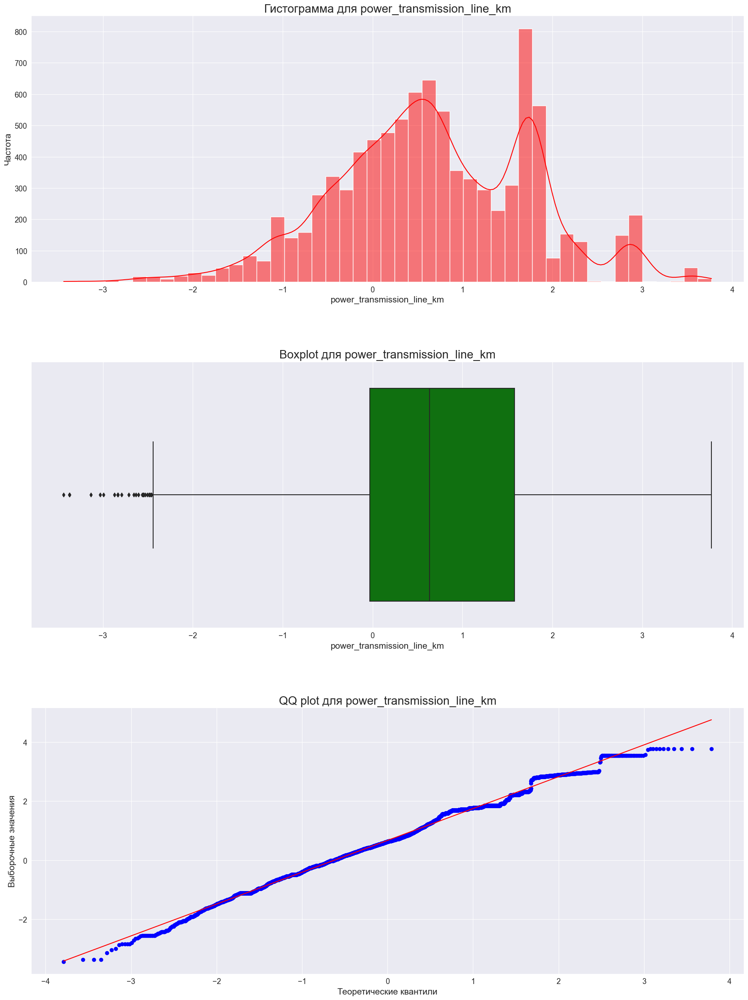


Тест Колмогорова-Смирнова:
Статистика=0.2567, p=0.0000
Отвергаем нулевую гипотезу. Признак power_transmission_line_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        0.671901
std         1.080862
min        -3.435791
25%        -0.032285
50%         0.631117
75%         1.579488
max         3.768715
Name: power_transmission_line_km, dtype: float64


In [118]:
quantitative_feature_analysis_test(df_test, 'power_transmission_line_km')

1. Не нормальное распределение
2. Значения от -3.435791 до 3.768715
3. Медиана равна 0.631117
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 29) market_shop_km

market_shop_km: Расстояние до ближайшего рынка или магазина (в километрах). Тип данных: float64

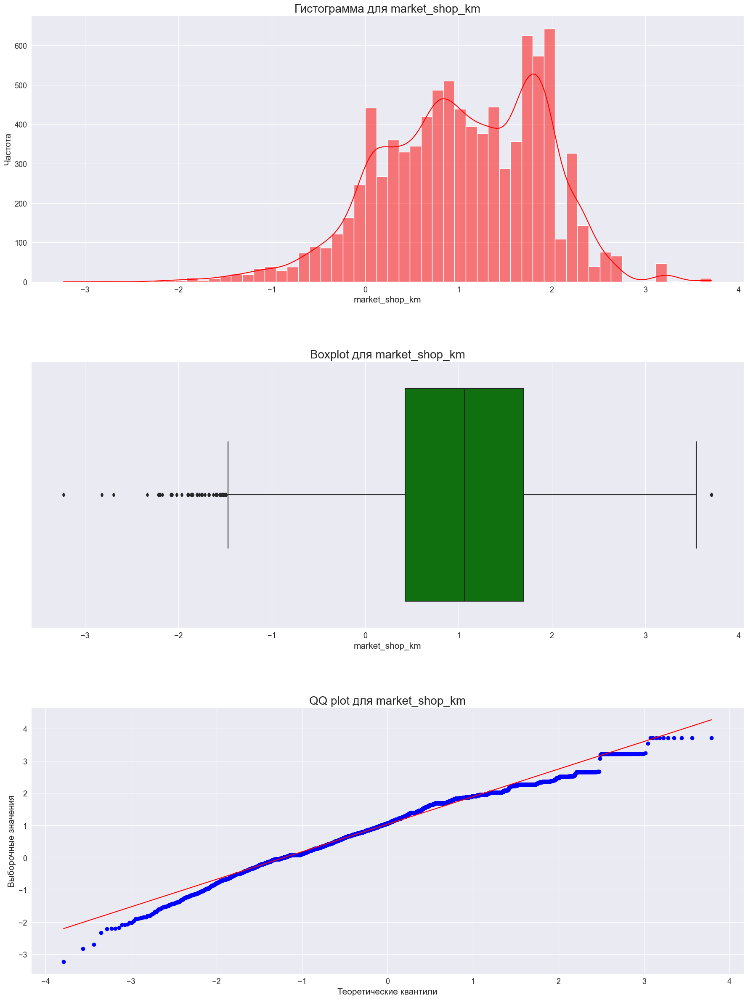


Тест Колмогорова-Смирнова:
Статистика=0.4256, p=0.0000
Отвергаем нулевую гипотезу. Признак market_shop_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.037096
std         0.860877
min        -3.229749
25%         0.427078
50%         1.063362
75%         1.695597
max         3.708131
Name: market_shop_km, dtype: float64


In [119]:
quantitative_feature_analysis_test(df_test, 'market_shop_km')

1. Не нормальное распределение
2. Значения от -3.229749 до 3.708131
3. Медиана равна 1.063362
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 30) fitness_km

fitness_km: Расстояние до ближайшего фитнес-центра (в километрах). Тип данных: float64

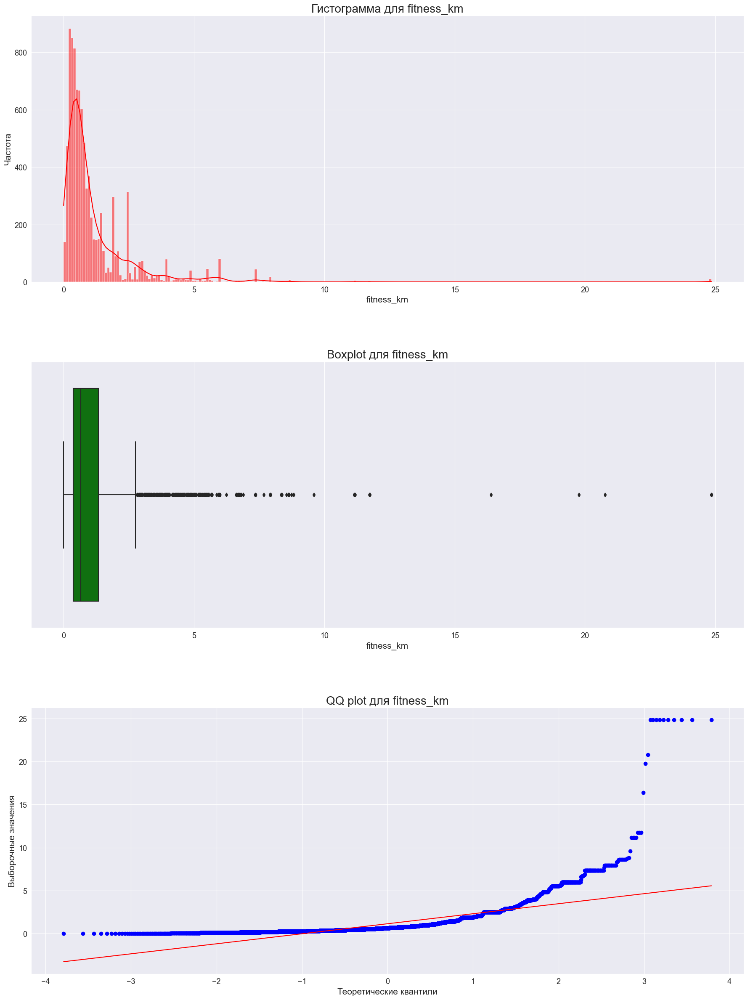


Тест Колмогорова-Смирнова:
Статистика=0.5220, p=0.0000
Отвергаем нулевую гипотезу. Признак fitness_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.152915
std         1.555410
min         0.000000
25%         0.363900
50%         0.659955
75%         1.333944
max        24.852968
Name: fitness_km, dtype: float64


In [120]:
quantitative_feature_analysis_test(df_test, 'fitness_km')

1. Не нормальное распределение
2. Значения от 0 до 24.852968
3. Медиана равна 0.659955
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение

## 31) stadium_km

stadium_km: Расстояние до ближайшего стадиона (в километрах). Тип данных: float64

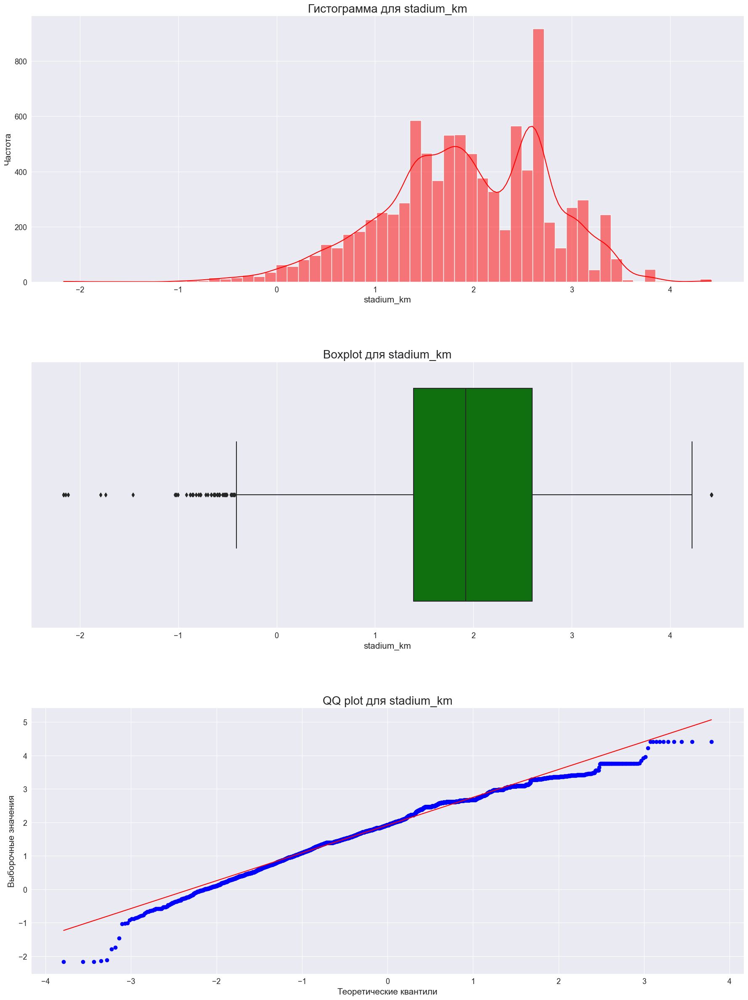


Тест Колмогорова-Смирнова:
Статистика=0.7060, p=0.0000
Отвергаем нулевую гипотезу. Признак stadium_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.920446
std         0.836887
min        -2.165038
25%         1.390835
50%         1.923886
75%         2.597543
max         4.419712
Name: stadium_km, dtype: float64


In [121]:
quantitative_feature_analysis_test(df_test, 'stadium_km')

1. Не нормальное распределение
2. Значения от -2.165038 до 4.419712
3. Медиана равна 1.923886
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 32) basketball_km

basketball_km: Расстояние до ближайшей баскетбольной площадки (в километрах). Тип данных: float64

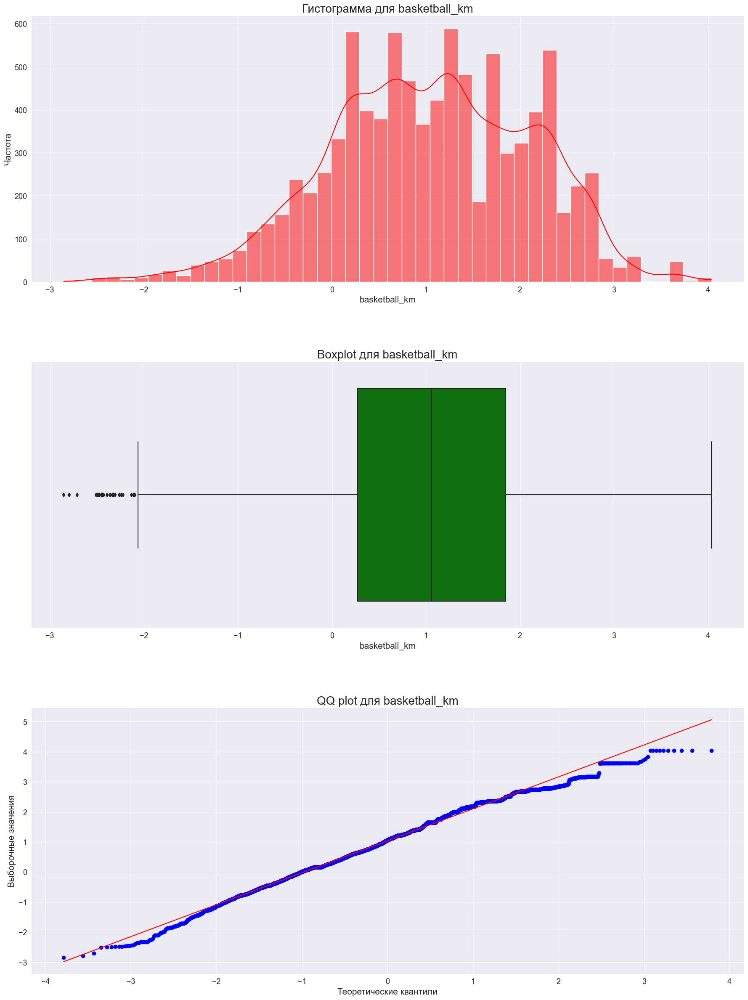


Тест Колмогорова-Смирнова:
Статистика=0.3831, p=0.0000
Отвергаем нулевую гипотезу. Признак basketball_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.037009
std         1.065906
min        -2.853423
25%         0.272724
50%         1.061746
75%         1.850739
max         4.037841
Name: basketball_km, dtype: float64


In [122]:
quantitative_feature_analysis_test(df_test, 'basketball_km')

1. Не нормальное распределение
2. Значения от -2.853423 до 4.037841
3. Медиана равна 1.061746
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 33) detention_facility_km

detention_facility_km: Расстояние до ближайшего исправительного учреждения (в километрах). Тип данных: float64

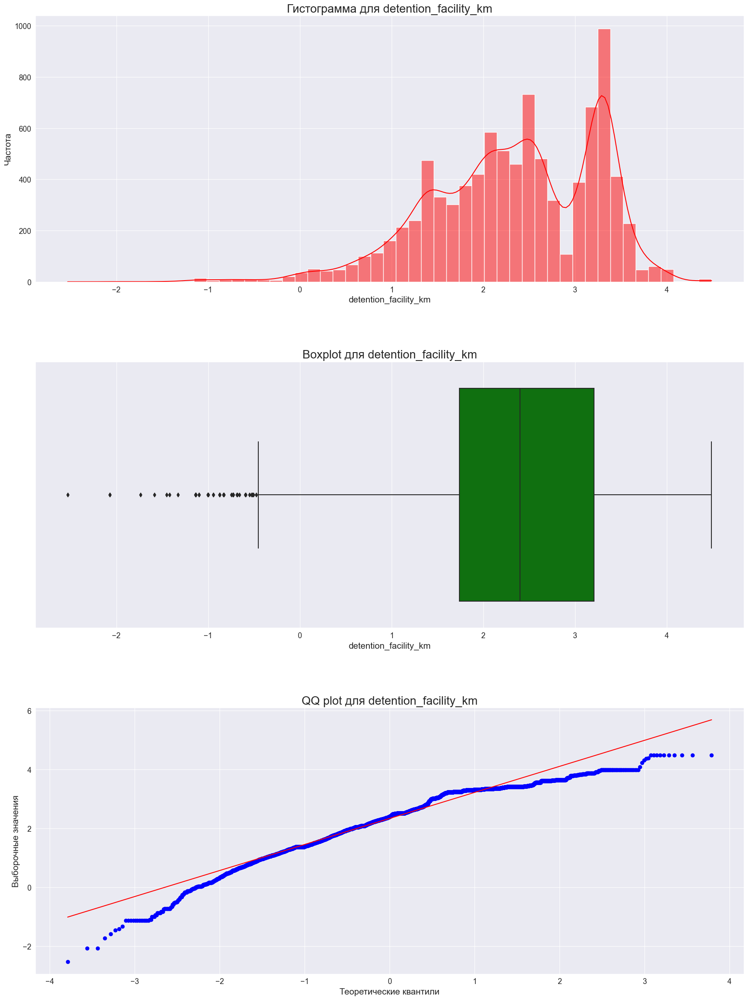


Тест Колмогорова-Смирнова:
Статистика=0.7823, p=0.0000
Отвергаем нулевую гипотезу. Признак detention_facility_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.333736
std         0.900745
min        -2.530981
25%         1.740968
50%         2.399201
75%         3.206561
max         4.489144
Name: detention_facility_km, dtype: float64


In [123]:
quantitative_feature_analysis_test(df_test, 'detention_facility_km')

1. Не нормальное распределение
2. Значения от -2.530981 до 4.489144
3. Медиана равна 2.399201
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 34) additional_education_km

additional_education_km: Расстояние до ближайшего учреждения дополнительного образования (в километрах). Тип данных: float64

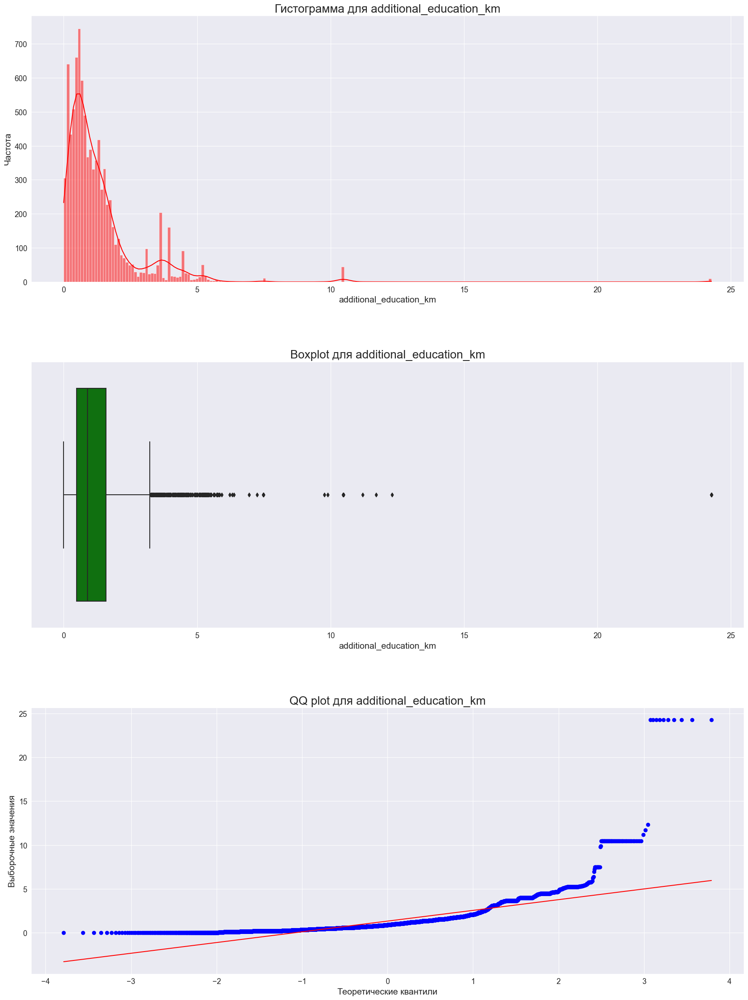


Тест Колмогорова-Смирнова:
Статистика=0.5144, p=0.0000
Отвергаем нулевую гипотезу. Признак additional_education_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.329701
std         1.540400
min         0.000000
25%         0.476777
50%         0.896083
75%         1.579371
max        24.268209
Name: additional_education_km, dtype: float64


In [124]:
quantitative_feature_analysis_test(df_test, 'additional_education_km')

1. Не нормальное распределение
2. Значения от 0 до 24.268209
3. Медиана равна 0.896083
4. Имеются выбросы

Варианты для обработки признака:
1. Заменить 0 на NaN или стастическое значение

## 35) big_church_km

big_church_km: Расстояние до ближайшей крупной церкви (в километрах). Тип данных: float64

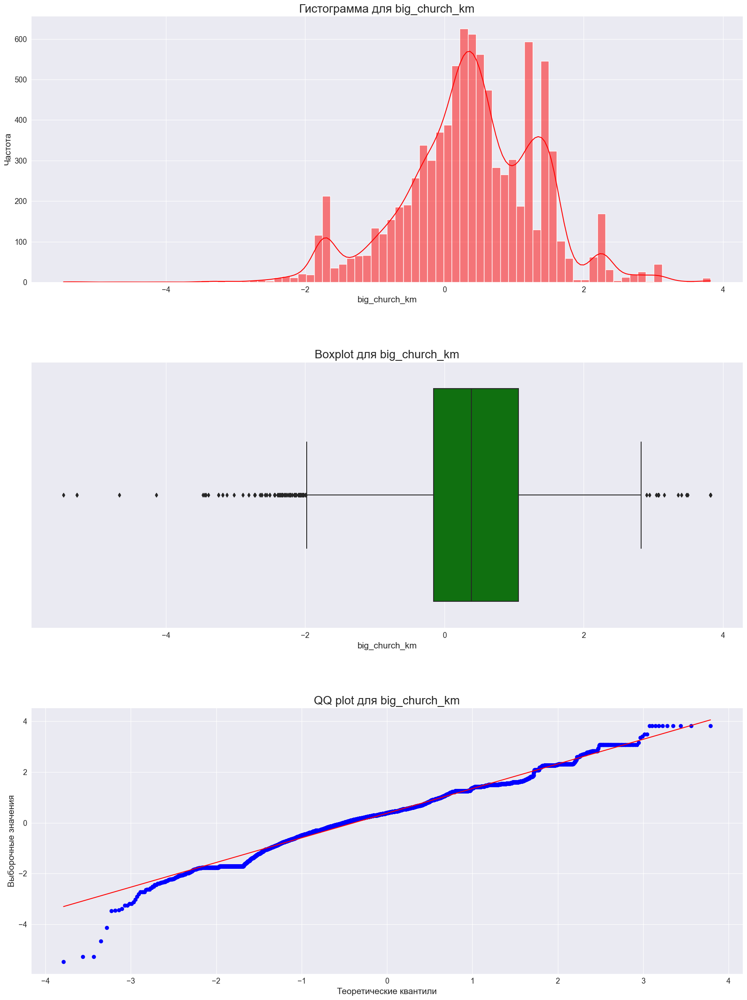


Тест Колмогорова-Смирнова:
Статистика=0.1997, p=0.0000
Отвергаем нулевую гипотезу. Признак big_church_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        0.377145
std         0.977346
min        -5.470734
25%        -0.157206
50%         0.388566
75%         1.062995
max         3.821421
Name: big_church_km, dtype: float64


In [125]:
quantitative_feature_analysis_test(df_test, 'big_church_km')

1. Не нормальное распределение
2. Значения от -5.470734 до 3.821421
3. Медиана равна 0.388566
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 36) mosque_km

mosque_km: Расстояние до ближайшей мечети (в километрах). Тип данных: float64

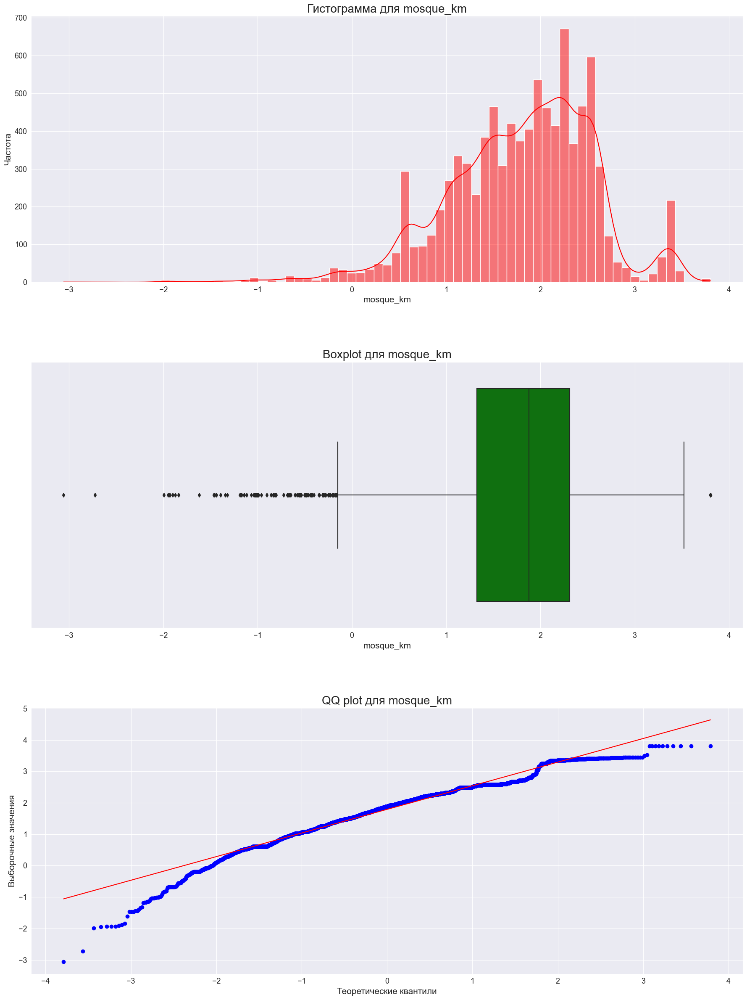


Тест Колмогорова-Смирнова:
Статистика=0.7058, p=0.0000
Отвергаем нулевую гипотезу. Признак mosque_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.789835
std         0.761661
min        -3.057956
25%         1.323402
50%         1.880159
75%         2.308884
max         3.803320
Name: mosque_km, dtype: float64


In [126]:
quantitative_feature_analysis_test(df_test, 'mosque_km')

1. Не нормальное распределение
2. Значения от -3.057956 до 3.803320
3. Медиана равна 1.880159
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 37) theater_km

theater_km: Расстояние до ближайшего театра (в километрах). Тип данных: float64

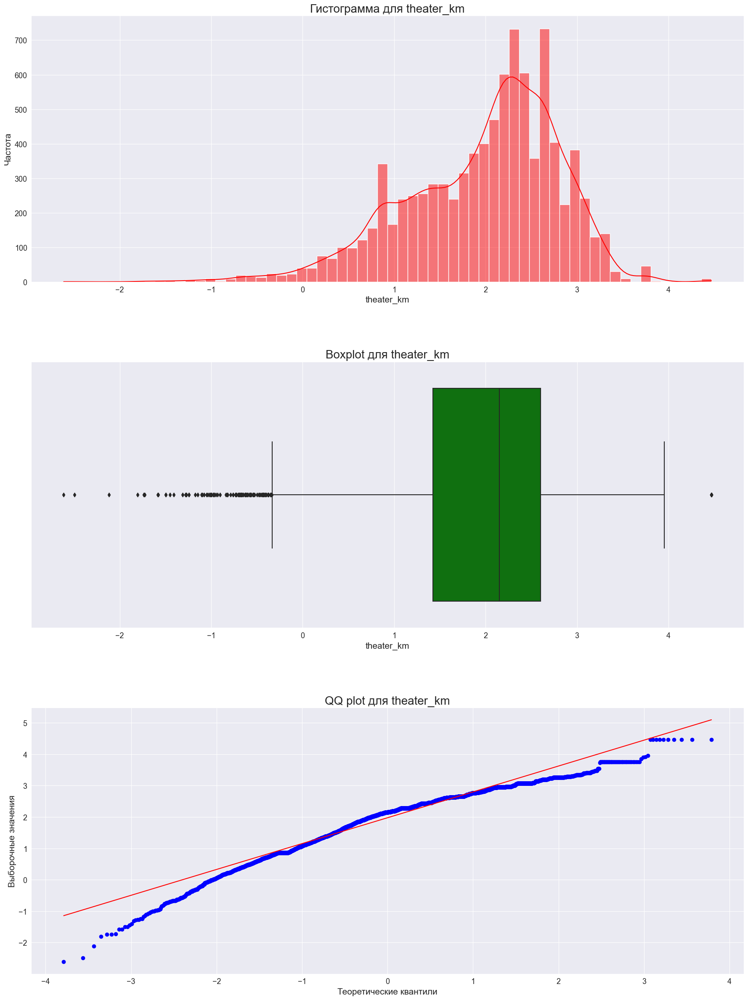


Тест Колмогорова-Смирнова:
Статистика=0.7051, p=0.0000
Отвергаем нулевую гипотезу. Признак theater_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.975764
std         0.840192
min        -2.612337
25%         1.426186
50%         2.153157
75%         2.599692
max         4.469059
Name: theater_km, dtype: float64


In [127]:
quantitative_feature_analysis_test(df_test, 'theater_km')

1. Не нормальное распределение
2. Значения от  -2.612337 до 4.469059
3. Медиана равна 2.153157
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 38) exhibition_km

exhibition_km: Расстояние до ближайшего выставочного центра (в километрах). Тип данных: float64

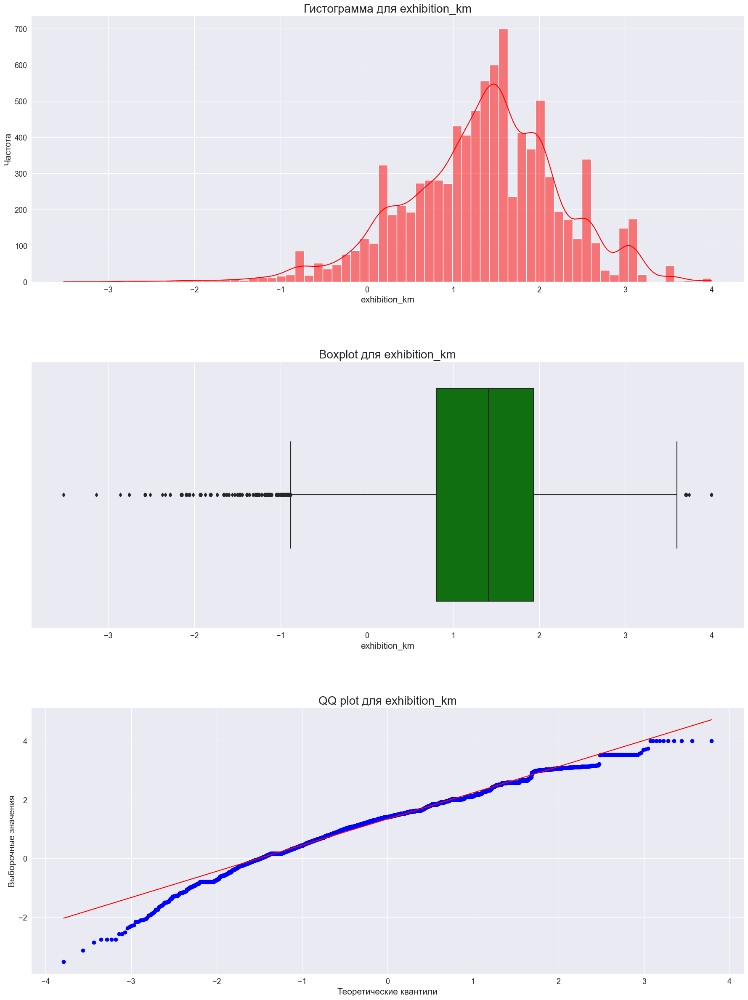


Тест Колмогорова-Смирнова:
Статистика=0.5426, p=0.0000
Отвергаем нулевую гипотезу. Признак exhibition_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        1.340425
std         0.896795
min        -3.515516
25%         0.805452
50%         1.409915
75%         1.930669
max         3.996938
Name: exhibition_km, dtype: float64


In [128]:
quantitative_feature_analysis_test(df_test, 'exhibition_km')

1. Не нормальное распределение
2. Значения от -3.515516 до 3.996938
3. Медиана равна 1.409915
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 39) catering_km

catering_km: Расстояние до ближайшего заведения общественного питания (в километрах). Тип данных: float64

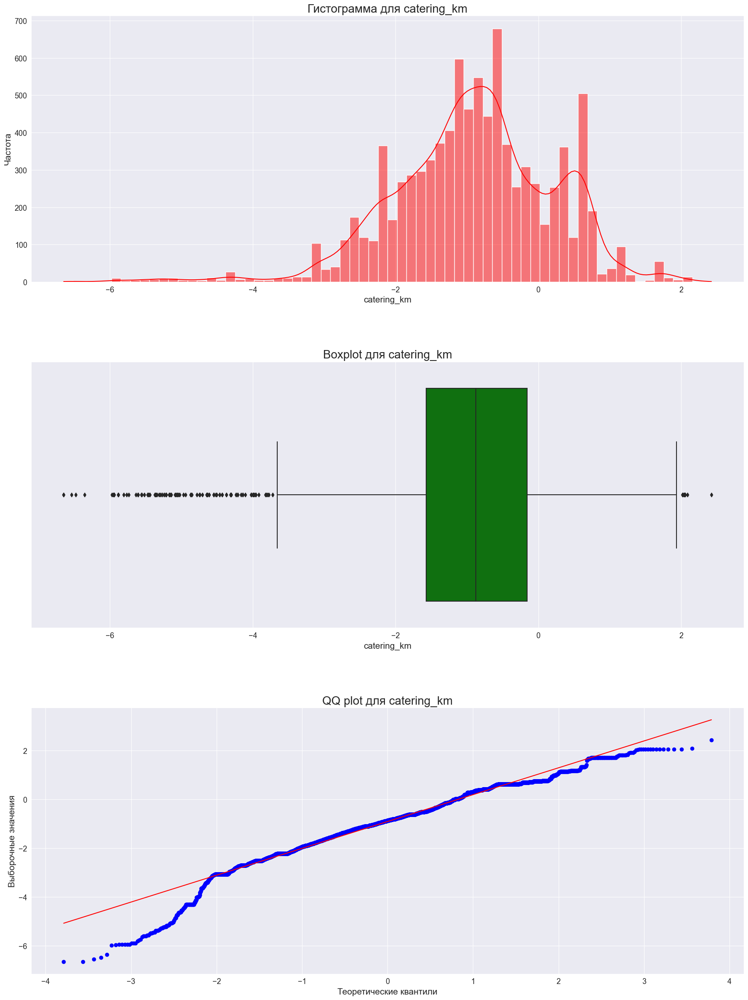


Тест Колмогорова-Смирнова:
Статистика=0.3680, p=0.0000
Отвергаем нулевую гипотезу. Признак catering_km, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean       -0.911360
std         1.112028
min        -6.648267
25%        -1.571365
50%        -0.873183
75%        -0.156077
max         2.424232
Name: catering_km, dtype: float64


In [129]:
quantitative_feature_analysis_test(df_test, 'catering_km')

1. Не нормальное распределение
2. Значения от -6.648267 до 2.424232
3. Медиана равна -0.873183
4. Имеются выбросы
5. Отрицательные значения km, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 40) green_part_1000

green_part_1000: Доля зеленых зон в радиусе 1000 метров. Тип данных: float64

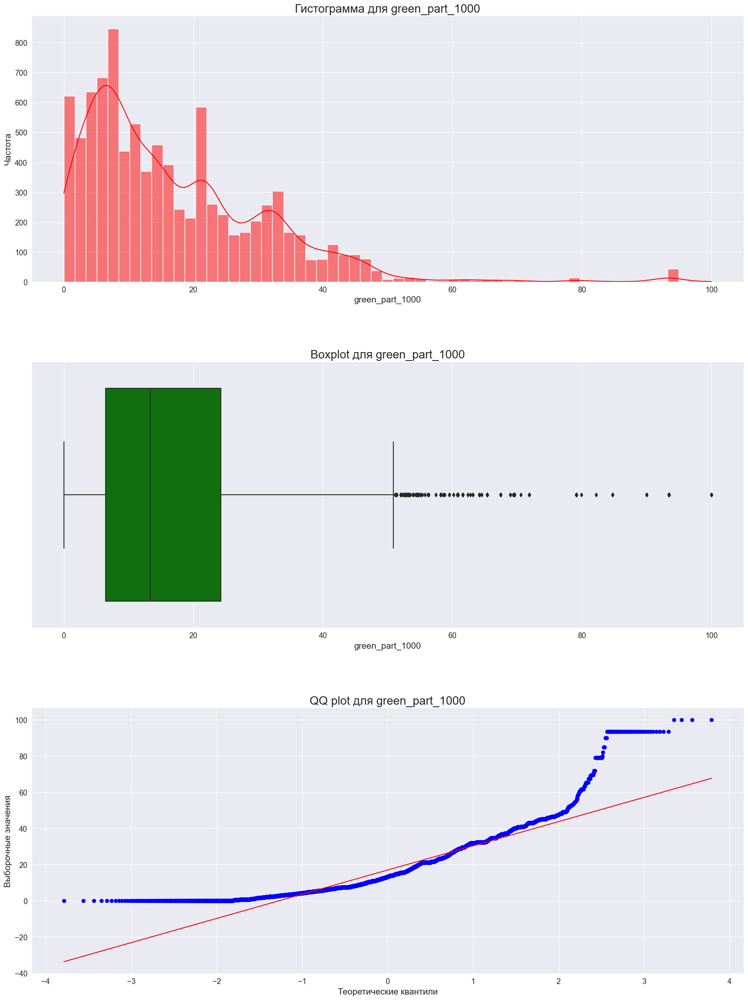


Тест Колмогорова-Смирнова:
Статистика=0.9060, p=0.0000
Отвергаем нулевую гипотезу. Признак green_part_1000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean       17.018579
std        14.298298
min         0.000000
25%         6.450000
50%        13.345000
75%        24.270000
max       100.000000
Name: green_part_1000, dtype: float64


In [130]:
quantitative_feature_analysis_test(df_test, 'green_part_1000')

1. Не нормальное распределение
2. Значения от 0 до 100
3. Медиана равна 13.345000
4. Имеются выбросы

## 41) cafe_sum_1000_min_price_avg

cafe_sum_1000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 1000 метров. Тип данных: float64

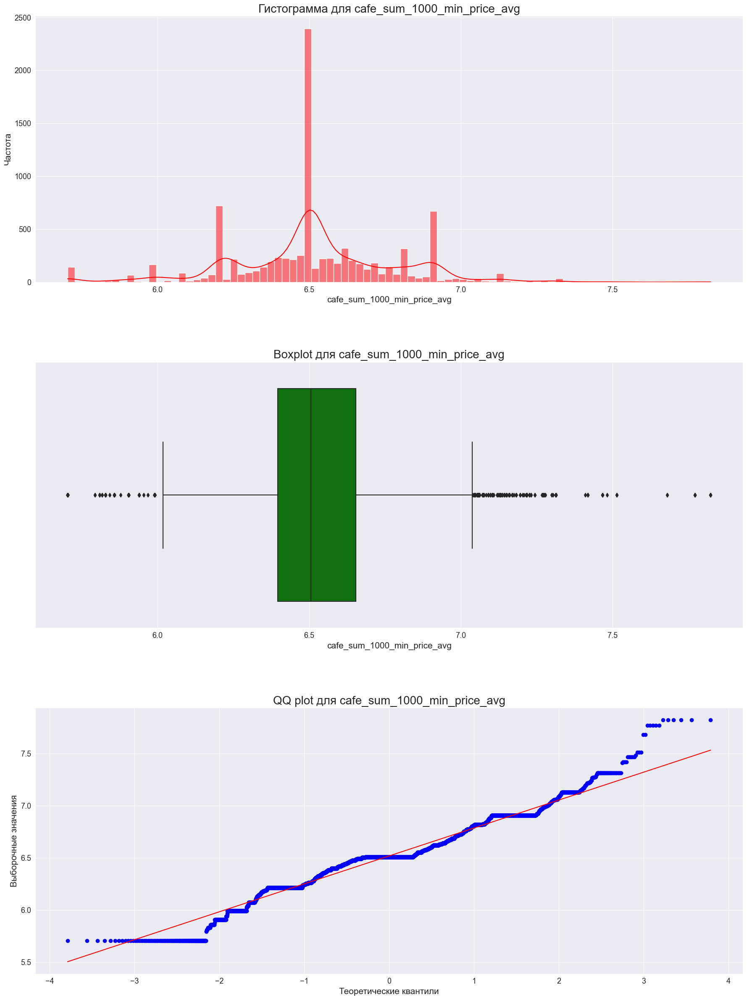


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_sum_1000_min_price_avg, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        6.518372
std         0.273302
min         5.703782
25%         6.396930
50%         6.506128
75%         6.654668
max         7.824046
Name: cafe_sum_1000_min_price_avg, dtype: float64


In [131]:
quantitative_feature_analysis_test(df_test, 'cafe_sum_1000_min_price_avg')

1. Не нормальное распределение
2. Значения от 5.703782 до 7.824046
3. Медиана равна 6.506128
4. Имеются выбросы

## 42) cafe_count_1000_price_high

cafe_count_1000_price_high: Количество дорогих кафе в радиусе 1000 метров. Тип данных: int64

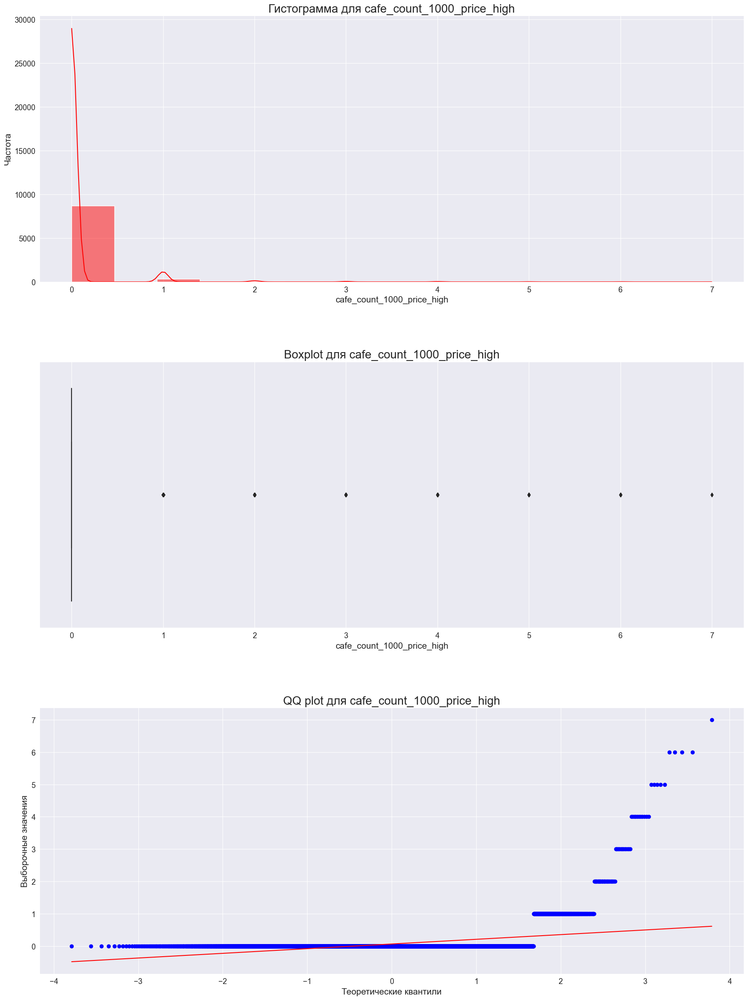


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_count_1000_price_high, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        0.062787
std         0.347520
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         7.000000
Name: cafe_count_1000_price_high, dtype: float64


In [132]:
quantitative_feature_analysis_test(df_test, 'cafe_count_1000_price_high')

1. Не нормальное распределение
2. Значения от 0 до 7
3. Медиана равна 0

## 43) cafe_sum_1500_min_price_avg

cafe_sum_1500_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 1500 метров. Тип данных: float64

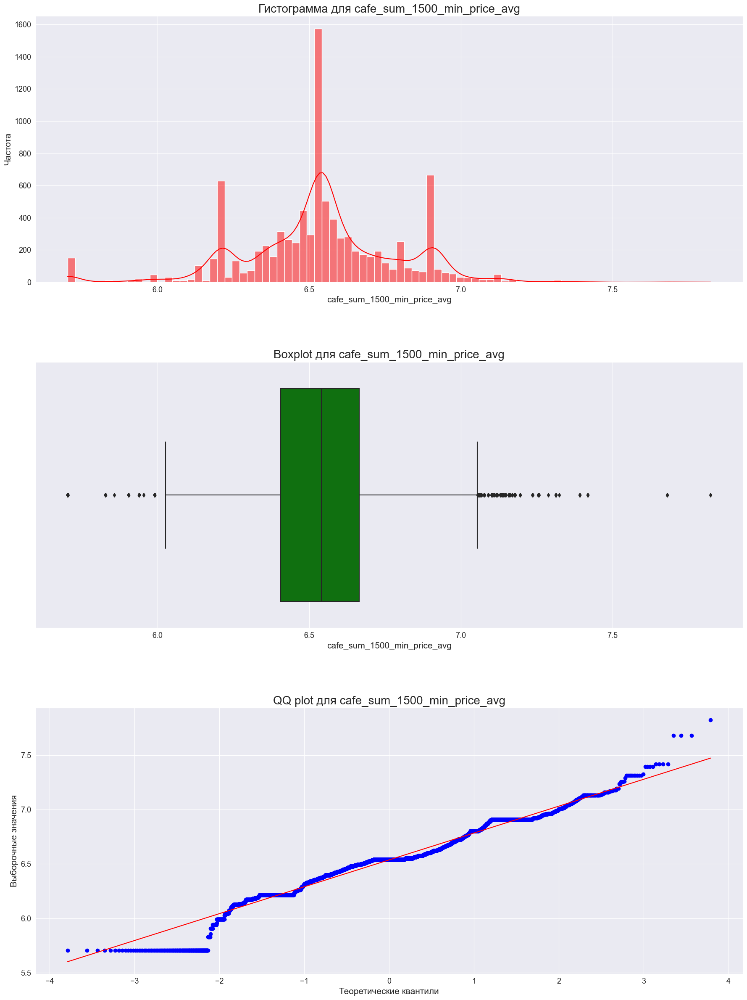


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_sum_1500_min_price_avg, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        6.537077
std         0.251676
min         5.703782
25%         6.406471
50%         6.540034
75%         6.665789
max         7.824046
Name: cafe_sum_1500_min_price_avg, dtype: float64


In [133]:
quantitative_feature_analysis_test(df_test, 'cafe_sum_1500_min_price_avg')

1. Не нормальное распределение
2. Значения от 5.703782 до 7.824046
3. Медиана равна 6.540034
4. Имеются выбросы

## 44) green_part_2000

green_part_2000: Доля зеленых зон в радиусе 2000 метров. Тип данных: float64

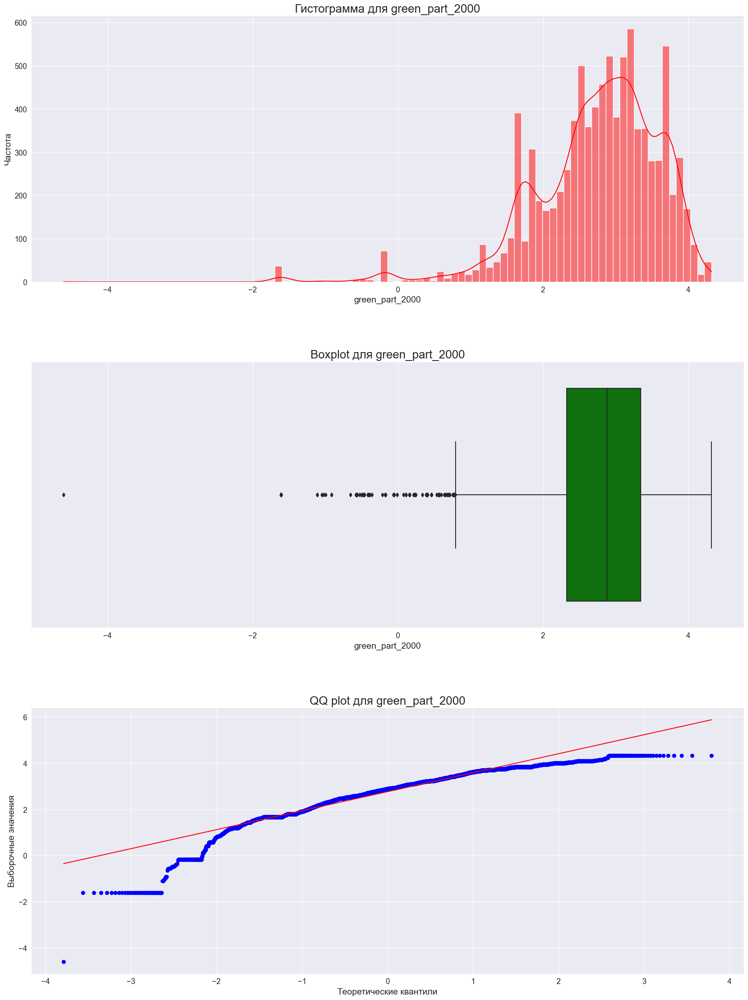


Тест Колмогорова-Смирнова:
Статистика=0.8786, p=0.0000
Отвергаем нулевую гипотезу. Признак green_part_2000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.760833
std         0.854895
min        -4.605170
25%         2.326302
50%         2.880882
75%         3.345685
max         4.321480
Name: green_part_2000, dtype: float64


In [134]:
quantitative_feature_analysis_test(df_test, 'green_part_2000')

1. Не нормальное распределение
2. Значения от -4.605170 до 4.321480
3. Медиана равна 2.880882
4. Имеются выбросы
5. Отрицательные значения, что очень странно

Варианты для обработки признака:
1. Заменить 0 и меньше на NaN или стастическое значение

## 45) cafe_sum_2000_min_price_avg

cafe_sum_2000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 2000 метров. Тип данных: float64

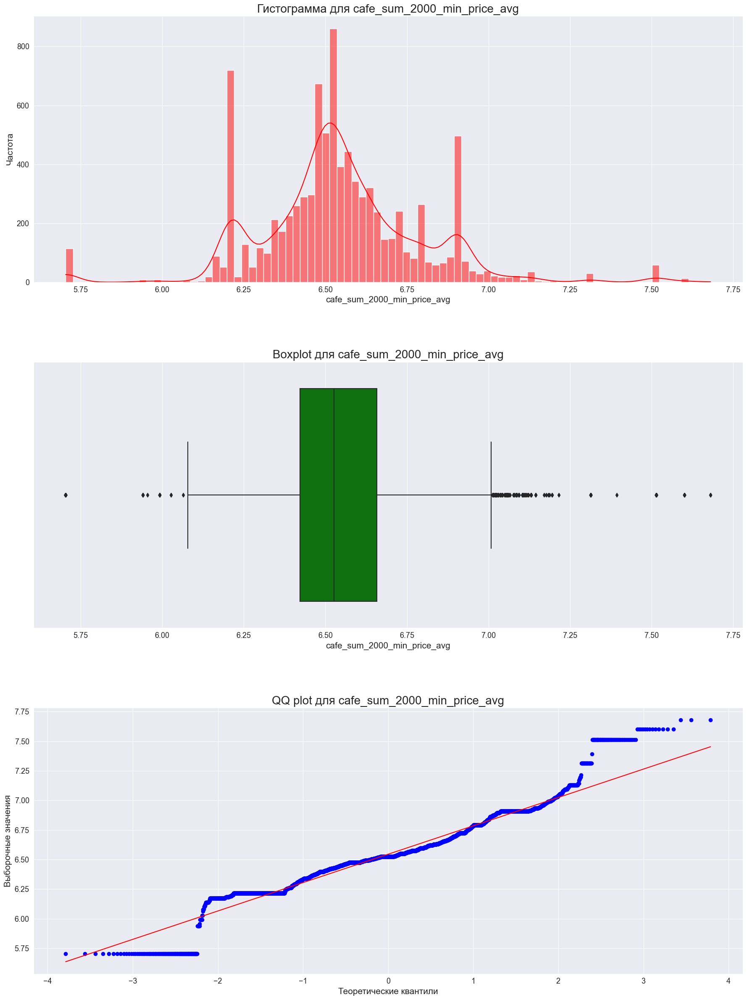


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_sum_2000_min_price_avg, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        6.545409
std         0.246064
min         5.703782
25%         6.422240
50%         6.526978
75%         6.657947
max         7.680947
Name: cafe_sum_2000_min_price_avg, dtype: float64


In [135]:
quantitative_feature_analysis_test(df_test, 'cafe_sum_2000_min_price_avg')

1. Не нормальное распределение
2. Значения от 5.703782 до 7.680947
3. Медиана равна 6.526978
4. Имеются выбросы

## 46) mosque_count_3000

mosque_count_3000: Количество мечетей в радиусе 3000 метров. Тип данных: int64

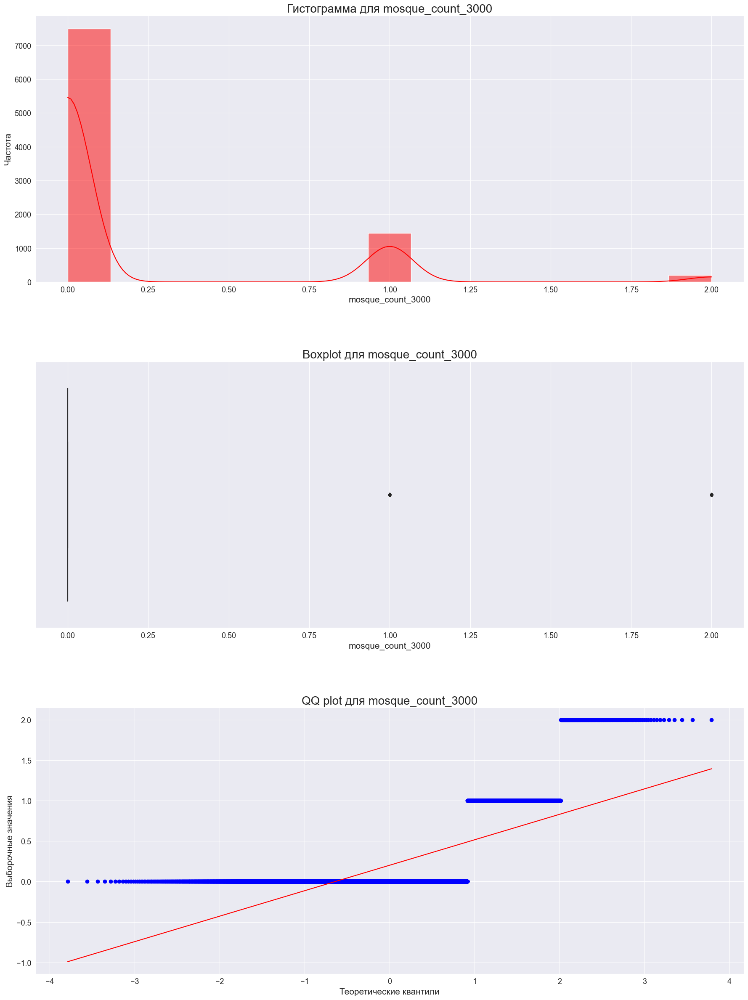


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак mosque_count_3000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        0.201816
std         0.452859
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         2.000000
Name: mosque_count_3000, dtype: float64


In [136]:
quantitative_feature_analysis_test(df_test, 'mosque_count_3000')

1. Не нормальное распределение
2. Значения от 0 до 2
3. Медиана равна 0

## 47) prom_part_5000

prom_part_5000: Промышленная часть в радиусе 5000 метров. Тип данных: float64

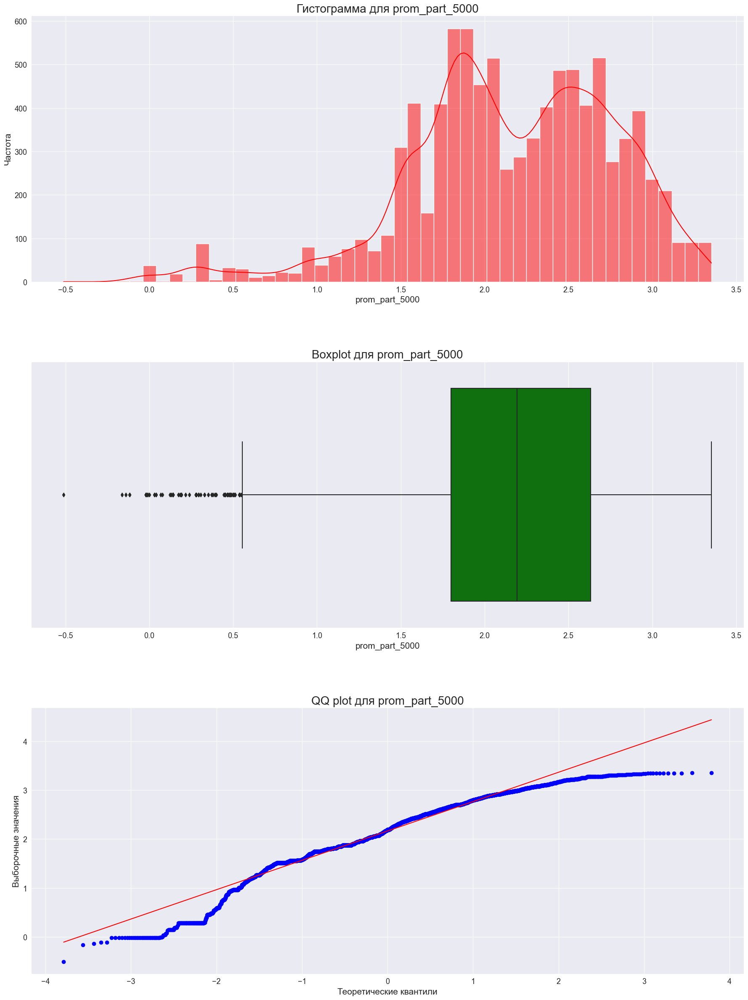


Тест Колмогорова-Смирнова:
Статистика=0.8412, p=0.0000
Отвергаем нулевую гипотезу. Признак prom_part_5000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        2.166007
std         0.611189
min        -0.510826
25%         1.800058
50%         2.192770
75%         2.633147
max         3.352007
Name: prom_part_5000, dtype: float64


In [137]:
quantitative_feature_analysis_test(df_test, 'prom_part_5000')

1. Не нормальное распределение
2. Значения от -0.510826 до 3.352007
3. Медиана равна 2.335101
4. Имеются выбросы
5. Отрицательные значения, что очень странно

Варианты для обработки признака:
1. Заменить значения меньше 0 на NaN или стастическое значение

## 48) cafe_sum_5000_min_price_avg

cafe_sum_5000_min_price_avg: Средняя минимальная цена блюд в кафе в радиусе 5000 метров. Тип данных: float64

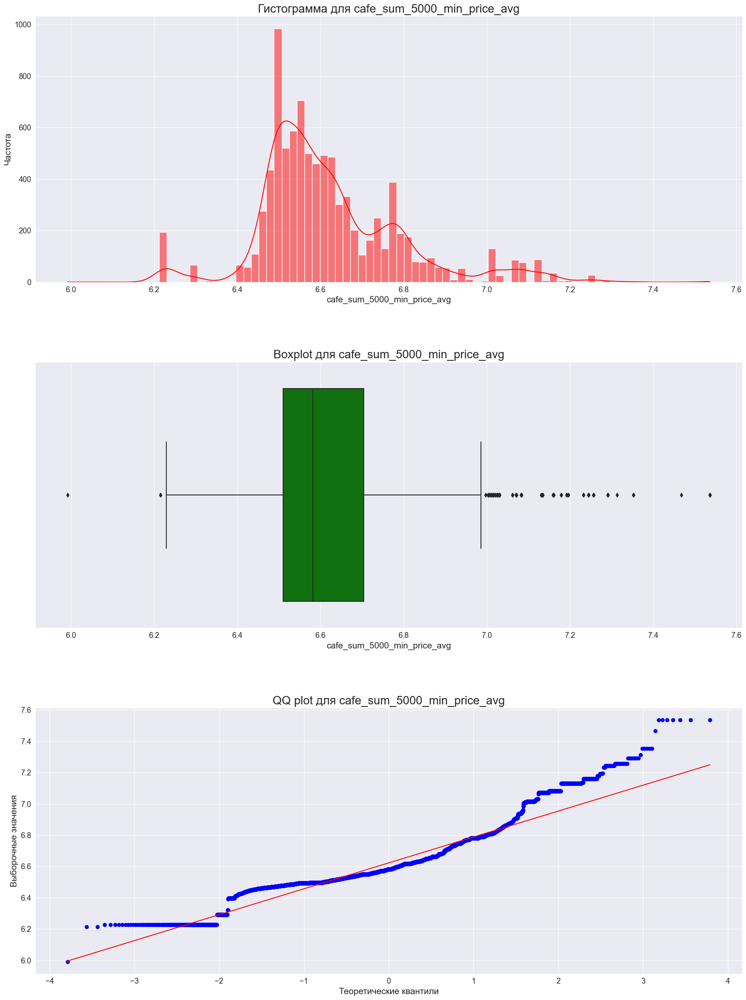


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак cafe_sum_5000_min_price_avg, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        6.622857
std         0.173457
min         5.991465
25%         6.510020
50%         6.581665
75%         6.703654
max         7.536364
Name: cafe_sum_5000_min_price_avg, dtype: float64


In [138]:
quantitative_feature_analysis_test(df_test, 'cafe_sum_5000_min_price_avg')

1. Не нормальное распределение
2. Значения от 5.991465 до 7.536364
3. Медиана равна 6.581665
4. Имеются выбросы

## 49) mosque_count_5000

mosque_count_5000: Количество мечетей в радиусе 5000 метров. Тип данных: int64

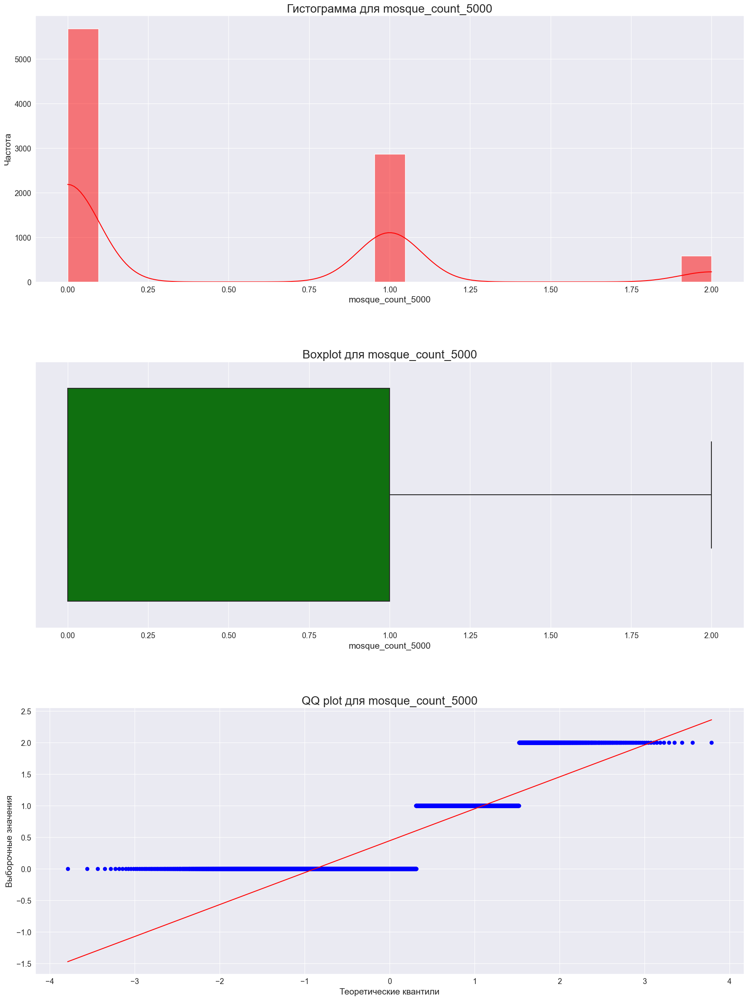


Тест Колмогорова-Смирнова:
Статистика=0.5000, p=0.0000
Отвергаем нулевую гипотезу. Признак mosque_count_5000, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean        0.442245
std         0.612295
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         2.000000
Name: mosque_count_5000, dtype: float64


In [139]:
quantitative_feature_analysis_test(df_test, 'mosque_count_5000')

1. Не нормальное распределение
2. Значения от 0 до 2
3. Медиана равна 0

## 50) year

year: Год данных. Тип данных: int64

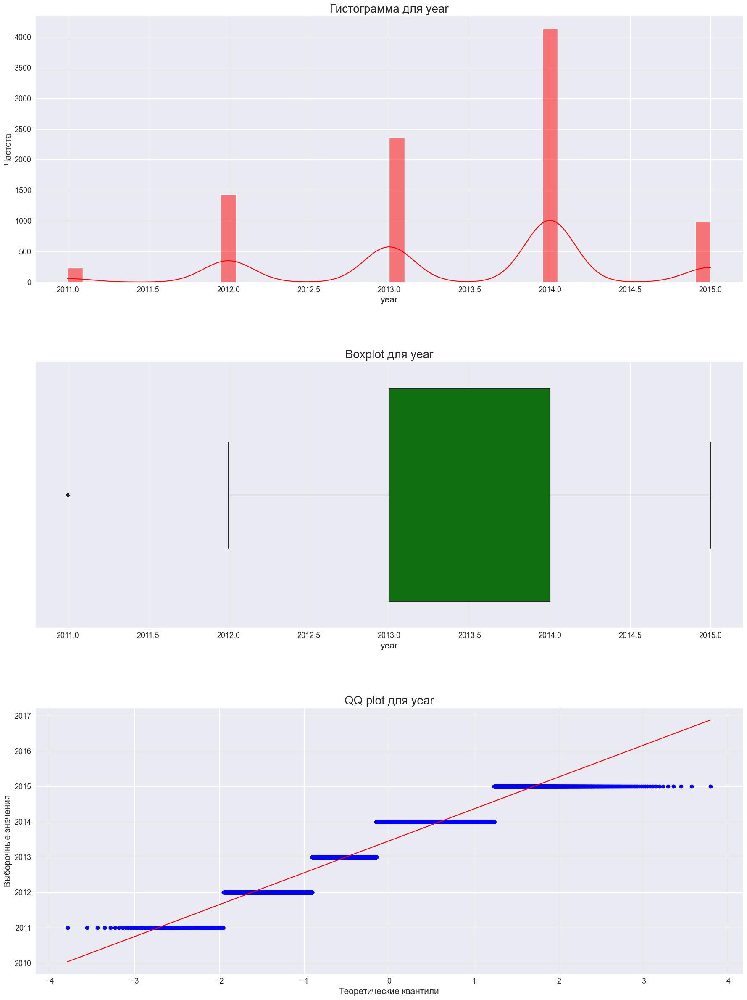


Тест Колмогорова-Смирнова:
Статистика=1.0000, p=0.0000
Отвергаем нулевую гипотезу. Признак year, вероятно, НЕ ИМЕЕТ нормальное распределение.

Описательная статистика:
count    9142.000000
mean     2013.460512
std         0.964485
min      2011.000000
25%      2013.000000
50%      2014.000000
75%      2014.000000
max      2015.000000
Name: year, dtype: float64


In [140]:
quantitative_feature_analysis_test(df_test, 'year')

1. Не нормальное распределение
2. Значения от 2011 до 2015
3. Медиана равна 2014

## Взаимосвязь признаков

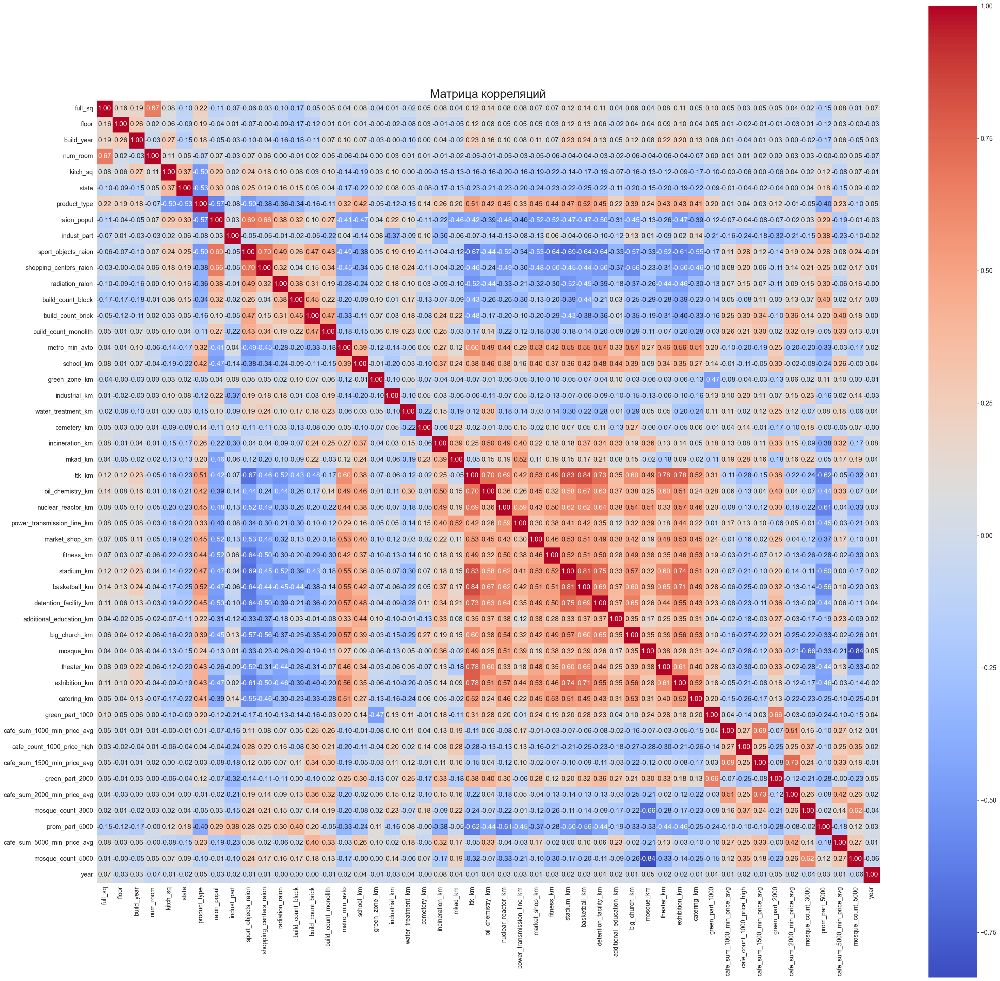

In [146]:
df_corr_test = df_test.drop(columns='ID_railroad_station_avto')
plt.figure(figsize=(36, 36))
sns.heatmap(df_corr_test.corr(method='spearman'), annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True)
plt.title('Матрица корреляций', fontsize='xx-large')
plt.show()

Из тепловой карты видно, что присутствует линейная мультиколлениарность.

In [24]:
# Посчитаем VIF между данными
vif_df_test= df_test.copy()
vif_df_test = vif_df_test.dropna()
vif_df_test = vif_df_test.drop(columns=['ID_railroad_station_avto', 'product_type', 'radiation_raion'], axis=1)
X = vif_df_test.assign(const=1)
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["features"] = X.columns
vif

,VIF Factor,features
0,1.547570e+00,full_sq
1,1.119257e+00,floor
2,1.088992e+00,build_year
3,1.471899e+00,num_room
4,1.008106e+00,kitch_sq
5,1.250879e+00,state
6,5.068281e+00,raion_popul
7,1.721584e+00,indust_part
8,7.222770e+00,sport_objects_raion
9,3.987527e+00,shopping_centers_raion


Из результатов VIF, можно сказать, что у нас нет прям сильной нелинейной мультиколлениарной зависимотси в данных.

# Выводы, что можно сделать с тестовыми данными

1. Заменить все записи, где значение 1 или 0 у full_sq на NaN или стастическое значение
2. Заменить все записи, где значение 0 у floor, num_room, metro_min_avto  на NaN или стастическое значение
3. Заменить значения < 1147 и > 2024 у build_year  на NaN или стастическое значение
4. Заменить значения больше 500 у kitch_sq на NaN или стастическое значение
5. Оставить выбросы или заменить на NaN или статистическим значением у indust_part, sport_objects_raion, shopping_centers_raion, build_count_block, build_count_brick, build_count_monolith, metro_min_avto, school_km, green_zone_km, cemetery_km, fitness_km, additional_education_km, cafe_sum_1000_min_price_avg, cafe_sum_1500_min_price_avg, cafe_sum_2000_min_price_avg, cafe_sum_5000_min_price_avg
6. Заменить 0 и меньше на NaN или стастическое значение или взять модуль у water_treatment_km, incineration_km, mkad_km, ttk_km, oil_chemistry_km, nuclear_reactor_km, power_transmission_line_km, market_shop_km, stadium_km, basketball_km, detention_facility_km, big_church_km, mosque_km, exhibition_km, catering_km, green_part_2000, prom_part_5000
7. Заменить у ID_railroad_station_avto, где 0 на NaN, статистическим значением, удалить записи
8. Оставить какой-то один признак из : cafe_sum_1000_min_price_avg, cafe_sum_1500_min_price_avg, cafe_sum_2000_min_price_avg, cafe_sum_5000_min_price_avg
9. Оставить какой-то один признак из: green_part_100, который измеряется от 0 до 100; или green_part_2000, который измеряется приблизительно от -4 до 4
10. Убрать признак cemetery_km полностью из датасета
11. Непонятна ситуация с build_year и year: как год постройки может быть больше, год сбора данных. Возможно стоить удалить year
12. Сделать state катеогриальным признаком
13. Дупликаты есть как в тестовых данных, так и в тренировочных данных. Поэтому дупликаты нужно попробовать оставить или удалить.

# Особенности тестовых данных

1. build_year имеет не только значения прошлого (0, 1..), но и будущего (4965)
2. Значение kitch_sq больше full_sq
3. Значения бинарных признаков +- также распределены как в трейне в %
4. Значения, присутствующие в тестовом наборе, но отсутствующие в обучающем наборе по ID_railroad_station_avto: 4.890349128221754, 4.844187086458591, 4.867534450455582

# Сравнение тренировочных и тестовых данных

Посмотрим описательную статистику в тренировочных и тестовых данных.

In [155]:
df_train.describe()

,full_sq,floor,build_year,num_room,kitch_sq,state,raion_popul,indust_part,sport_objects_raion,shopping_centers_raion,...,cafe_count_1000_price_high,cafe_sum_1500_min_price_avg,green_part_2000,cafe_sum_2000_min_price_avg,mosque_count_3000,prom_part_5000,cafe_sum_5000_min_price_avg,mosque_count_5000,year,price_doc
count,21329.000000,21329.000000,2.132900e+04,21329.000000,21329.000000,21329.000000,21329.000000,21329.000000,21329.000000,21329.000000,...,21329.000000,21329.000000,21329.000000,21329.000000,21329.000000,21329.000000,21329.000000,21329.000000,21329.000000,2.132900e+04
mean,54.088799,7.660509,2.864657e+03,1.938300,6.292184,2.061606,10.899731,0.119305,6.581884,4.171832,...,0.059028,6.535018,2.749243,6.545043,0.197900,2.170806,6.622740,0.442496,2013.449388,7.117599e+06
std,42.559522,5.319822,1.372879e+05,0.710045,23.847677,0.667929,1.151518,0.119186,6.514278,4.730773,...,0.325858,0.252222,0.870977,0.244766,0.445642,0.619349,0.177794,0.607982,0.961555,4.706342e+06
min,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000,7.842279,0.000000,0.000000,0.000000,...,0.000000,5.703782,-4.605170,5.703782,0.000000,-1.560648,5.703782,0.000000,2011.000000,1.000000e+05
25%,38.000000,3.000000,1.976000e+03,2.000000,5.000000,2.000000,9.990536,0.019509,1.000000,1.000000,...,0.000000,6.402862,2.314514,6.422240,0.000000,1.801710,6.509022,0.000000,2013.000000,4.745995e+06
50%,49.000000,6.500000,1.979000e+03,2.000000,6.000000,2.000000,11.332626,0.072158,5.000000,3.000000,...,0.000000,6.540034,2.865054,6.526978,0.000000,2.195000,6.581665,0.000000,2014.000000,6.255454e+06
75%,63.000000,11.000000,1.983000e+03,2.000000,8.000000,2.000000,11.718817,0.195781,10.000000,6.000000,...,0.000000,6.668863,3.341447,6.659294,0.000000,2.636912,6.703654,1.000000,2014.000000,8.300000e+06
max,5326.000000,77.000000,2.005201e+07,19.000000,2013.000000,33.000000,12.419041,0.521867,29.000000,23.000000,...,6.000000,7.824046,4.321480,7.680947,2.000000,3.352007,7.536364,2.000000,2015.000000,8.077744e+07


In [149]:
df_test.describe()

,full_sq,floor,build_year,num_room,kitch_sq,state,raion_popul,indust_part,sport_objects_raion,shopping_centers_raion,...,cafe_sum_1000_min_price_avg,cafe_count_1000_price_high,cafe_sum_1500_min_price_avg,green_part_2000,cafe_sum_2000_min_price_avg,mosque_count_3000,prom_part_5000,cafe_sum_5000_min_price_avg,mosque_count_5000,year
count,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,...,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000,9142.000000
mean,54.507001,7.673430,1921.884380,1.937760,6.231131,2.054255,10.916803,0.117859,6.759024,4.268978,...,6.518372,0.062787,6.537077,2.760833,6.545409,0.201816,2.166007,6.622857,0.442245,2013.460512
std,24.392465,5.274204,343.774812,0.698787,22.355353,0.633725,1.143172,0.117517,6.703401,4.767033,...,0.273302,0.347520,0.251676,0.854895,0.246064,0.452859,0.611189,0.173457,0.612295,0.964485
min,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,7.842279,0.000000,0.000000,0.000000,...,5.703782,0.000000,5.703782,-4.605170,5.703782,0.000000,-0.510826,5.991465,0.000000,2011.000000
25%,39.000000,3.000000,1975.000000,1.000000,5.000000,2.000000,9.990536,0.017647,1.000000,1.000000,...,6.396930,0.000000,6.406471,2.326302,6.422240,0.000000,1.800058,6.510020,0.000000,2013.000000
50%,50.000000,6.500000,1979.000000,2.000000,6.000000,2.000000,11.336713,0.072158,5.000000,3.000000,...,6.506128,0.000000,6.540034,2.880882,6.526978,0.000000,2.192770,6.581665,0.000000,2014.000000
75%,63.000000,11.000000,1983.000000,2.000000,8.000000,2.000000,11.719940,0.194489,10.000000,6.000000,...,6.654668,0.000000,6.665789,3.345685,6.657947,0.000000,2.633147,6.703654,1.000000,2014.000000
max,637.000000,34.000000,4965.000000,9.000000,2014.000000,4.000000,12.419041,0.521867,29.000000,23.000000,...,7.824046,7.000000,7.824046,4.321480,7.680947,2.000000,3.352007,7.536364,2.000000,2015.000000


Описательная статистика у данных +- похожа.

Проверим равенство средних с помощью теста Манна-Уитни, так как данные у нас распределены не нормально, выборки у нас 2 и они независимые.

In [153]:
df_train_without_price = df_train.drop(['price_doc'], axis=1)
common_columns = list(set(df_train_without_price.columns).intersection(set(df_test.columns)))

for column in common_columns:
    if df_train_without_price[column].dtype in ['int64', 'float64'] and df_test[column].dtype in ['int64', 'float64']:
        stat, p = mannwhitneyu(df_train_without_price[column], df_test[column])
        if p < 0.05:
            print(f'Столбец: {column}, p-значение: {p}. Гипотеза о равенстве средних ОТВЕРГАЕТСЯ.')
        else:
            print(f'Столбец: {column}, p-значение: {p}. Гипотеза о равенстве средних НЕ отвергается.')
    else:
        print(f'Столбец: {column} не является числовым.')

Столбец: market_shop_km, p-значение: 0.4461242319177847. Гипотеза о равенстве средних НЕ отвергается.
Столбец: green_zone_km, p-значение: 0.09890283547957358. Гипотеза о равенстве средних НЕ отвергается.
Столбец: industrial_km, p-значение: 0.996021597572742. Гипотеза о равенстве средних НЕ отвергается.
Столбец: catering_km, p-значение: 0.6577431997459118. Гипотеза о равенстве средних НЕ отвергается.
Столбец: school_km, p-значение: 0.09953985667782628. Гипотеза о равенстве средних НЕ отвергается.
Столбец: prom_part_5000, p-значение: 0.2798138307405119. Гипотеза о равенстве средних НЕ отвергается.
Столбец: nuclear_reactor_km, p-значение: 0.8395831161978133. Гипотеза о равенстве средних НЕ отвергается.
Столбец: water_treatment_km, p-значение: 0.8843372045102359. Гипотеза о равенстве средних НЕ отвергается.
Столбец: cafe_count_1000_price_high, p-значение: 0.3378206964151723. Гипотеза о равенстве средних НЕ отвергается.
Столбец: big_church_km, p-значение: 0.38985555241495573. Гипотеза о рав

Гипотеза о равенстве средних ОТВЕРГАЕТСЯ только для shopping_centers_raion. В остальных случаях она принимается.

## Вывод после сравнения выборок

Данные +- похожи, поэтому стоит попробовать переобучить модель, чтобы улучшить метрику.

# Общий вывод после анализа

После анализа даных, мы выявили следующие главные моменты:
1. В данных присутствуют пропуски, которые замаскированы либо 0, либо каким-то статистическим занчением.
2. В даных присутствуют дубликаты, причём при одинаковых значениях факторных признаков получается иногда разный таргет.
3. Возможно некоторые признаки были отскейлены, а именно признаки связанные к километрами.
4. Странные значения таргета, а именно, что квартиру в Москве или в этой области продавали за сумму меньше 3.5М, ибо поискав в интернете, мы нашли, что самая дешёвая квартира в 2011 году продавалась именно за 3.5М или в районе этого. Ссылки на источники данных: (https://www.urbanus.ru/news/2011-12-29/8912); (https://www.dp.ru/a/2011/07/04/Rijeltori_vijasnili_gde_i). 
5. Во многих признаках присутствуют очевидные выбросы (по типу у build_year значения 20052009 и 4965).
6. Распределение факторов +- одинаковое.